# Qunomon利用チュートリアル

## 1.はじめに
 * 本チュートリアルでは「住宅の特徴を入力し、住宅の価格を推定するタスク」を題材に、Qunomonを用いてデータセット・モデル等の品質評価を行う事例を紹介します。
 * 本チュートリアルでは、[機械学習品質マネジメントリファレンスガイド](https://www.digiarc.aist.go.jp/publication/aiqm/aiqm-referenceguide-v1.2-jp.pdf)の第1.2版 10章の内容を参考にしています。
   * あくまで参考です。お手元で実際にチュートリアルを試していただけるよう、制約の弱いデータセットを対象としており、課題の細部は異なります。
   * テストベッドの使用シーンをわかりやすくつかんでいただけるよう、評価順序なども変わっております。

## 1.1.目次

 * 1.はじめに
   * 1.1.目次
   * 1.2.シナリオの概要
 * 第一部 Qunomonを用いて機械学習コンポーネントの評価
   * 2.チュートリアル用の資材準備
   * 3.Qunomonを用いた評価
     * 3.1.Qunomonのダウンロード・インストールとQunomonの起動
     * 3.2.AITのインストール
     * 3.3.機械学習コンポーネント（Inventory）の登録
     * 3.4.テスト仕様（Test Description）の登録
     * 3.5.評価の実行と結果確認
   * 4.品質評価を踏まえた拡張後の訓練データの評価
     * 4.1.拡張後のデータの評価
   * 5.品質評価を踏まえたモデルの評価
     * 5.1.モデルの精度
     * 5.2.モデルのロバスト性
     * 5.3.品質レポート作成
 * 第二部 機械学習コンポーネントの準備方法
   * 6.データセットの準備
     * 6.1.データセットの配置
     * 6.2 データセットのダウンロードと加工方法
     * 6.3.データセットの確認
     * 6.4.データ拡張
   * 7.推論モデルの準備
     * 7.1.モデルの構築
     * 7.2. データセットの読み込み
     * 7.3.モデルの訓練
     * 7.4.モデルの検証
   * 8.データ拡張をしたデータを使用した推論モデルの準備

## 1.2.シナリオの概要

#### 1.2.1.シナリオの流れ

本シナリオでは住宅の特徴を入力とし、対象の住宅価格を予測するタスクを機械学習を使って解く過程を通じてAITの使用方法を理解してもらうことそして、Qunomon（機械学習品質テストベッド）の使用方法や効果を理解してもらうことを目指します。

以降、本ノートブックでは、まず与えられたデータセット・モデルに対する一般的なQunomon使用方法を学習してもらう目的で以下のことについて解説します。
 * チュートリアル資材・データセットの準備
 * Qunomonのインストール
 * AITHubからQunomonへのAIT（テストパッケージ）の導入
 * 評価の実行
 * 評価レポートの閲覧

より具体的な内容に踏み込みたい読者に向けて、実際のデータセット・モデルの準備を伴う実行可能なチュートリアルとして、以下のことを解説します。
 * データセット準備（保存・加工）
 * モデルの構築
 * モデルの訓練

その後、データセットやモデルの加工がQunomon上での評価にどう影響するかを確認してもらいます。

#### 1.2.2.シナリオの目的

本シナリオはモデルの精度を落とさずにデータセットを改善することを目指します。
Qunomonを使用して深層学習の分類モデルやデータセットの評価を行い、その結果をもとにデータセットの改善を行います。    
具体的には、モデルの精度（機械学習モデルの正確性）、モデルの敵対的データに対するロバスト性（機械学習モデルの安定性）、データの特徴量の分布の偏り（データセットの均一性）を評価・分析します。評価結果をもとに、訓練データに対してデータ拡張を行い、データ拡張を行った訓練データを使用して新たなモデルの構築を行います。その後、再度Qunomonで評価を行い、モデルの性能（精度）が維持できていることを確認します。    

本シナリオで、モデルとデータセットの評価に使用するAITは以下の3つです。


| AIT名 | 概要 | 選択理由 |
|------------------------|----------------------|----------------------|
| alyz_dataset_topcoverage_auc | データセットにおけるデータの特徴量の分布から均等に分布しているかを評価する。 | 特定の特徴量が偏っていないかを評価できるため。 |
| eval_model_regression_rmse_and_mae | モデルの精度を測定する。 | モデルの性能（RMSE、MAE）を確認することができるため。 |
| eval_model_adversarial_robustness | 入力データに敵対的摂動を加えた敵対的データに対するロバスト性を評価する。 | モデルが敵対的データに対して弱いかを確認できるため。 |

Qunomonを活用して、下記の通りデータの改善を行うことができます。

| データ拡張前のデータとそのデータで訓練したモデルの評価 | データ拡張後のデータとそのデータで訓練したモデルの評価 |
|------------------------|----------------------|
|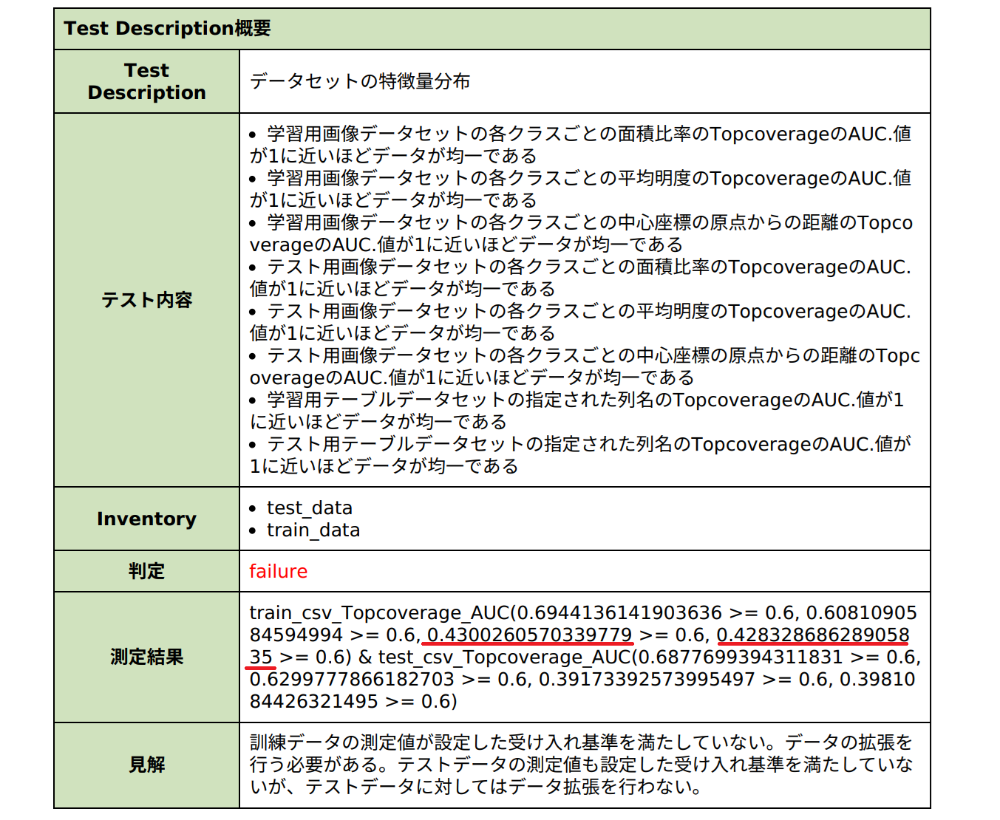|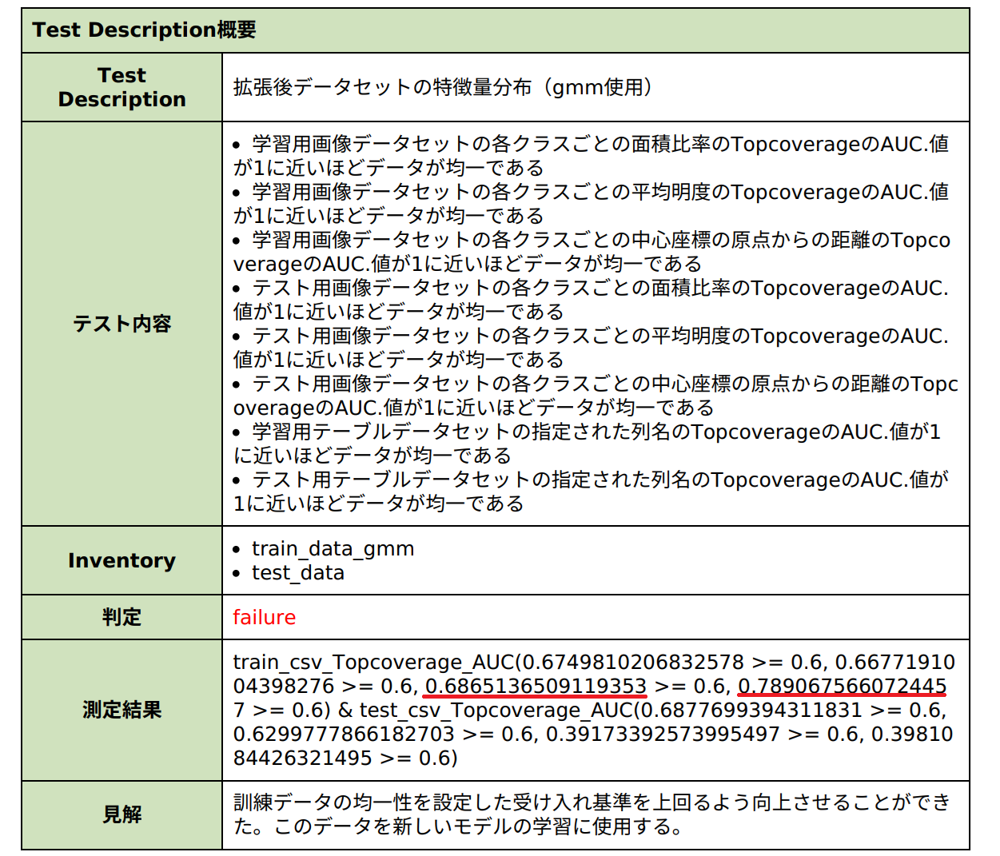|
|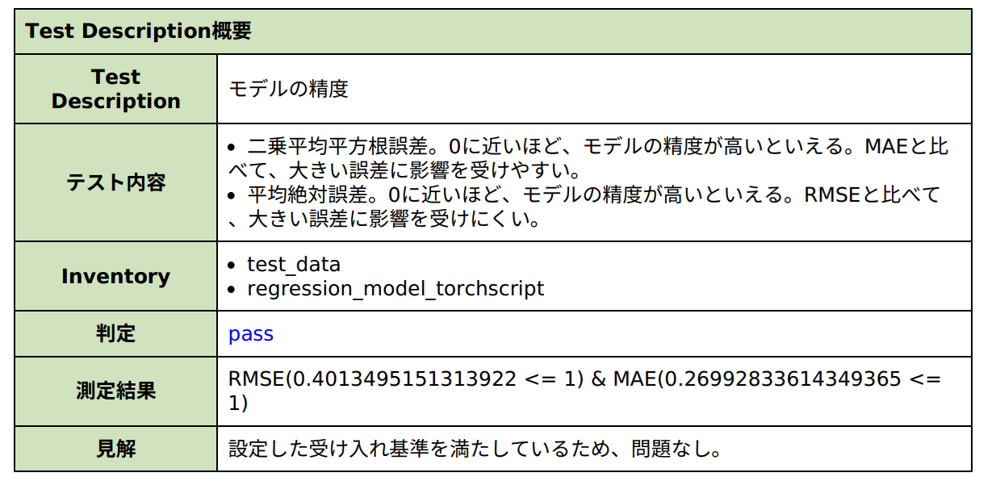|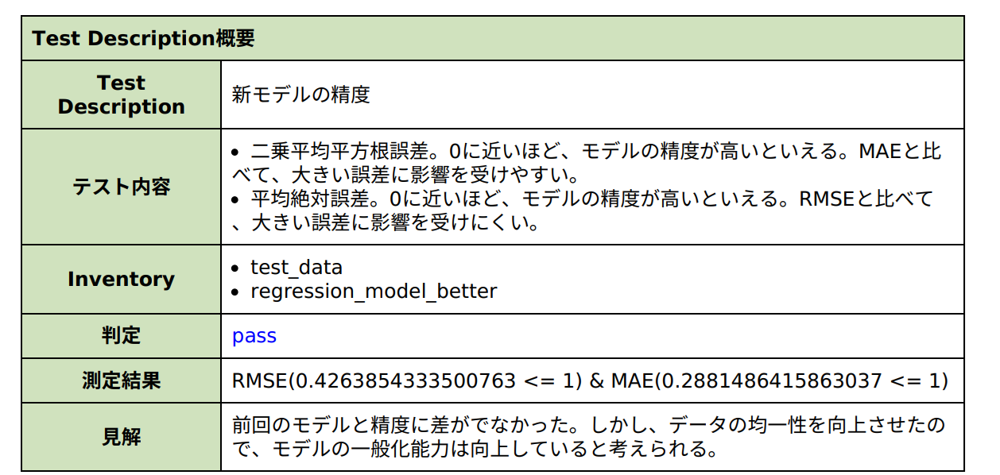|


--------------------------------------------------------------------------------
# 第一部 Qunomonを用いた機械学習コンポーネントの評価
--------------------------------------------------------------------------------

## 2.チュートリアル用の資材準備
 * チュートリアル用資材をまとめた圧縮ファイルは[こちら](https://github.com/aistairc/Qunomon_tutorial_house_price/archive/refs/heads/main.zip)からダウンロードできます。
 * Qunomon本体は[こちら](https://github.com/aistairc/qunomon/archive/refs/heads/main.zip)からダウンロードできます。

#### 2.1.ディレクトリ構成
チュートリアル用資材のzipファイルを解凍すると、下記のディレクトリ構造でデータが保存されています。
```Markdown
- best_practice_3/
  - notebooks/
    - notebook.ipynb `(このノートブック)`
  - resources/
  - poetry.lock
  - pyproject.toml
  - requirements.txt
```
 
本ノートブックの実行に必要な依存関係はpoetryで管理しています。 下記のようにpoetryをインストールし、ディレクトリ直下に.venvを生成するか、もしくはrequirements.txtを用いて好みの方法で依存関係のインストールを行ってください。
```bash
cd best_practice_3
pip install poetry
poetry config virtualenv.in-project True
poetry install
```

## 3.Qunomonを用いた評価

ここからは、準備したデータセットと、シナリオにあわせて訓練されたモデル（4.3.で配布します）をQunomonに登録し、評価結果を確認するまでの流れを解説します。 Qunomonは産業総合技術研究所が開発した機械学習コンポーネントの品質評価テストベッド（プラットフォーム）です。 オープンソースのWebアプリケーションとして開発され、Dockerを用いて構成管理が行われているため、誰でもインターネット上からダウンロードして機械学習コンポーネントの品質評価を行えます。

Qunomonは前述の通りWebアプリケーションですので、本章（特にアプリ起動以降）では、いわゆる説明書のように画面のスクリーンショットを提示しながら解説を行います。 読者の皆様は本資料を参考にしながらお手持ちのマシン上での実行をお試しください。

### 3.1.Qunomonのダウンロード・インストールとQunomonの起動
[Qunomonユーザーズ・ガイド(Qunomonのダウンロード)](https://github.com/aistairc/qunomon/blob/main/qunomon/doc/USER_MANUAL/doc_jp/01_Introduction/01_Introduction.md)を参考に、Qunomonのダウンロード・インストールを行ってください。    
また、インストール後のQunomonの起動についても、[Qunomonユーザーズ・ガイド(Qunomonの起動)](https://github.com/aistairc/qunomon/blob/main/qunomon/doc/USER_MANUAL/doc_jp/01_Introduction/01_Introduction.md)を参照してください。   

### 3.2.AITのインストール
次に、本シナリオの機械学習コンポーネント（モデルとデータセット）の評価を行うAITをインストールします。

AITは実行可能な評価手法パッケージとなっています。AITのインストール方法には、(1)産総研の運営するAIT Hubからダウンロードする方法と、(2)ローカルで開発あるいは第三者が提供しているAITをローカル環境から登録する方法があります。

本シナリオでは以降、(1)の手順を説明します。

【手順1】まずはAIT Hubとローカル環境の連携設定を行います。左ペインより「Setting」を押下し、設定画面へ移動してください。
続いて、AIT HubはGitHubアカウントを用いてユーザ認証を行いますので、AIT-HUB loginボタンを押下します。

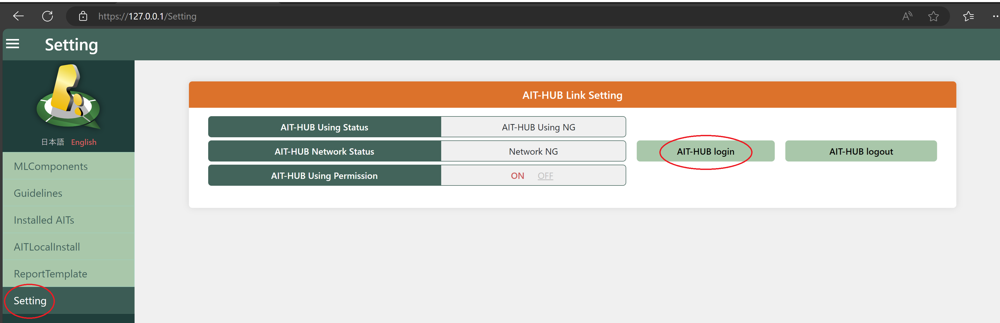

【手順2】認証画面からAITHub利用規約を確認し、<AITHub利用規約>同意しましたにチェックを入れて、GitHubアカウントでログインを実施します。

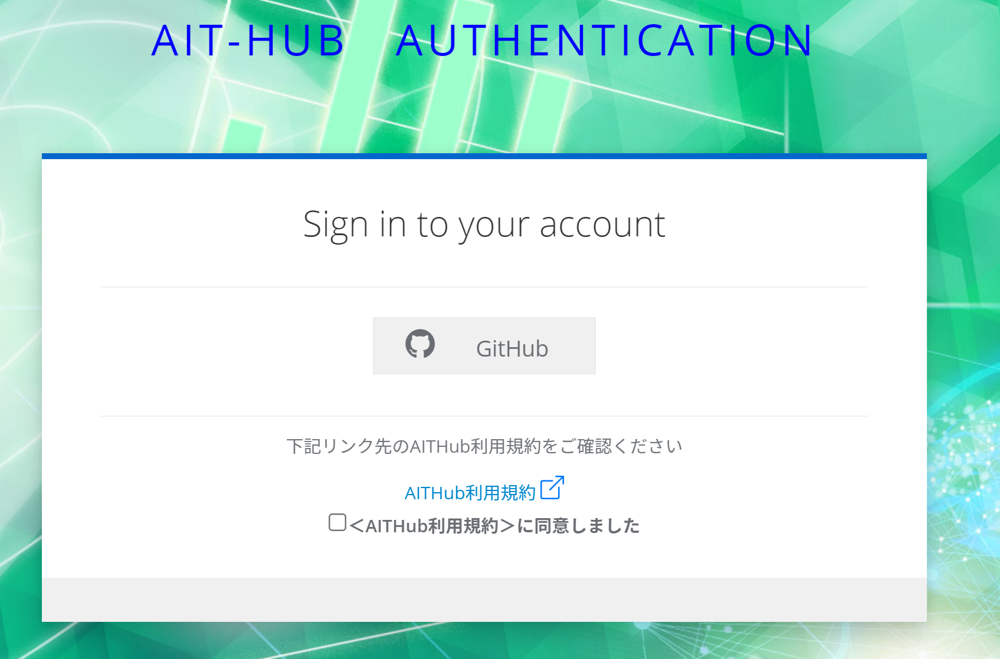    
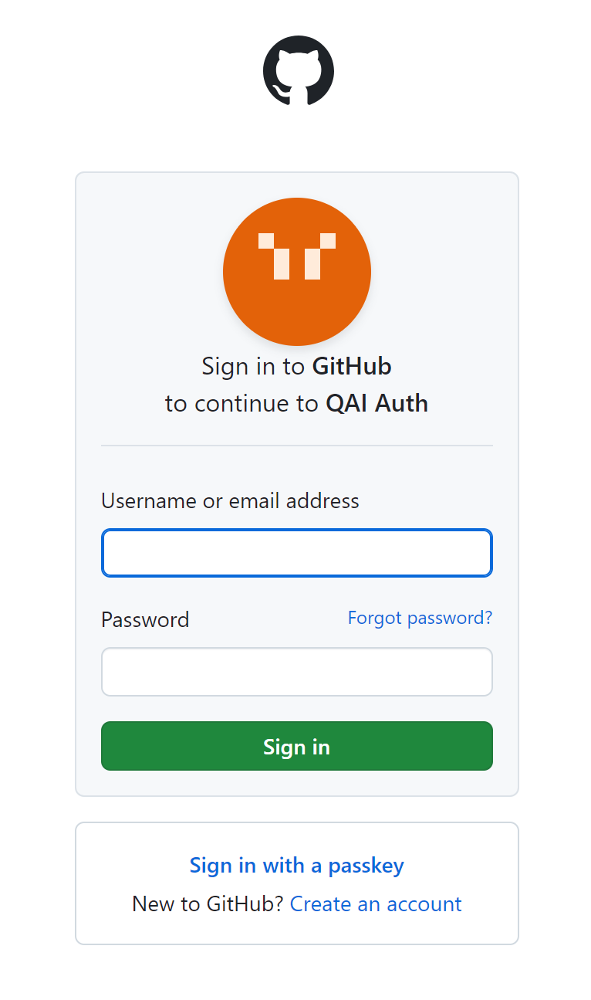

【手順3】設定画面に戻り、AIT HubからのAITインストールを許可してください。

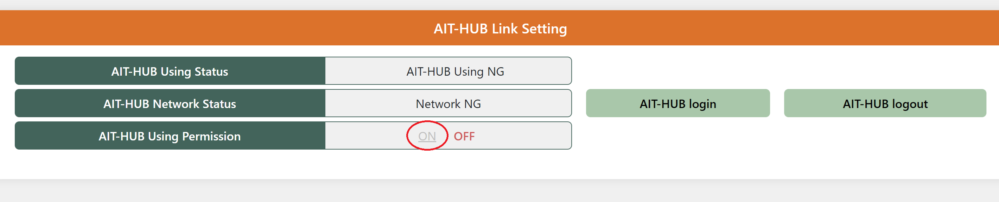

【手順4】連携が完了すると、    
AIT-HUB Using Status : AIT-HUB Using OK    
AIT-HUB Network Status : Network OK    
に変わります。

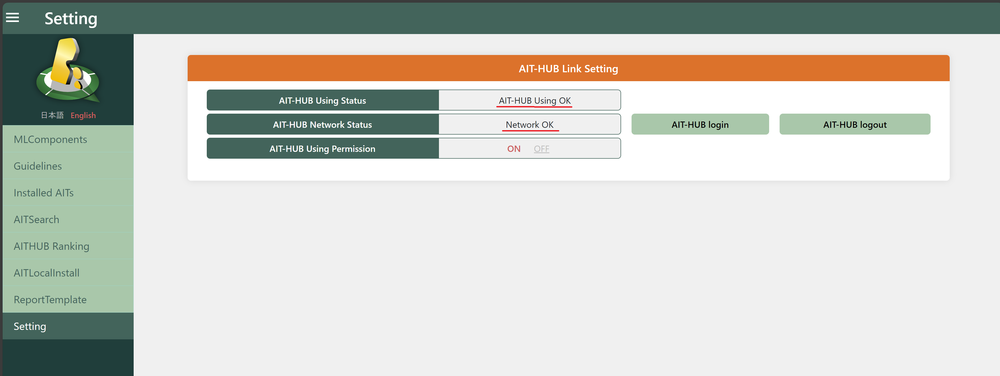



【手順5】今回はAIT Search機能を使います。
インストールするAITは、評価対象とデータ形式が一致する必要があります。
Qunomonでは"インベントリ"がデータの受け皿となり、AITとインベントリ内のデータの相互運用性を管理します。
今回は、Torchscript形式の画像分類モデルを評価しますので、検索画面に下記を入力し、Searchボタンを押下してください。    
Search Category: キーワード(keywords)    
Search Keyword: regression

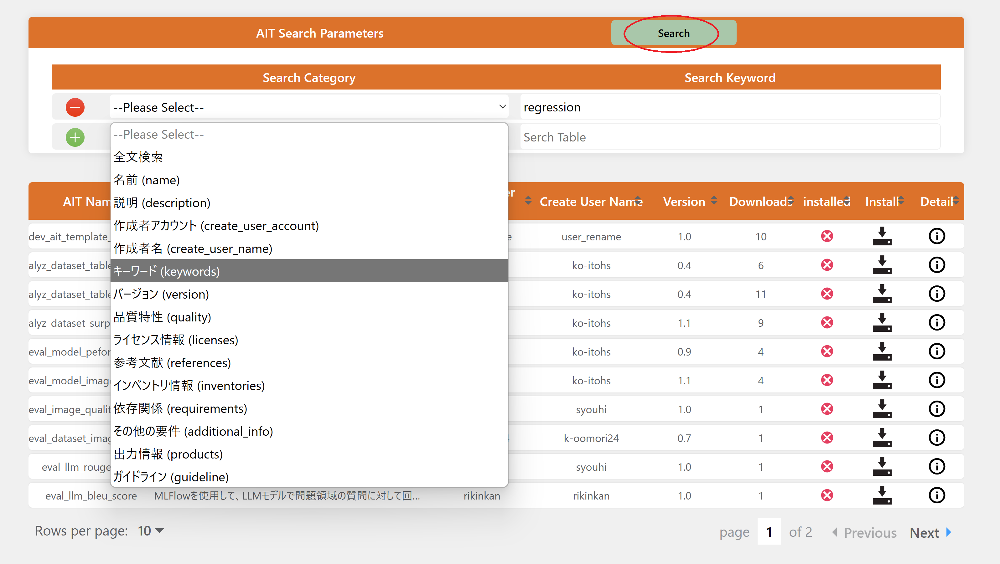

【手順6】今回はモデルのRMSEを確認したいので下記のAITを選択します。右のボタンでAITの詳細を確認してから、左のボタンでAITをインストールしてください。AITのダウンロード・インストールは自動的に進行し、完了後はQunomon上で選択して評価に使える状態となります。

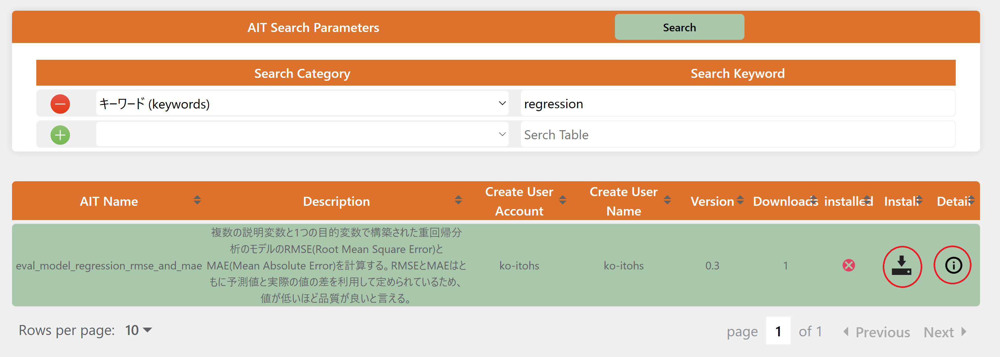

【手順7】下記のAITを検索してインストールします。データセットの分布を測るためのAITは複数用意されていますが、そのうちテーブルデータの分布を評価できるものを選択します。     
Search Category:説明(description)  Search Keyword: テーブルデータ    

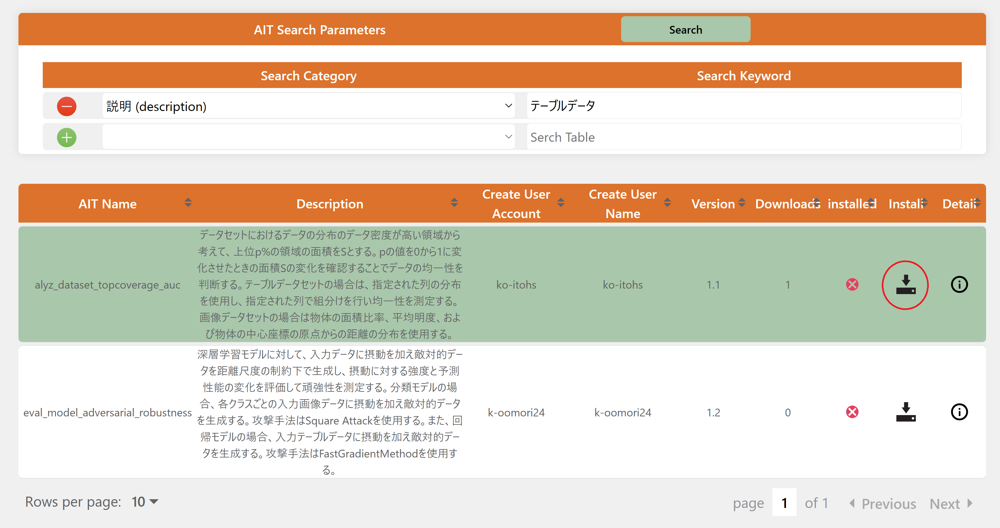

【手順8】下記のAITを検索してインストールします。モデルの安定性を測るためのAITは複数用意されていますが、そのうち回帰モデルを評価できるものを選択します。     
Search Category:説明(description)  Search Keyword: 回帰    

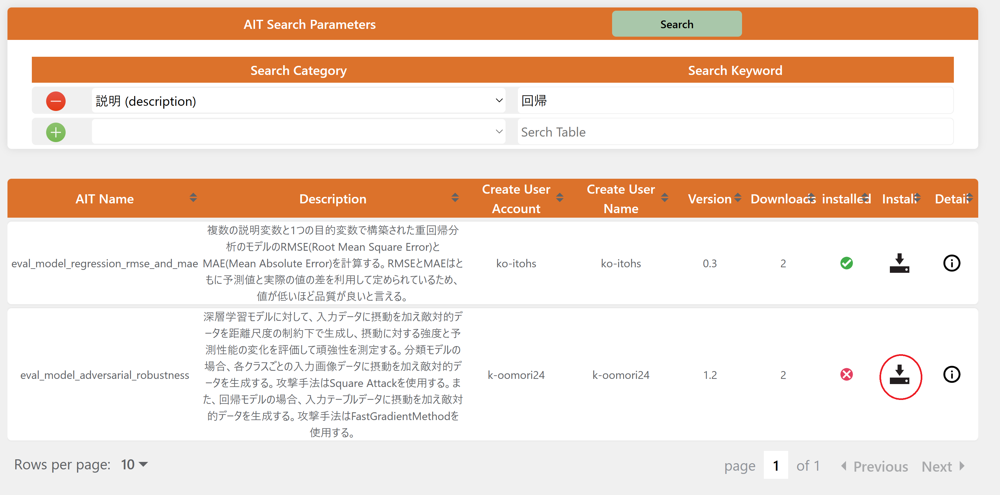

【手順9】
下記のようにInstalled AITs画面に表示されていれば成功です。

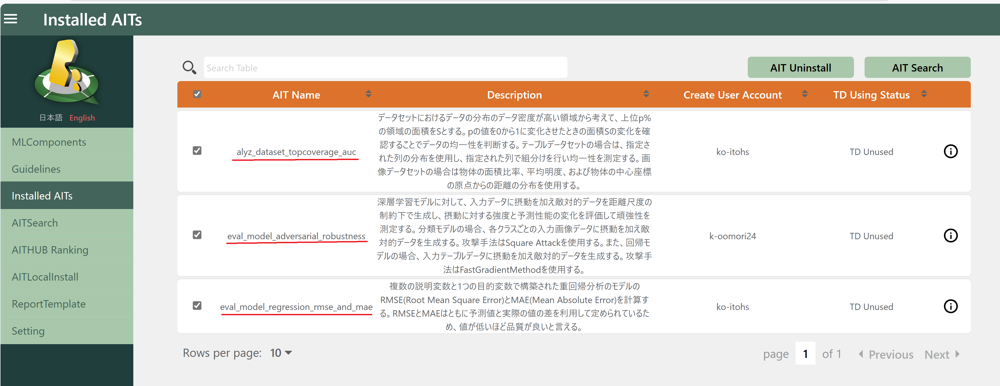

### 3.3.機械学習コンポーネント（MLComponent）の登録
- ここからは、評価対象となる機械学習コンポーネントの登録を行います。
    - 機械学習コンポーネントとは、機械学習システムで用いられる特定の機械学習を用いた機能あるいはモジュールの単位です。複数のモデルやデータセットを管理（品質評価）対象として含む場合があります。
- [MLComponent](https://127.0.0.1/MLComponents)画面へ遷移し、右上のCreateボタンから新たな機械学習コンポーネントを登録しましょう。

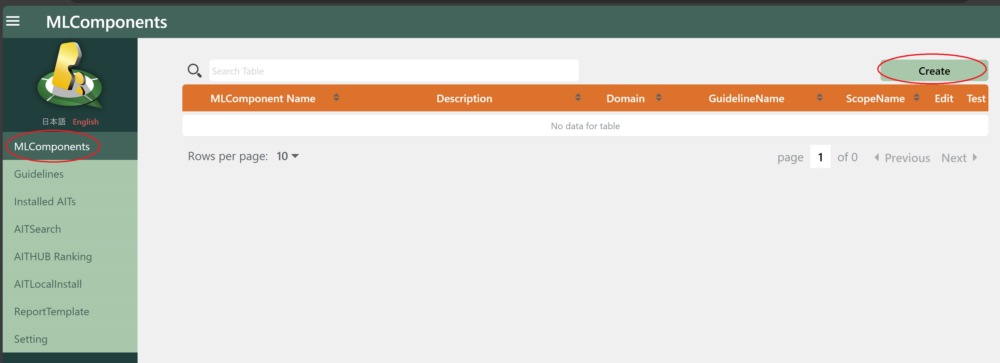



- 後から参照しやすくするため、機械学習コンポーネントの名称と説明を設定する必要があります。
    - ここでは以下の画像のように設定しておきましょう。自由記述ですがタスクのドメインは回帰問題ですので、回帰としておきます。

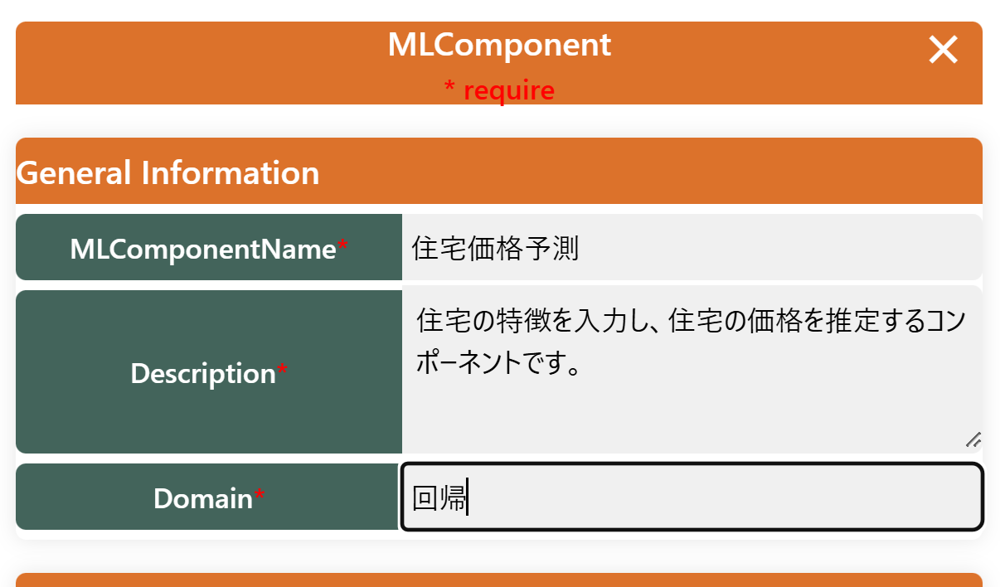



- Qunomonを用いた品質管理では、どのガイドラインや標準に従って品質評価を行っているのかを管理することで、評価観点の抜け・漏れや、ガイドライン・標準に対する適合性を管理します。
    - ここでは最初から設定されている産総研の「機械学習品質マネジメントガイドライン　第三版」を設定しておきます。
- ガイドラインがドメインやタスク種別ごとに異なる品質特性の管理を要求している場合があります。このとき、「スコープ」は今回対象とする機械学習コンポーネントについて管理すべき品質特性をまとめたものです。
    - 機械学習品質マネジメントガイドラインでは、取り扱いスコープがひとつしかありませんので、これを選択しておいてください。
    - ただし、生成系モデルや強化学習などについては今回選択したスコープ（ガイドラインの対象スコープ）の対象となっていません。あらかじめガイドラインを読んだうえで、開発中の機械学習コンポーネントがガイドラインの管理対象となるスコープに含まれるかどうかは品質評価者自身で判断するようにしてください。
- 必要事項が入力出来たらCreateボタンを押下してください。


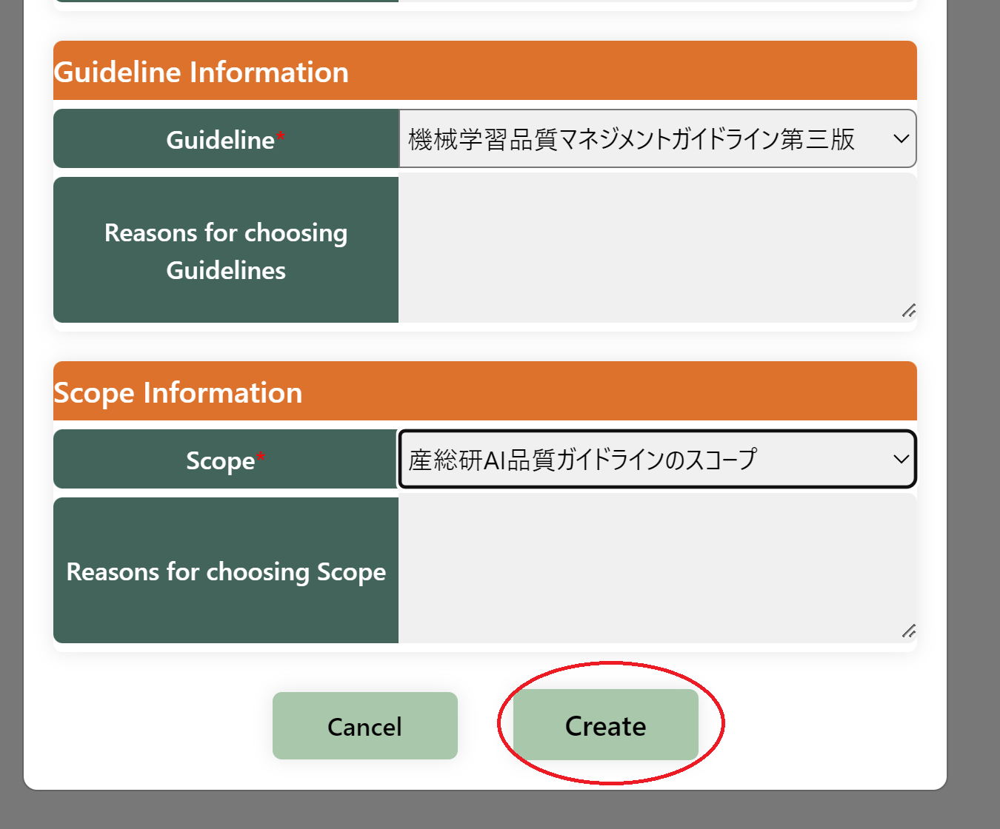

- 次の項目に進む前に、登録した機械学習コンポーネントの詳細画面に遷移しておきます。
    - 機械学習コンポーネントの詳細画面では、機械学習コンポーネントを構成する個々の資産（モデル、データセット）と、個々の資産を複数のインストール済AITで評価するテスト仕様を管理します。
    - それぞれ、個別の資産はInventory（インベントリ）、テスト仕様はTest Description（テスト・デスクリプション）という枠組みで管理が行われます。

### 3.4.テスト仕様（Test Description）の登録
- 次に、テスト仕様の登録を行います。
    - まずMLComponent画面に3.3で作成した住宅価格予測コンポ―ネントが登録されていることを確認してください。
    - 確認出来たら、右端の「テスト」列のボタンを押下し、テスト仕様登録画面へ遷移します。
    
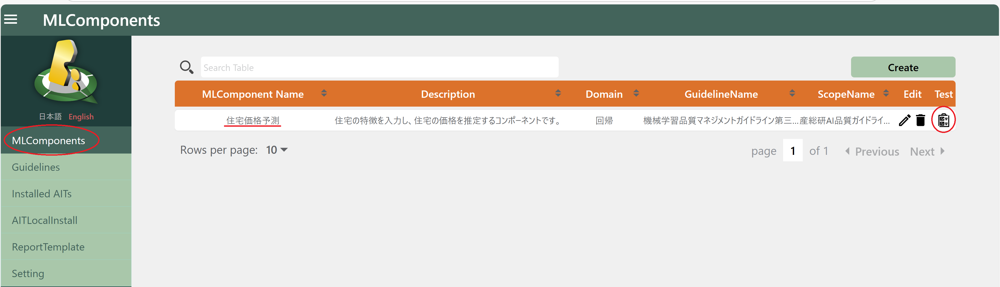

    
#### 3.4.1.テスト対象資産のインベントリへの登録
- テスト仕様を登録する前に、テスト対象資産（テストしたいデータセットやモデル）を、MLComponentのインベントリ領域に格納する必要があります。テスト時には、ここに登録されたテスト対象資産がAITから参照され、検査されます。
- 以下はテスト仕様登録画面からテスト対象資産の登録を行う手順になります。

【手順1】住宅価格予測 MLComponent のテスト仕様登録画面から Inventories を押下します。

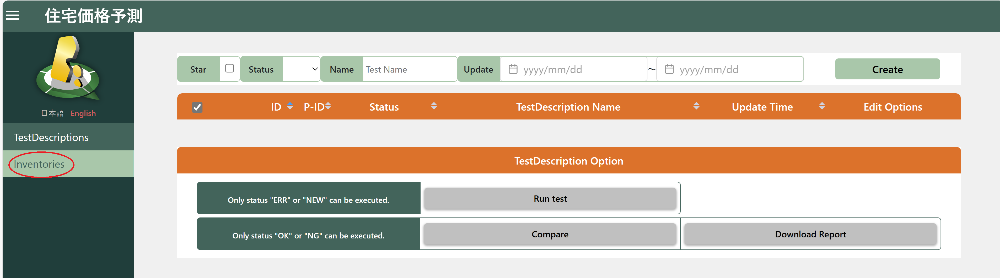

【手順2】住宅価格予測 MLComponent のインベントリ一覧画面から Create を押下します。

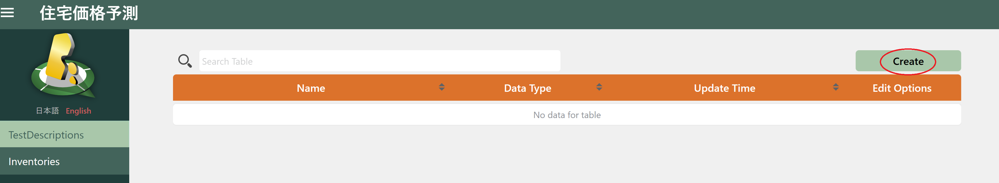

【手順3】まずはモデルを登録します。Torchscript形式に変換されたモデル (こちらからダウンロード) をPC上に配置し、Path欄にはそのファイルパスを入力してください。 Nameには他のアセットと判別しやすい名前をつけてください。DataTypeは登録する資産に適合するものを選んでください。ここではmodelとなります。Formatはファイルフォーマットです。拡張子よりpthを選択します。 ** モデルを訓練し、Torchscript形式で保存する方法については後述します。第二部 7章を参照してください。 **

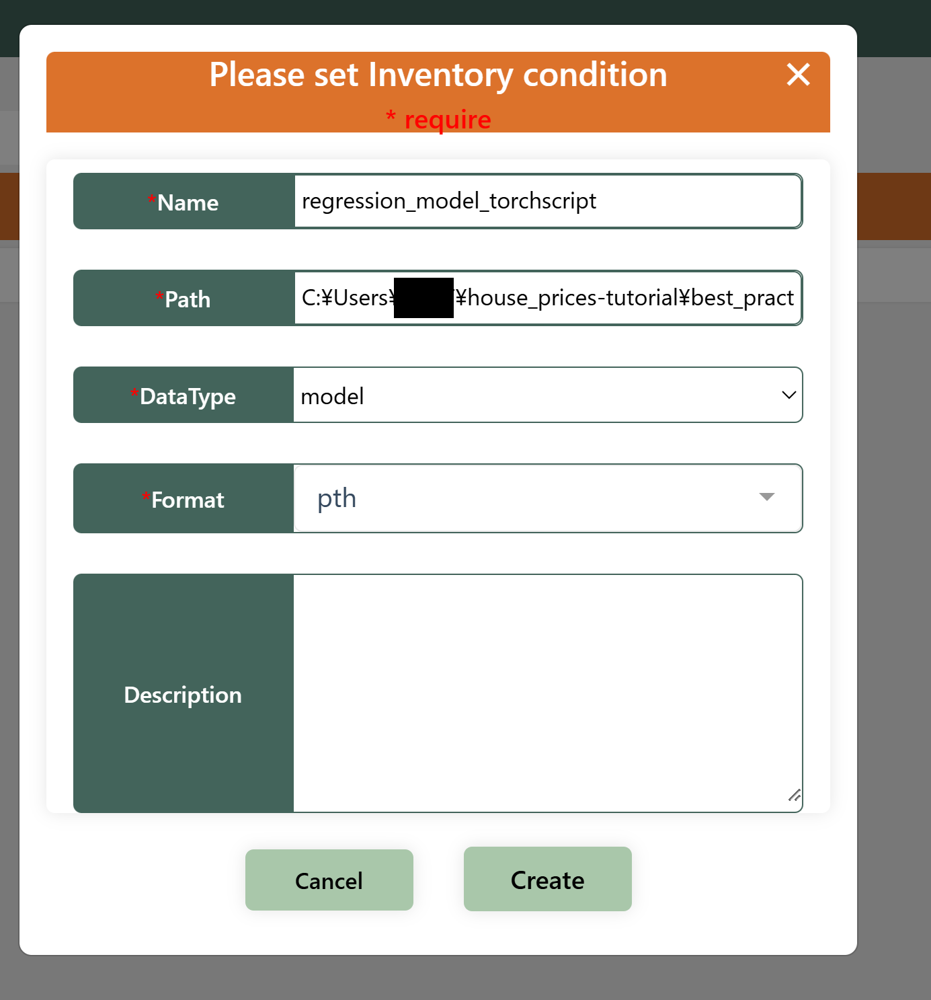

【手順4】同じくデータセットを登録します。csv形式のデータセットのファイルパスを指定してください。 6.2.1.のコード内にコメントアウトされている通り、マシンスペックによってはテスト実行時にメモリ不足を起こす可能性があります。適宜テスト用データセットのサイズを小さくしてお試しください。

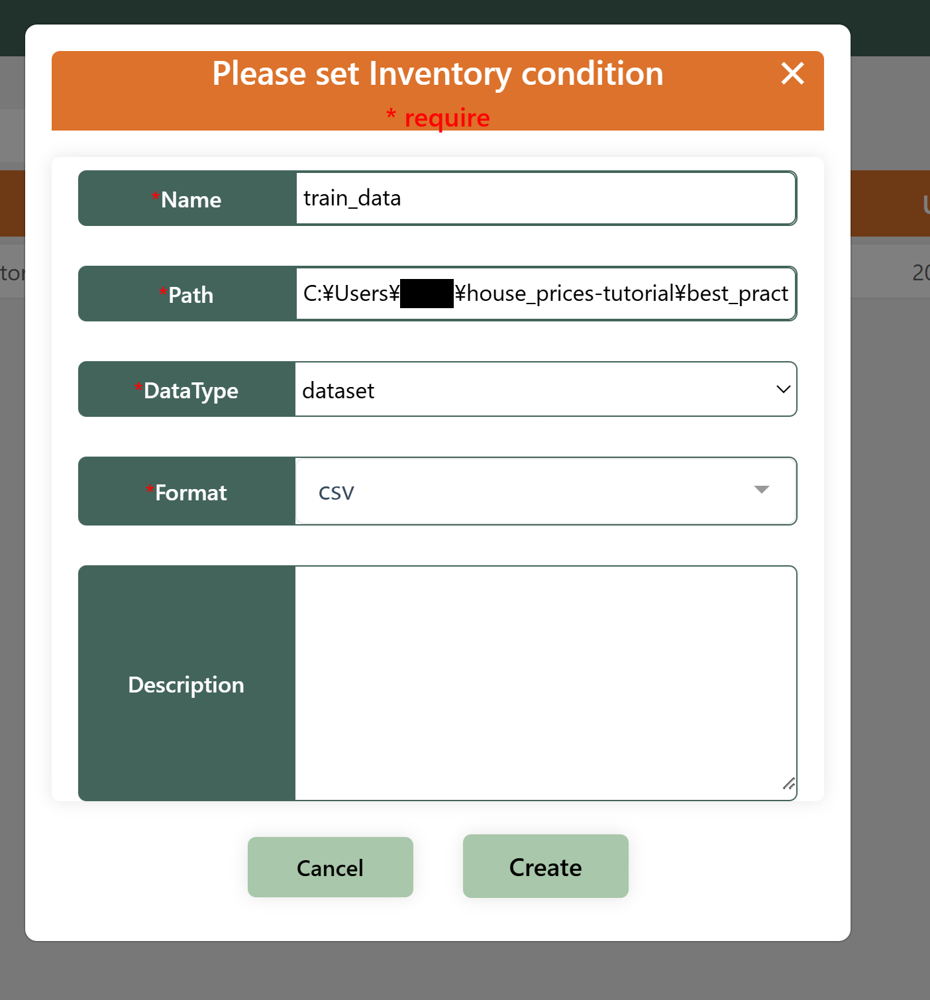

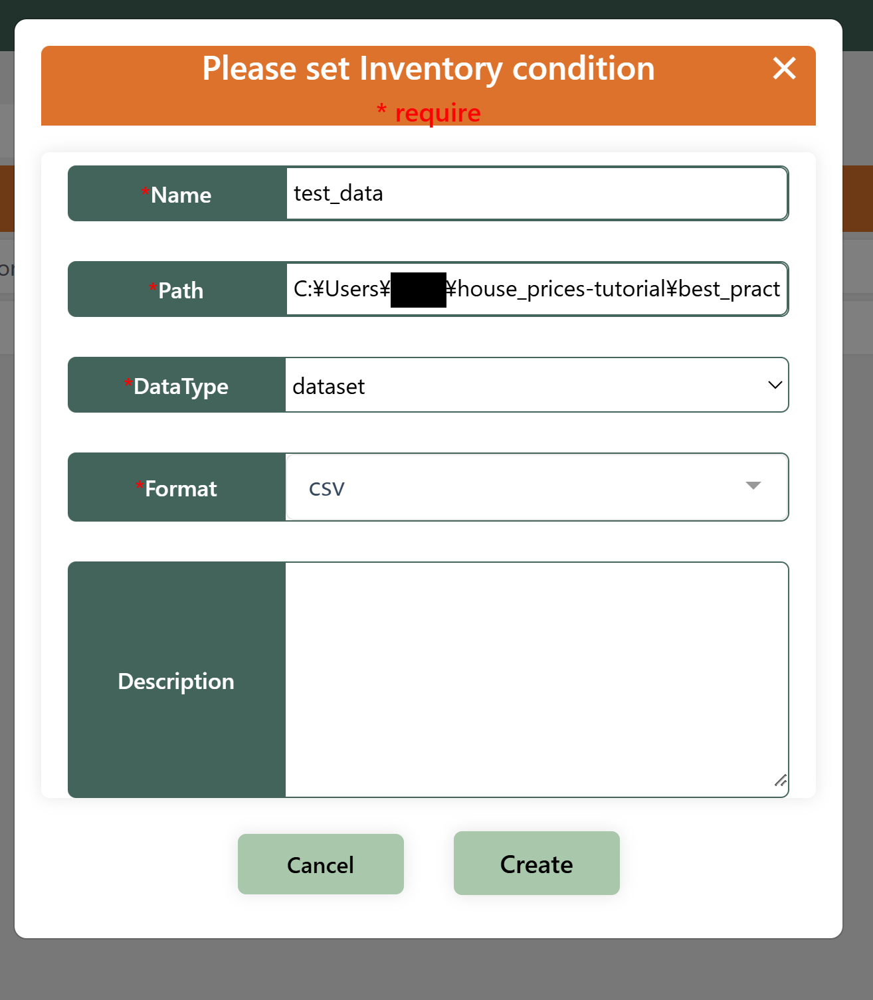

【手順5】登録が完了したら、テスト仕様登録画面に戻ってください。

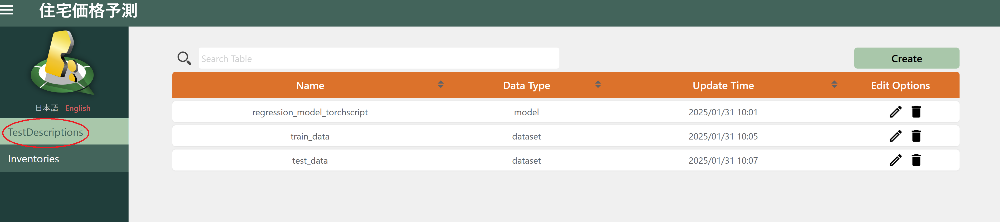

#### 3.4.2.テスト仕様の登録
- テスト仕様の登録を行います。

【手順1】テスト仕様登録画面へ遷移します。

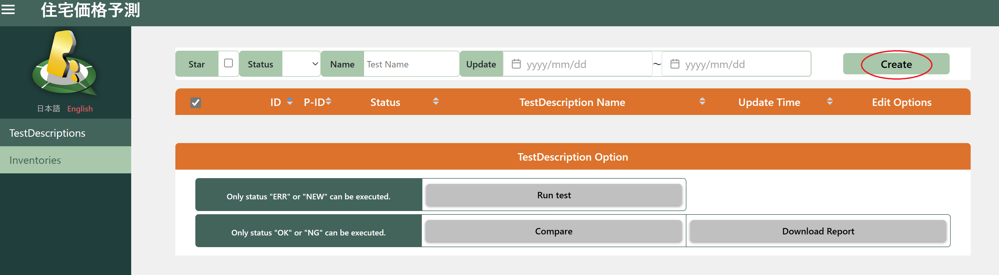

【手順2】下図の要領で必要事項を入力します。

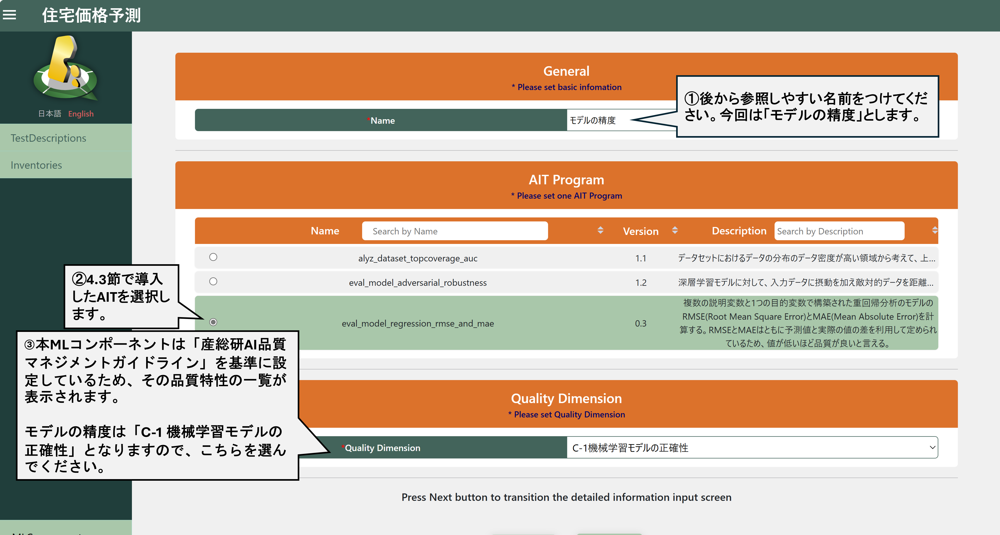

【手順3】テスト受け入れ基準を設定します。今回は、RMSE、MAEともに1以下を基準としておきます。 

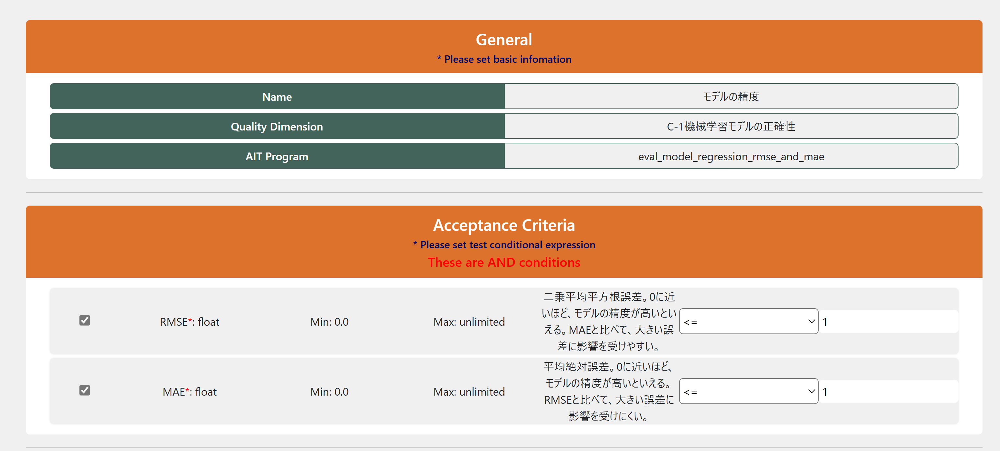

【手順3の続き】画面を下にスクロールし、AITの実行時に要求されるパラメータを入力してください。 ここでは、CSV形式のデータセットのターゲット変数の列名を入力します。ターゲット変数の列名は "median_house_value"となりますので、これを入力します。データセットは標準化スケールを行っていますので、他のパラメータは入力しないでそのままにします。 また、テストで用いるデータセット・モデルを登録したインベントリと紐づけてください。 準備が完了したら、Createを押下してください。

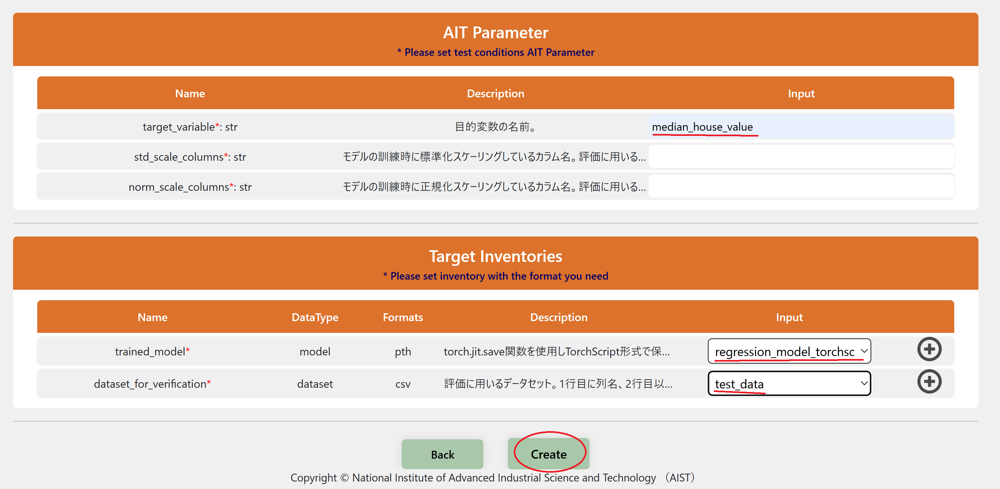

【手順4】データセットの特徴量分布に関するテスト仕様を登録します。6.2.1.節で生成したCSV形式のデータセットを読み込み、訓練データの特徴量の分布が均一であることを確認します。同様にテストデータでも行います。

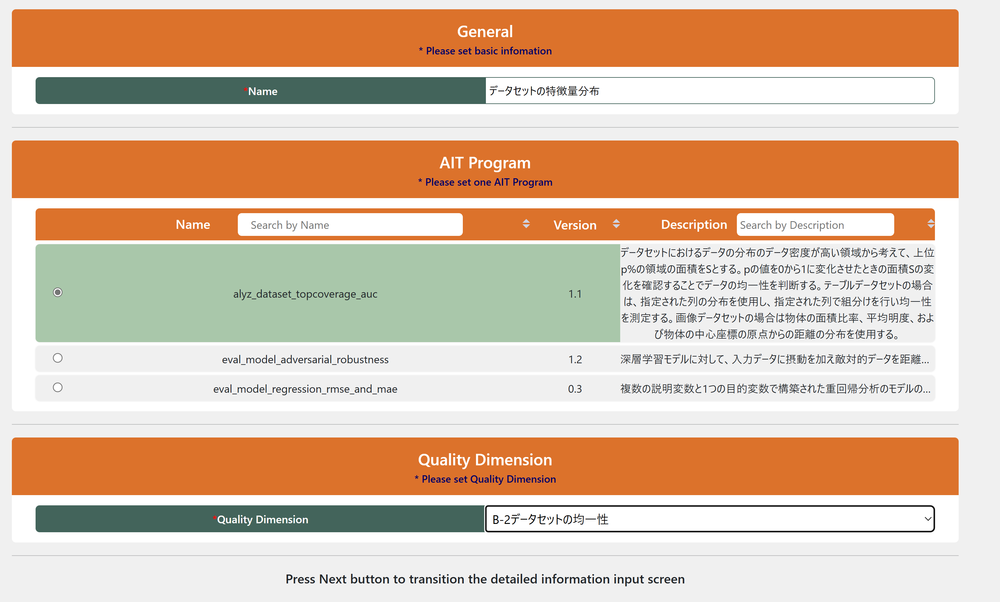

【手順4の続き】設定値は下記のようにします。train_csv_Topcoverage_AUCとtest_csv_Topcoverage_AUCを0.6以上と設定しておきます。train_csv_Topcoverage_AUCとtest_csv_Topcoverage_AUC以外は画像データセット用の測定値なので、設定しません。     
また、パラメータに関してはtarget_columns：house_median_value、group_columns：median_income、num_group：4に設定します。ターゲット変数を含む特徴量の相関行列を確認するとhouse_median_valueとmedian_incomeの相関が高いので、この設定にしました。相関行列の表示に関しては6.3.節で行います。    
target_columns、group_columns、num_group以外は画像データセット用のパラメータなのでデフォルトのままにしておきます。

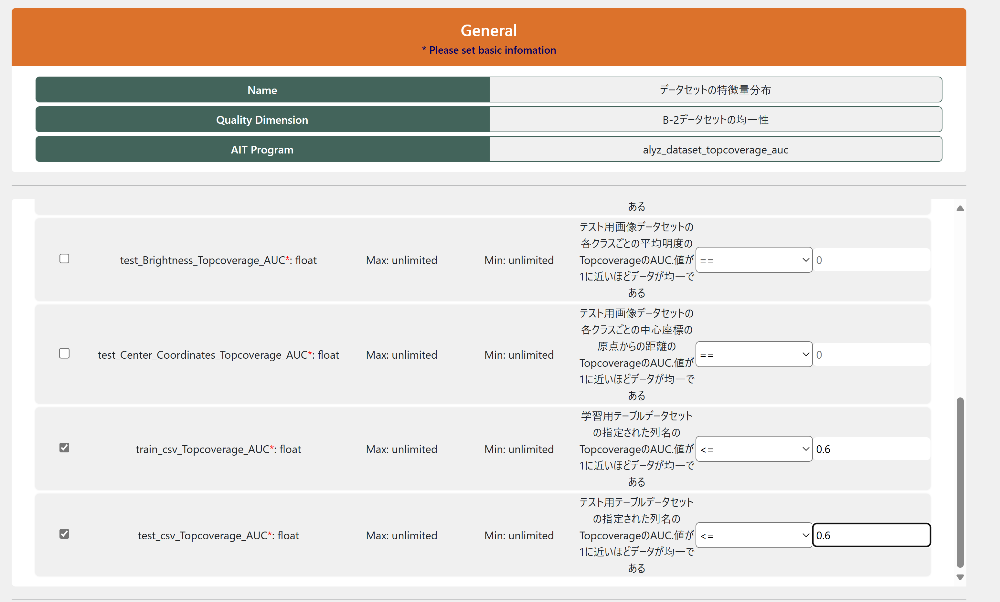

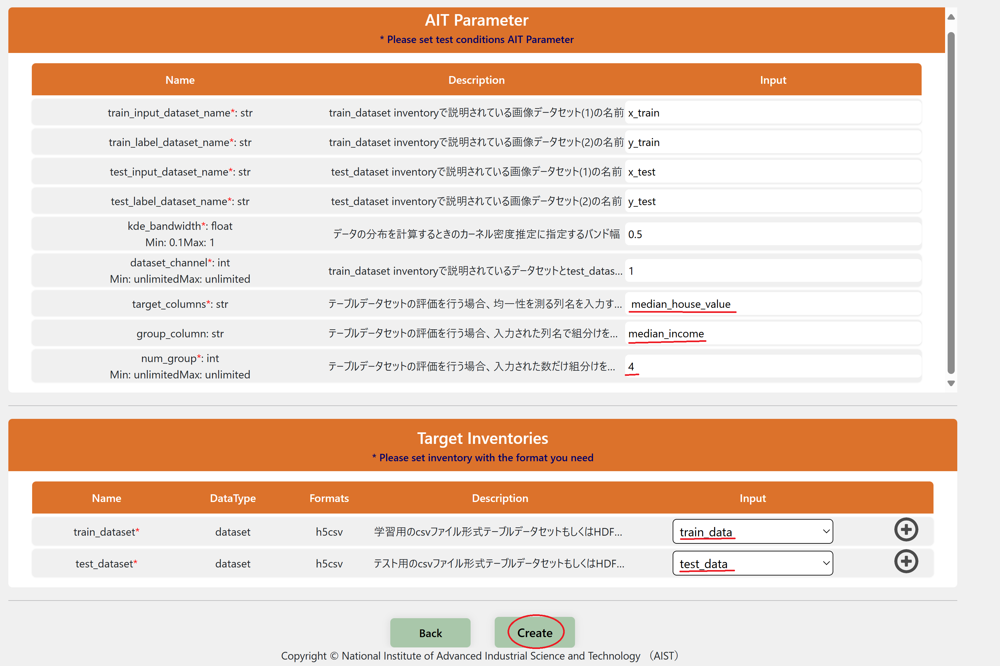





【手順5】モデルのロバスト性に関するテスト仕様を登録します。6.2.1.節で生成したCSV形式の訓練用データセットを読み込み、敵対的データに対してモデルが頑健であるかを確認します。

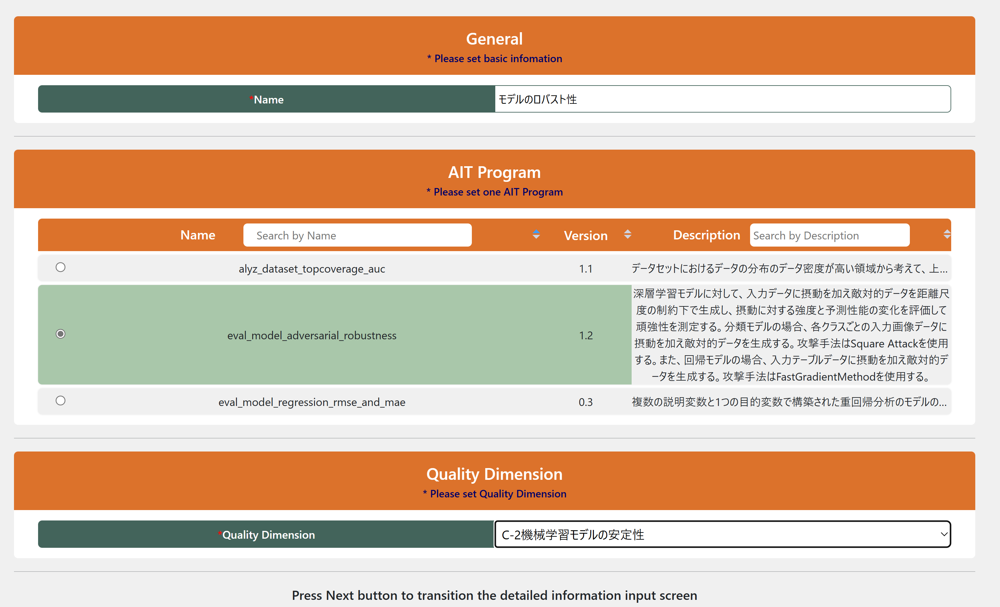

【手順5の続き】設定値は下記のようにします。今回のモデルは敵対的データに対して学習を行っていないですが、Adversarial Robustnessを1以上と設定しておきます。    
パラメータ設定はdata_typeをtableに、epsilonを0.5にして、それ以外はデフォルトのままにしておきます。また、テストで用いるデータセット・モデルを登録したインベントリと紐づけてください。 準備が完了したら、Createを押下してください。

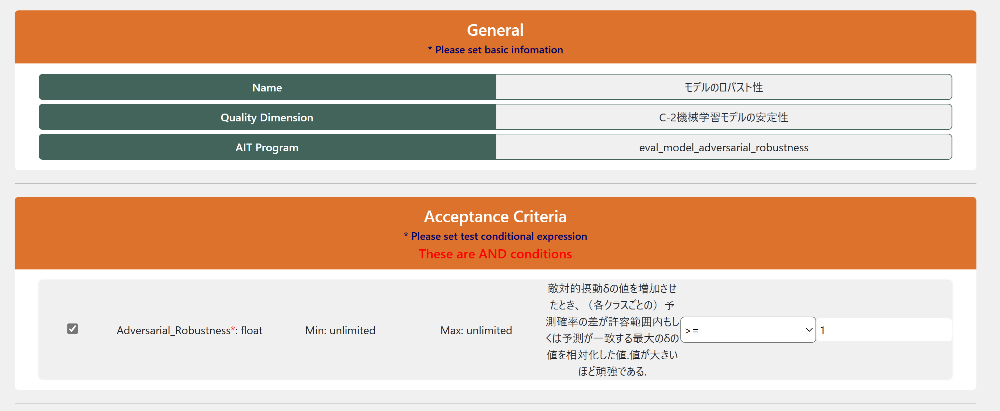

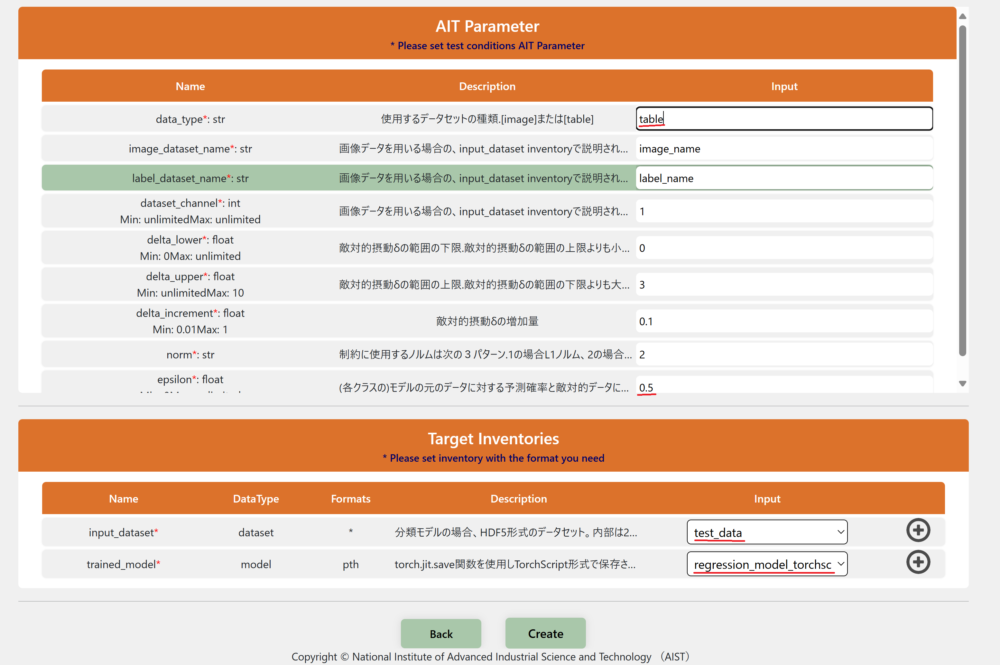

### 3.5.評価の実行と結果確認
#### 3.5.1.実行
MLコンポ―ネントのテスト仕様画面に遷移し、3.4.節で設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。

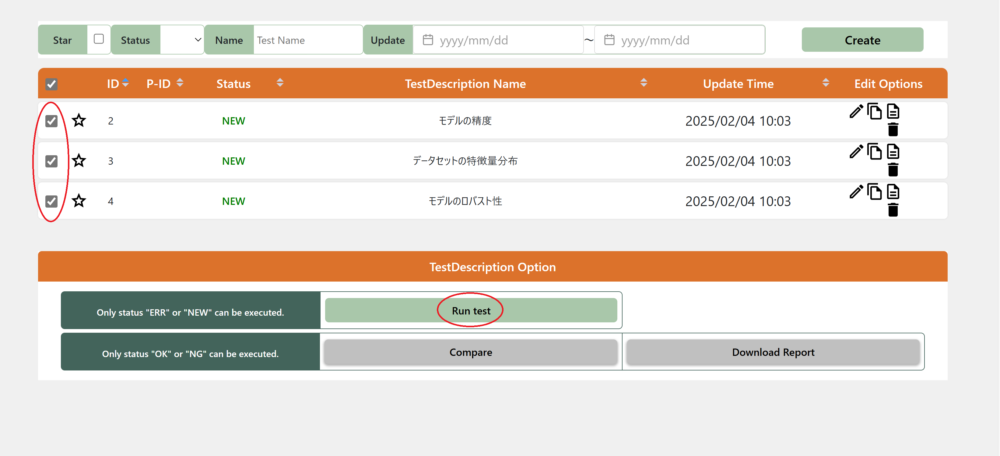

テストはリアルタイムに実行され、状況も画面上に表示されます。 図示するように、Status:DONEと表示されれば評価が完了したことを表します。 次行の評価結果のうち、「OK」はすべての受け入れ基準を満たしたことを表し、「NG」は受け入れ基準を満たさない項目があったことを表します。 ※「ERR」「NA」は実行中になんらかの問題があったことを表します。エラー発生時にはログも閲覧できます。

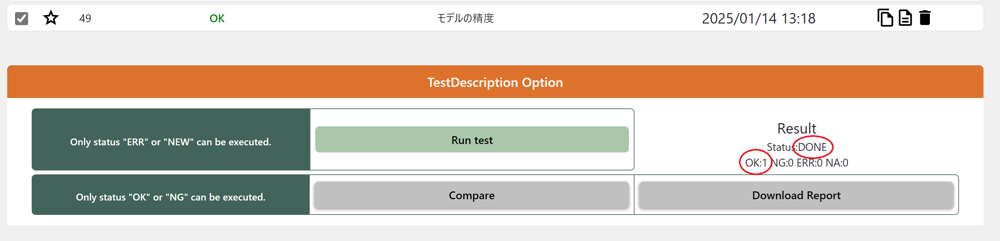

#### 3.5.2.モデルの精度の評価結果の確認
実行したテスト仕様の右列にある"detail"ボタン（資料のアイコン）をクリックすると結果の詳細を閲覧できます。 この画面であなたのテスト結果に対する見解を入力してください。 テスト結果が「OK」であることは、設定した受け入れ基準することを表しますが、最終的には人間が評価の実行結果を確認して判断する仕組みになっています。 以降はテスト結果画面の説明になります。

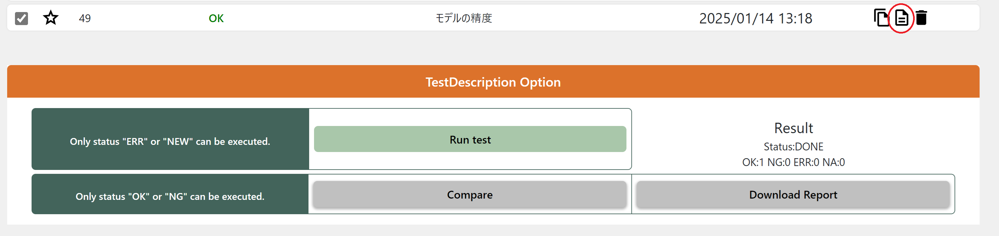

左上の領域ではAITが出力した参考情報（画像など）が出力されます。 このAITはクラスごとのRMSE、MAE、MSEの表が出力されますので、RMSE、MAEを確認しモデルの精度を確認します。また観測値と予測値の相関グラフも出力されますので参考に見ておきましょう。

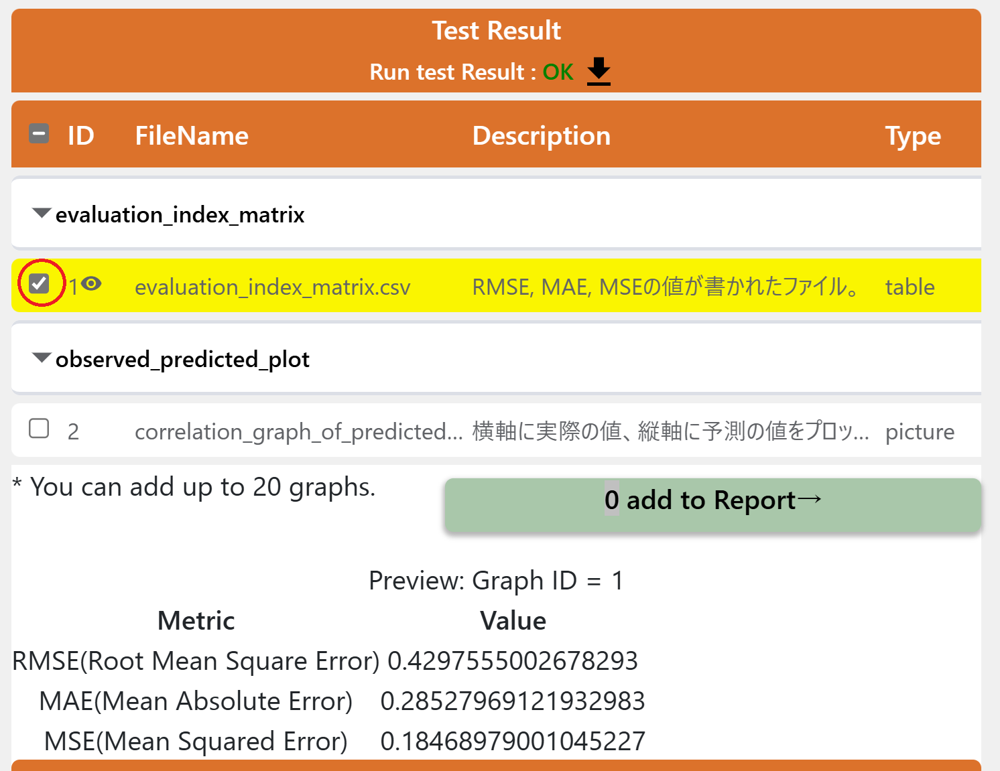

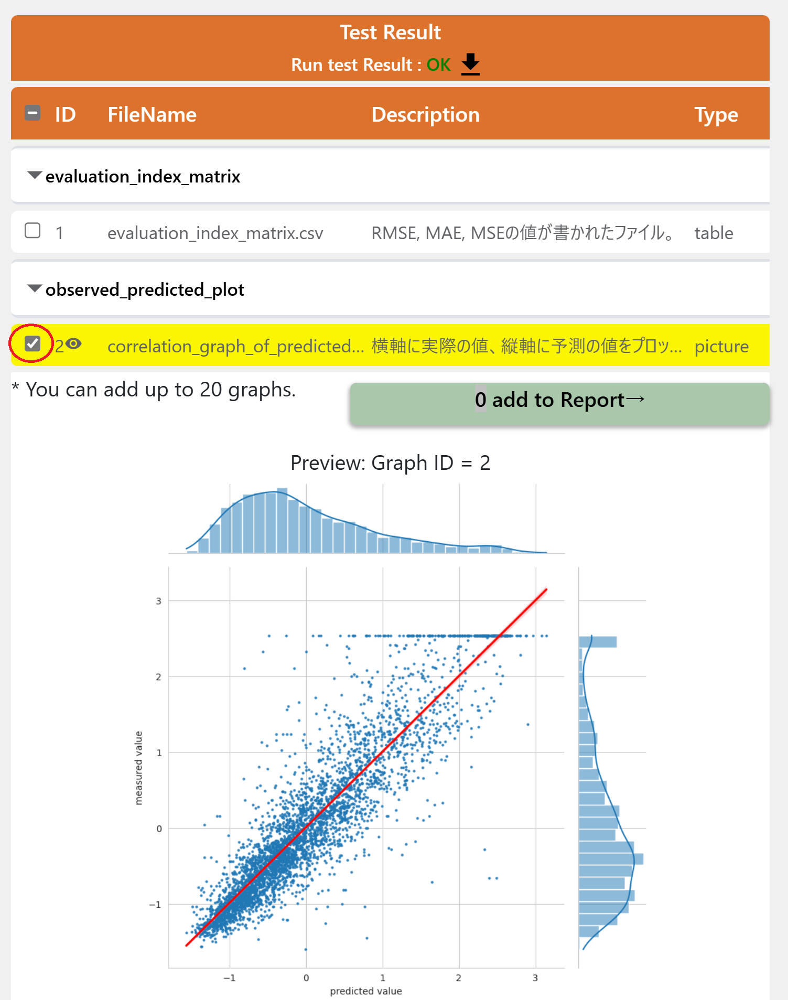

この領域にはテスト結果の正確な値が表示されています。 Measurementに計測値が、Descriptionにその説明が、そしてConditionに設定した受け入れ基準が表示されています。表示しきれていない部分はスクロールして確認できます。今回はRMSEとMAEの要件も満たしているため、この観点では問題ないと考えられます。

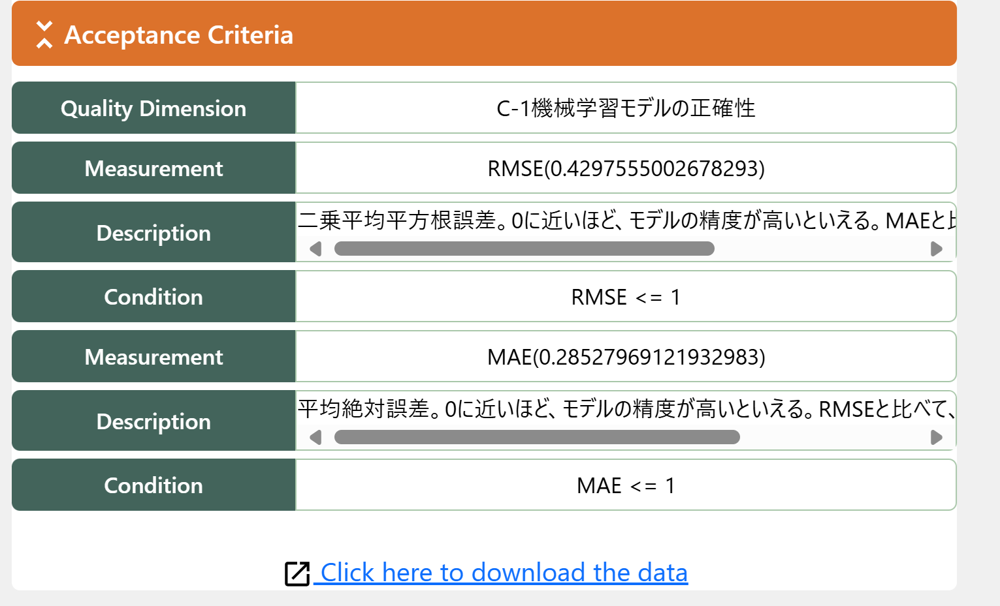

画面右が見解記入領域です。 上部は、AITが出力した画像のうちどれを最終的な結果ドキュメントに含めるかの設定ができます。 今回の結果に対して見解を記入し、Saveボタンを押下しましょう。

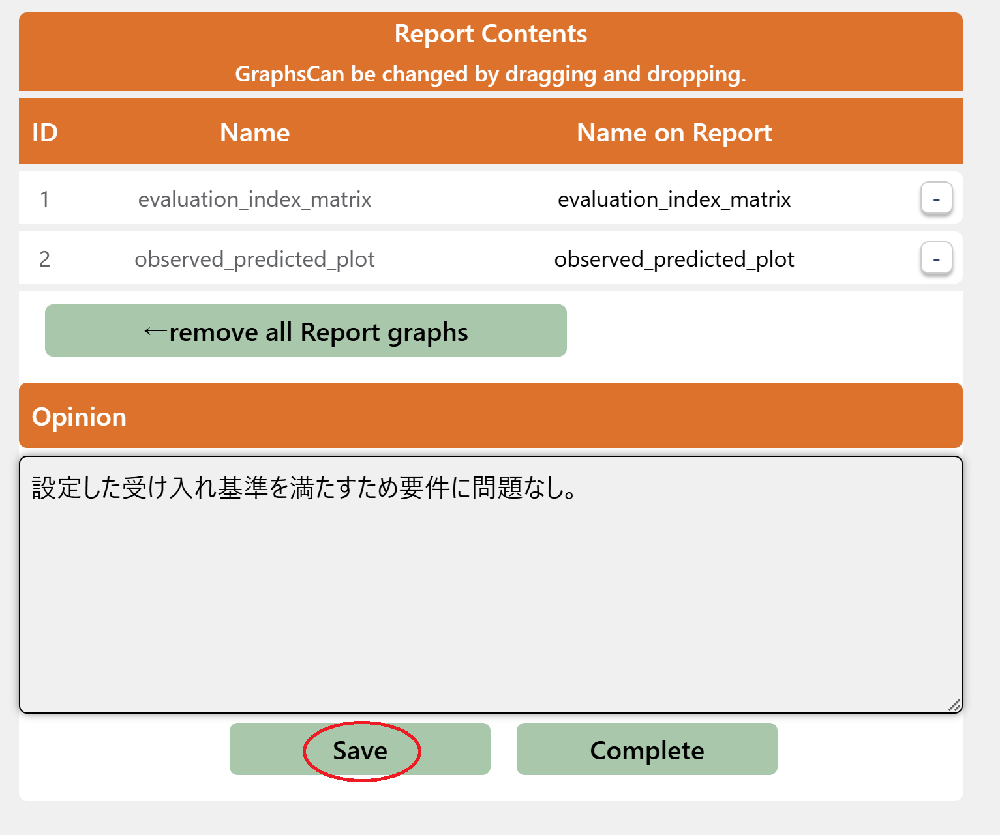


#### 3.5.3.データセットの分布の評価結果の確認

データセットの特徴量分布の評価結果も確認しておきましょう。ステータスにNGが表示されています。これは設定した受け入れ基準を満たしていない組が1つ以上あることを示しています。テスト結果の測定値を確認してみます。    
訓練用データのmedian_incomeが約2以上の2組のhouse_median_valueの均一性が設定した受け入れ基準を満たしていないことがわかります。

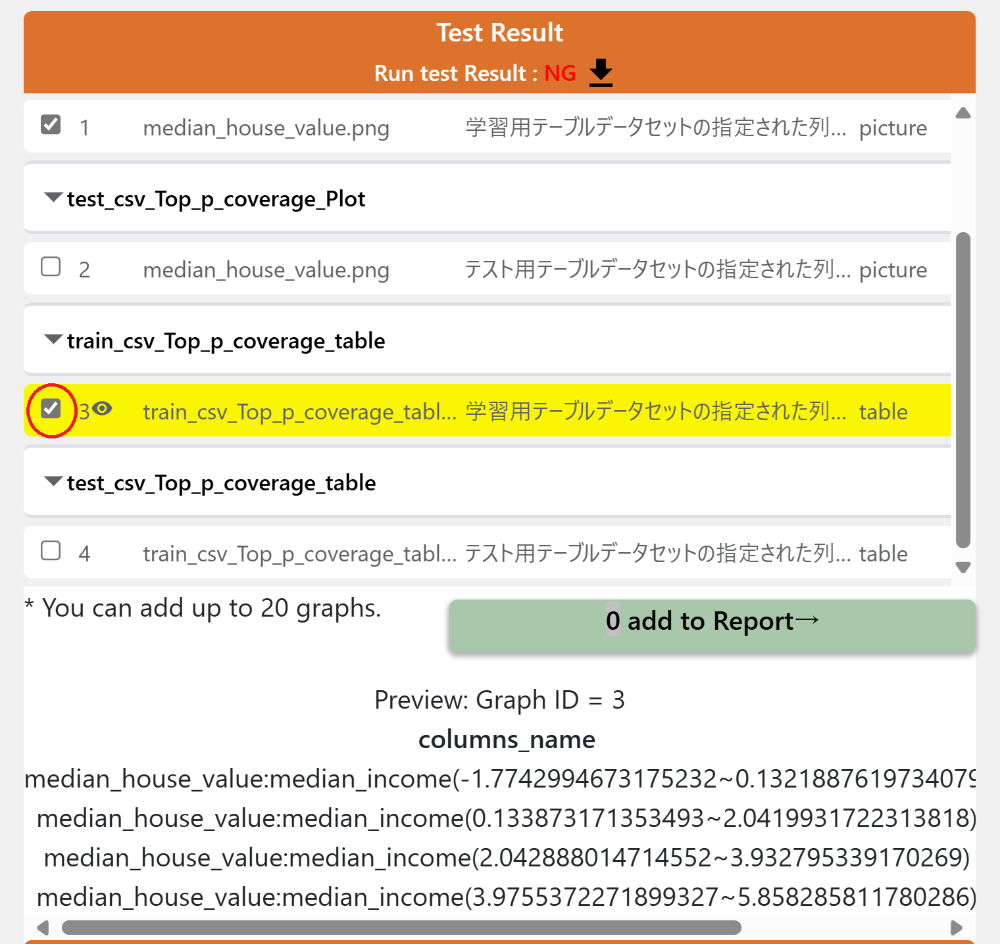

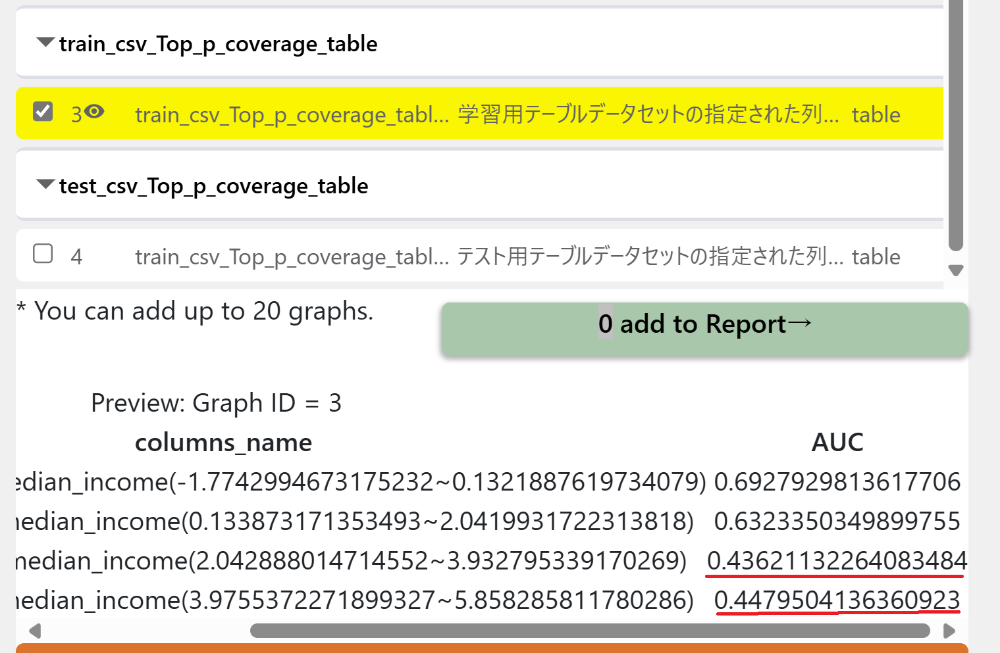

訓練データのTPCoverageの変化曲線を確認すると、median_incomeが約2以上約4以下の曲線はなだらかに増加してますが、median_incomeが約2以下の2組に比べて増加率が小さいです。    
また、median_incomeが約4以上約6以下の曲線はｐの値が0.3からほとんど増加していないことがわかります。

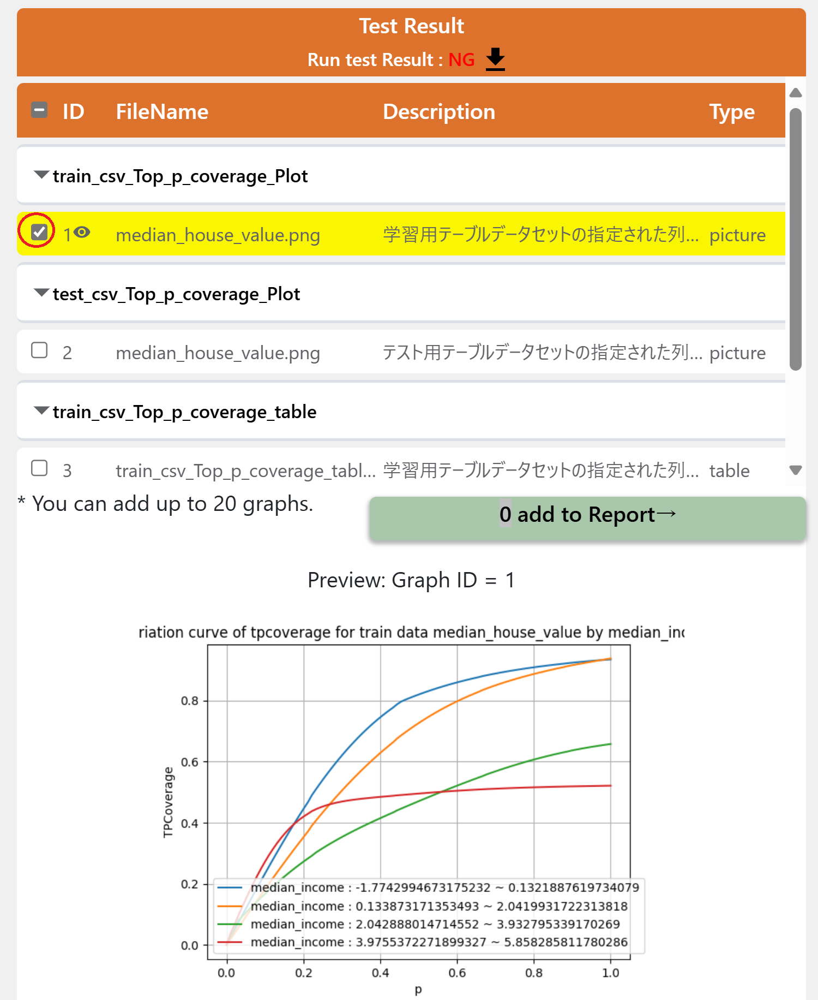

カーネル密度推定にて、これら2つの組の密度プロットを確認してみます。    
確認すると、2つの組の分布が偏った形状をしていることがわかります。

| median_incomeが約2以上約4以下の組 | median_incomeが約4以上約6以下の組 |
| -------------------------- | -------------------------------------|
| 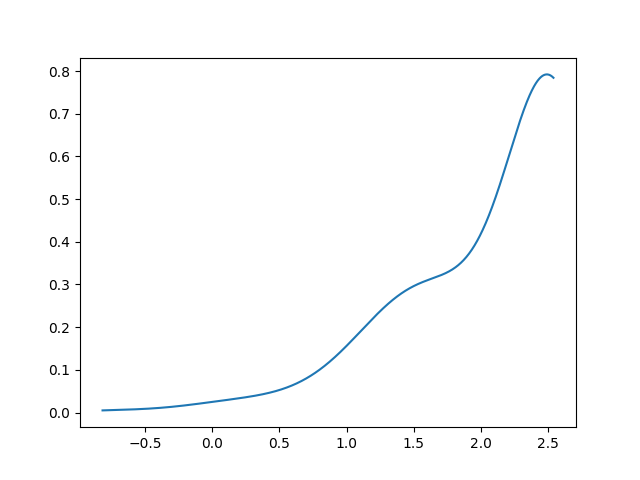 | 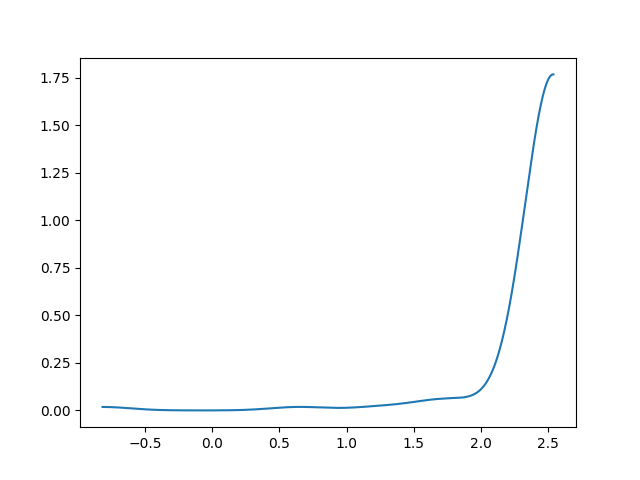 |

データの拡張を行い、分布を調整する必要があります。テスト用データはデータ拡張を行いません。品質見解に記載をします。

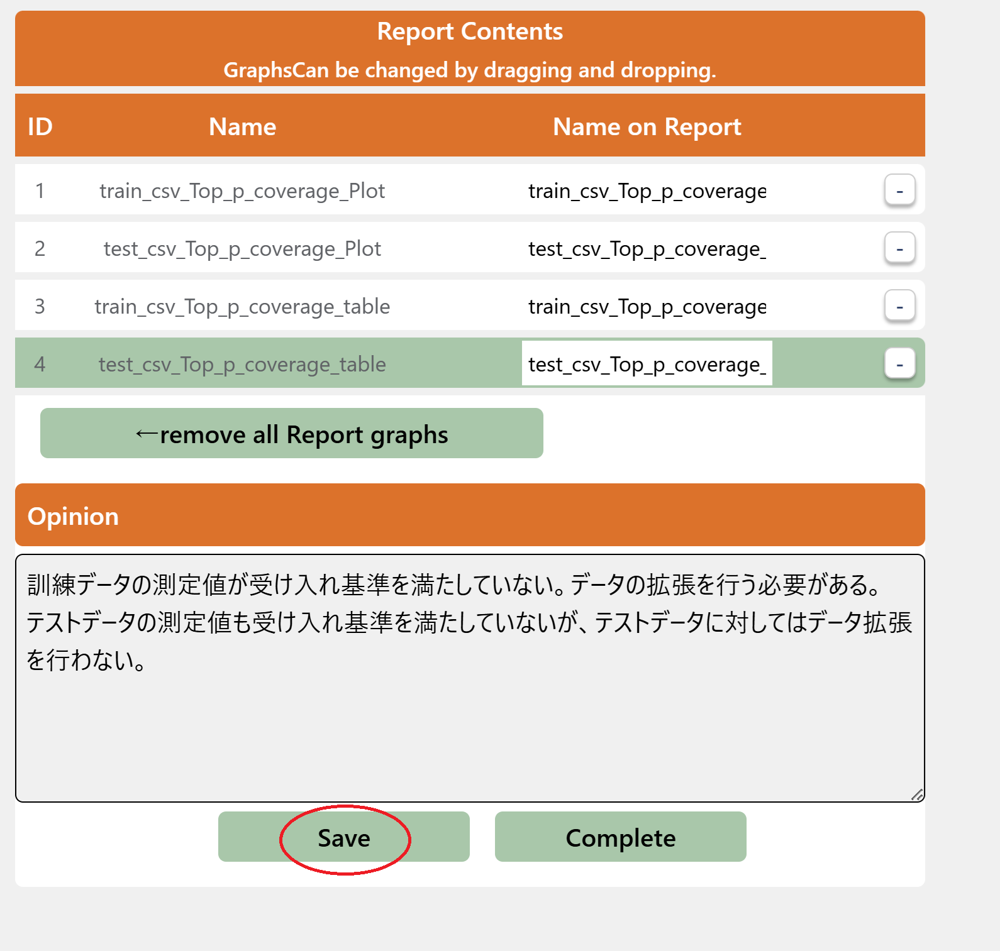

#### 3.5.4 モデルのロバスト性の評価結果の確認

モデルのロバスト性の評価結果も確認しておきましょう。ステータスにNGが表示されています。これは設定した受け入れ基準を満たしていないことを示しています。テスト結果の測定値を確認してみます。    
Adversarial Robustnessが0となっています。また、敵対的摂動と違反率（モデルの元データに対する予測値と敵対的データに対する予測値の差が許容範囲外の割合）の推移のプロットを確認すると、敵対的摂動が0.1のときで違反率が約0.2となっています。モデルは加えた敵対的摂動が微小でも予測を安定して行えないことがわかります。

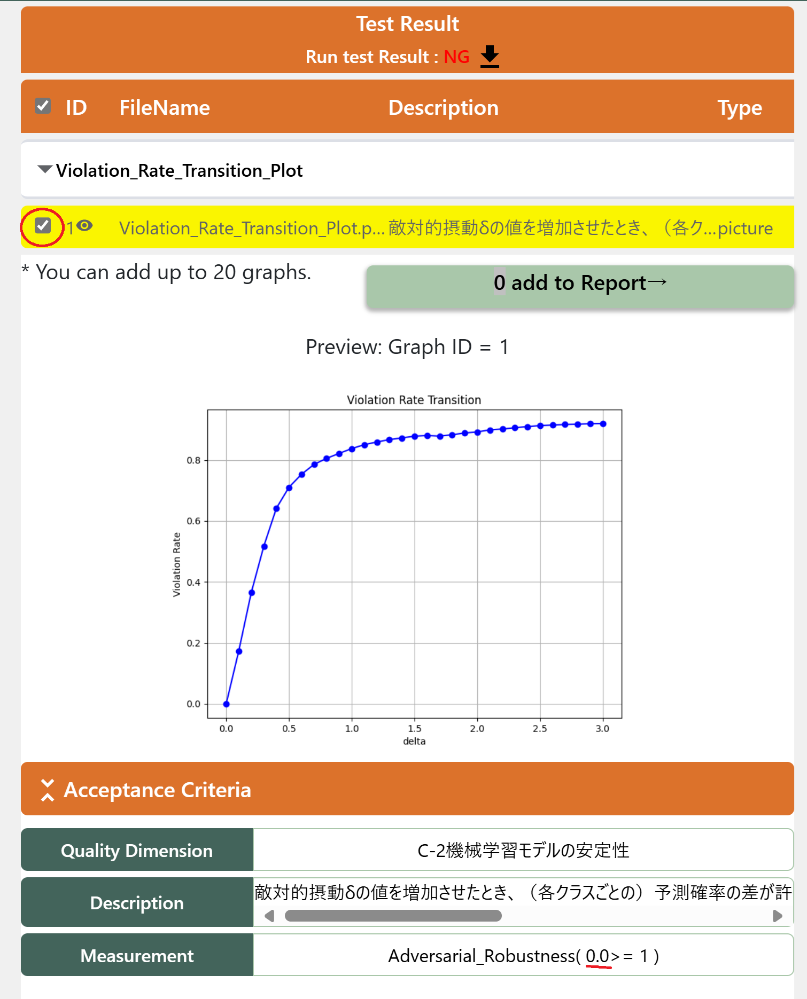

品質見解に記載します。

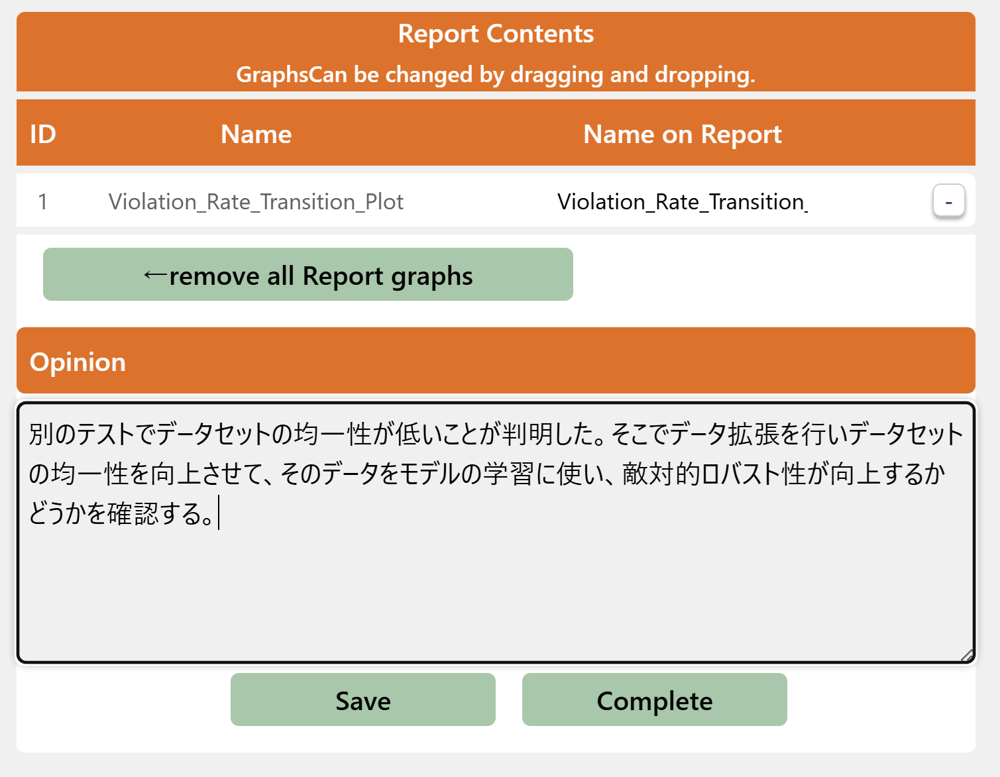

## 4.品質評価を踏また訓練データの拡張と拡張後の訓練データの評価
3.5.3節で訓練データの均一性が低いことが判明したので、向上させるためにデータの拡張を訓練データに対して行います。    
今回行うデータ拡張はMixupを使う方法、Cutmixを使う方法、混合ガウスモデル（GMM）を使う方法の3つの方法を試します。
データについては6.4.節で説明・配布します。


### 4.1.拡張後のデータの評価
最初に3.4.1.節と同様にテスト対象資産を登録を行います。

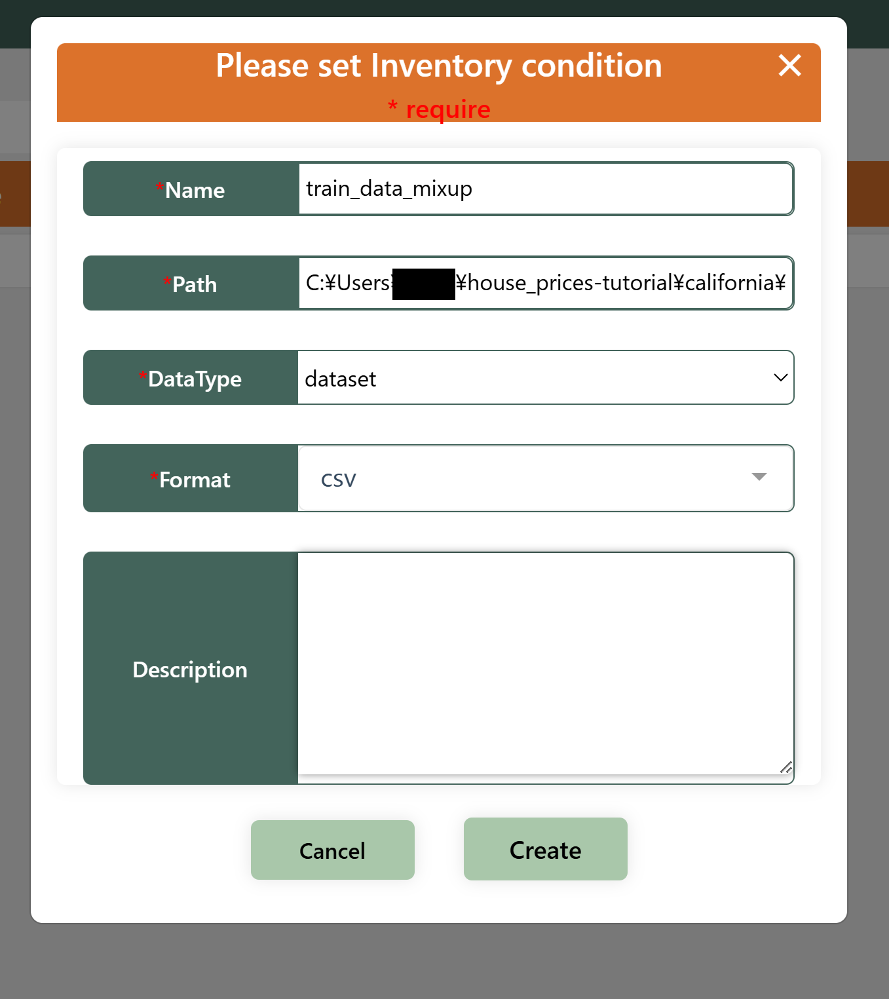

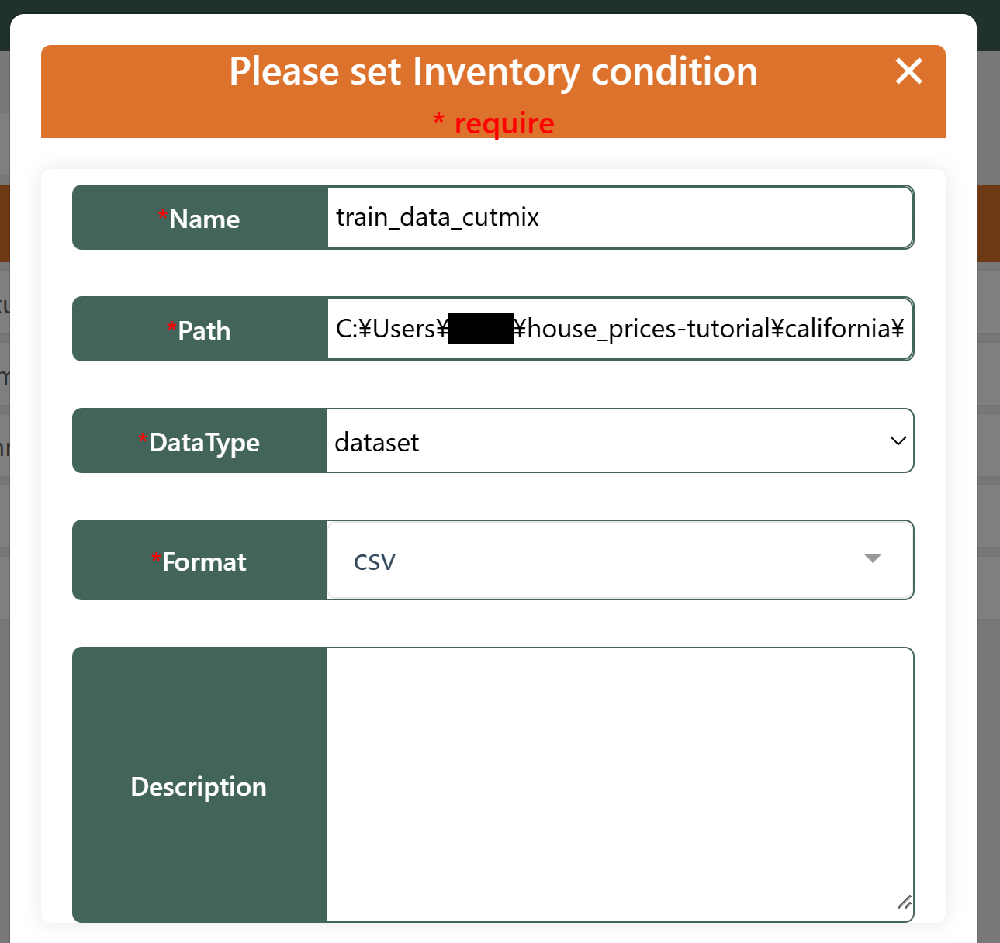

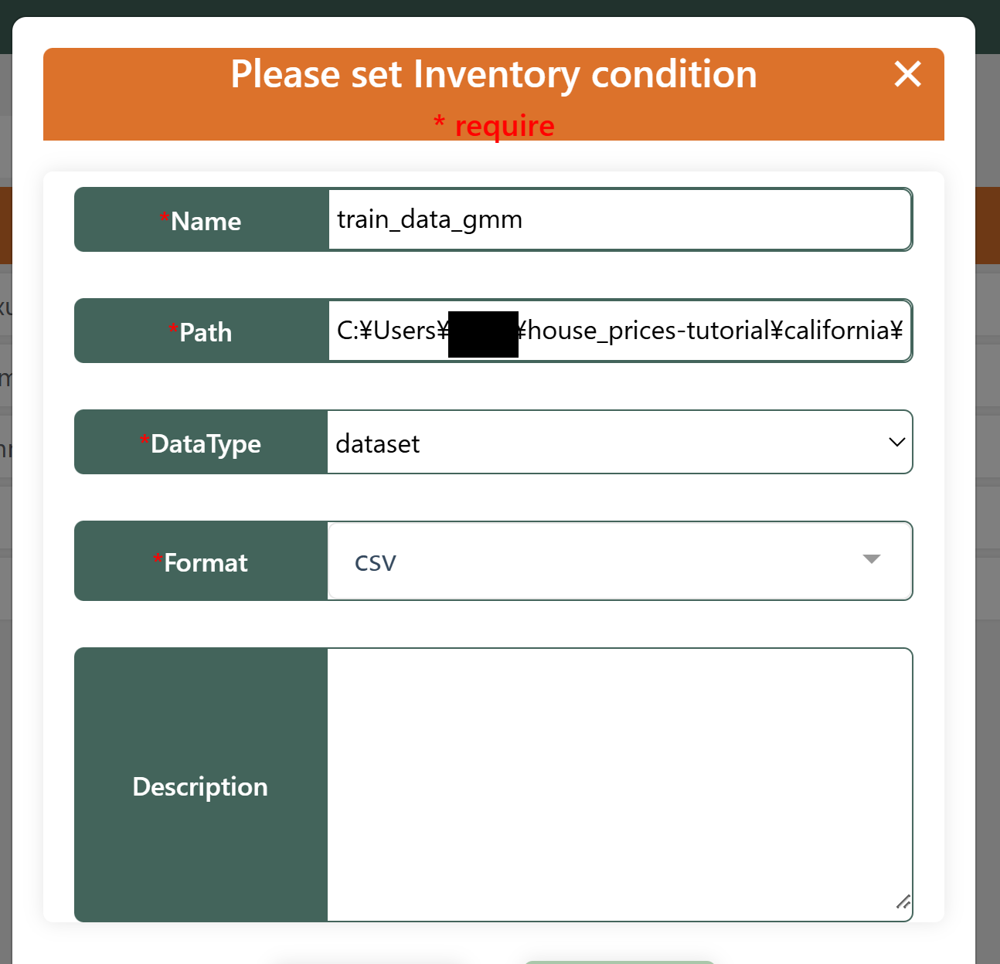







#### 4.1.1.Mixupを使ったデータの評価

3.5.3.節で使ったテストをコピーして今回のテスト仕様を登録します。
Edit Optionの一番左のアイコンを押下します。

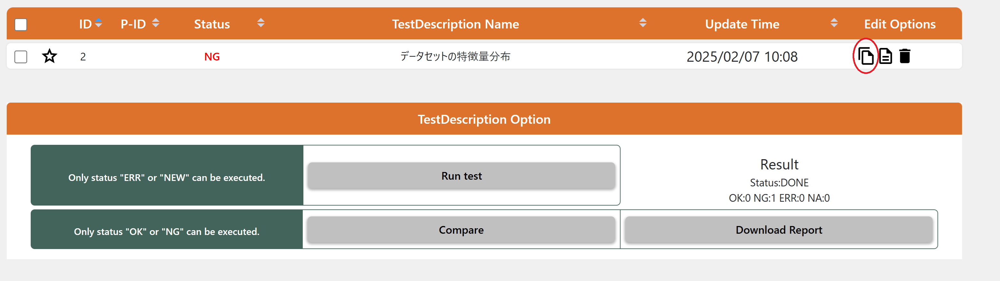

名前を以前のものと違いが分かるように設定します。また、今回は拡張した訓練データの評価をしたいので、train_csv_Topcoverage_AUCにのみチェックを入れます。

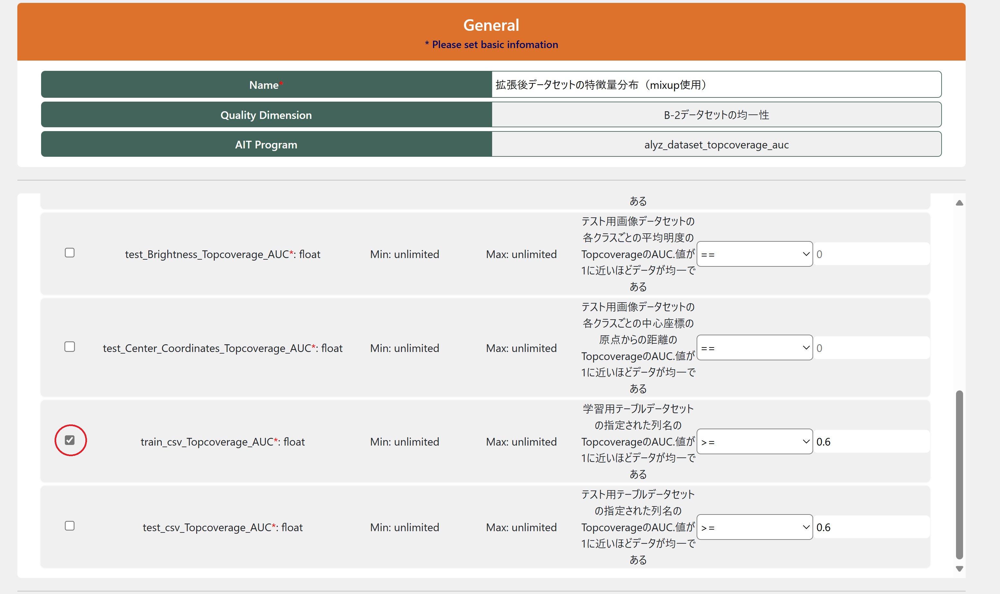

先ほど登録したデータを選択し、Createを押下します。

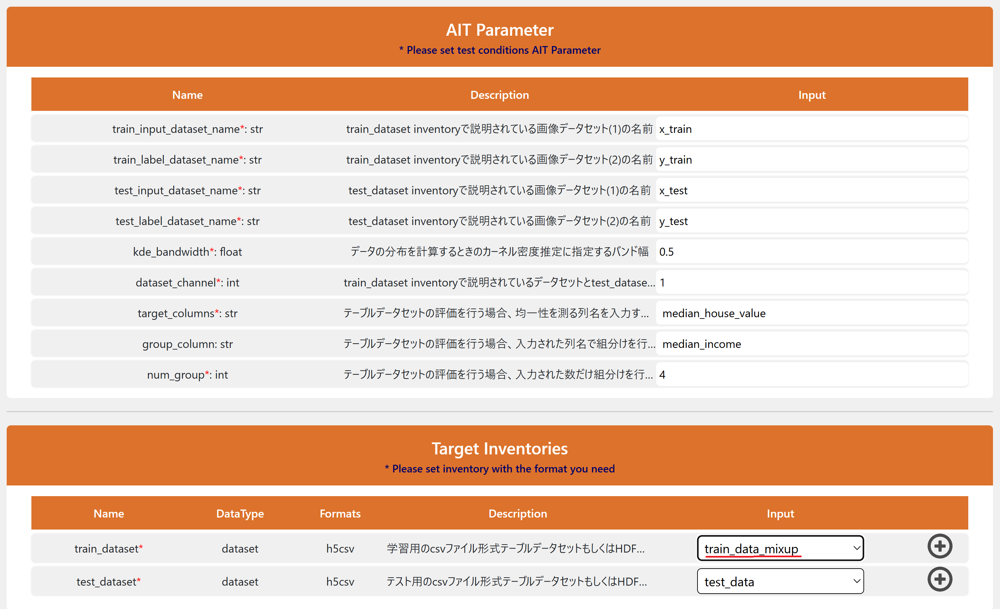

作成後、テストを実行します。実行を完了したら、詳細を確認しましょう。    
データ拡張する前と訓練データのTPCoverageの変化曲線はあまり変わらないように見えます。

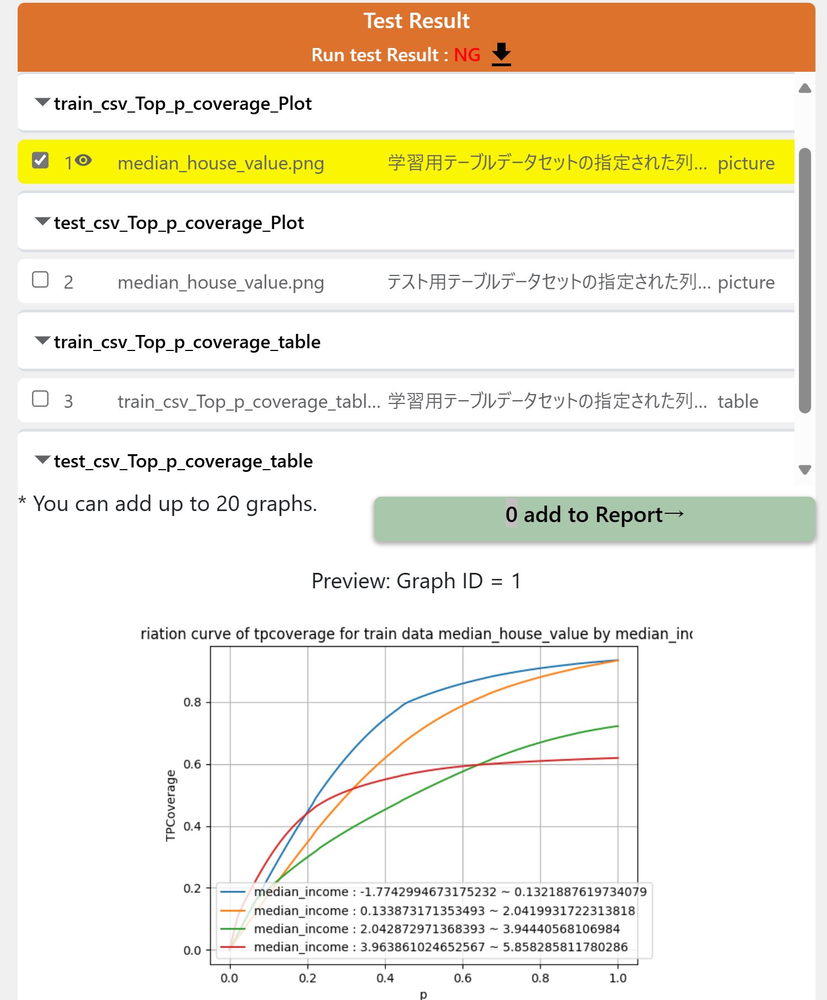

それぞれの曲線のAUCを確認してみましょう。
データ拡張する前よりも少し向上していることが確認できます。

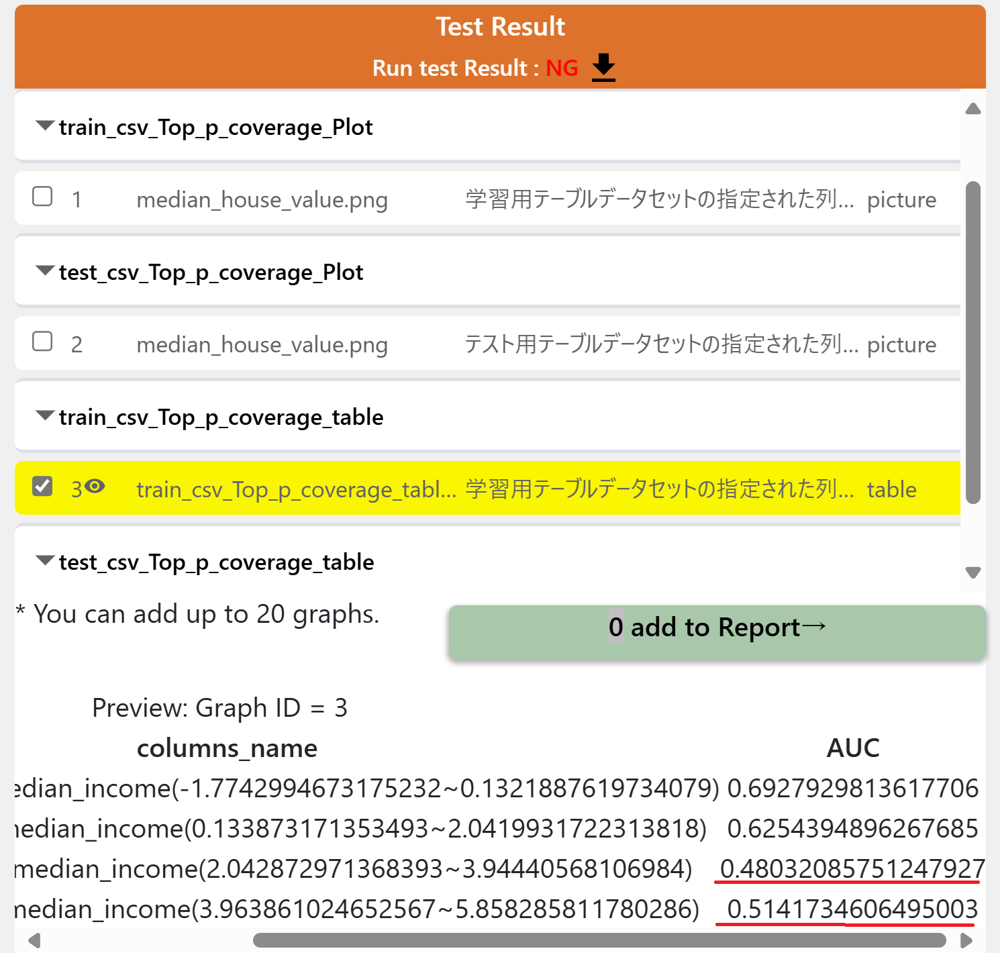

品質見解に記載をします。

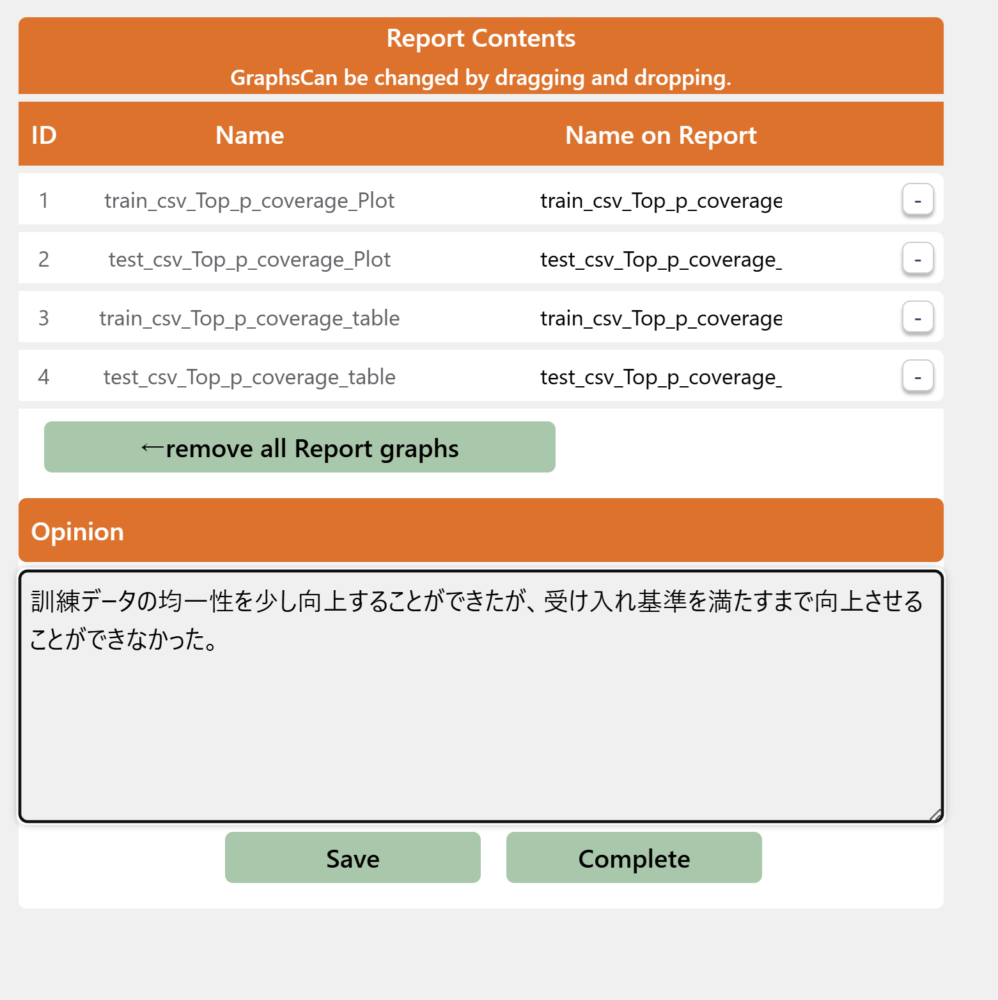

#### 4.1.2.Cutmixを使ったデータの評価

こちらも同様に3.5.3.節で使ったテストをコピーして今回のテスト仕様を登録します。
名前を以前のものと違いが分かるように設定します。また、今回は拡張した訓練データの評価をしたいので、train_csv_Topcoverage_AUCにのみチェックを入れます。

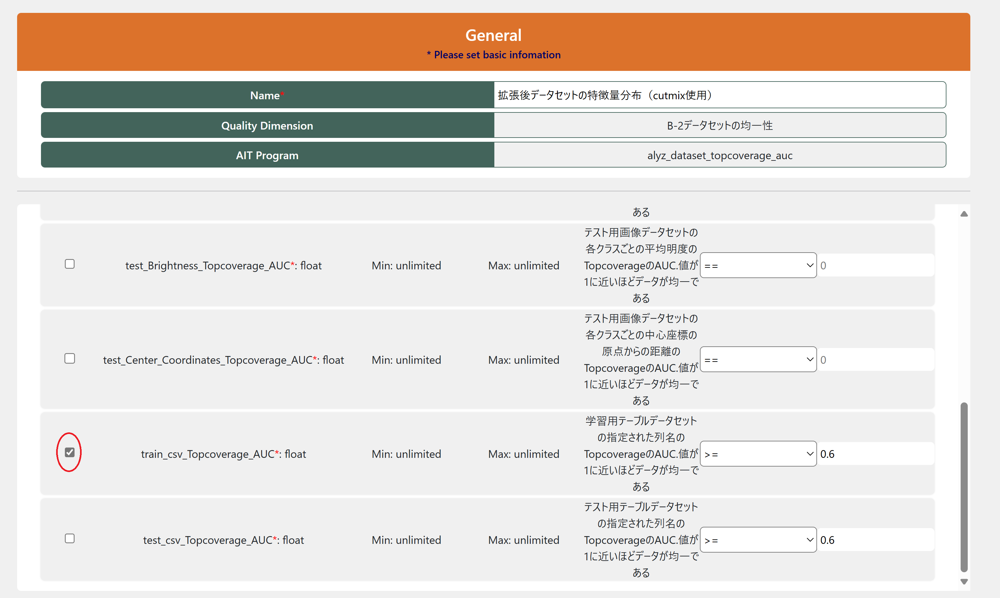

先ほど登録したデータを選択し、Createを押下します。

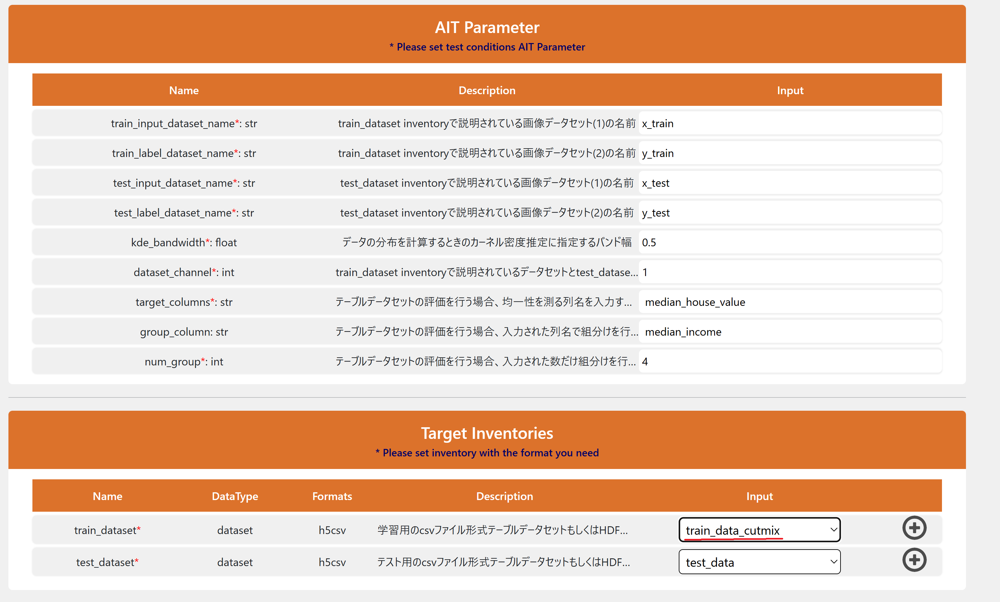

作成後、テストを実行します。実行を完了したら、詳細を確認しましょう。
訓練データのmedian_incomeが約2以上の2組のTPCoverageの変化曲線はデータ拡張する前と比べて悪い結果になっています。

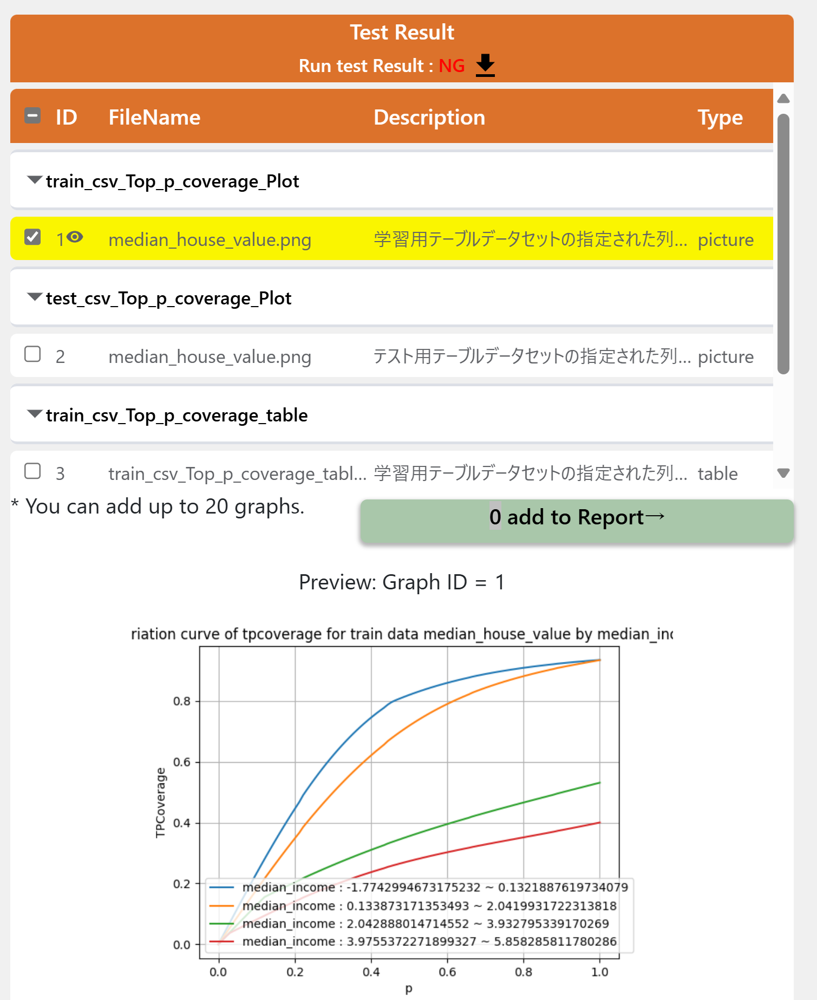

それぞれの曲線のAUCを確認してみましょう。 データ拡張する前よりも値が小さくなっていることが確認できます。

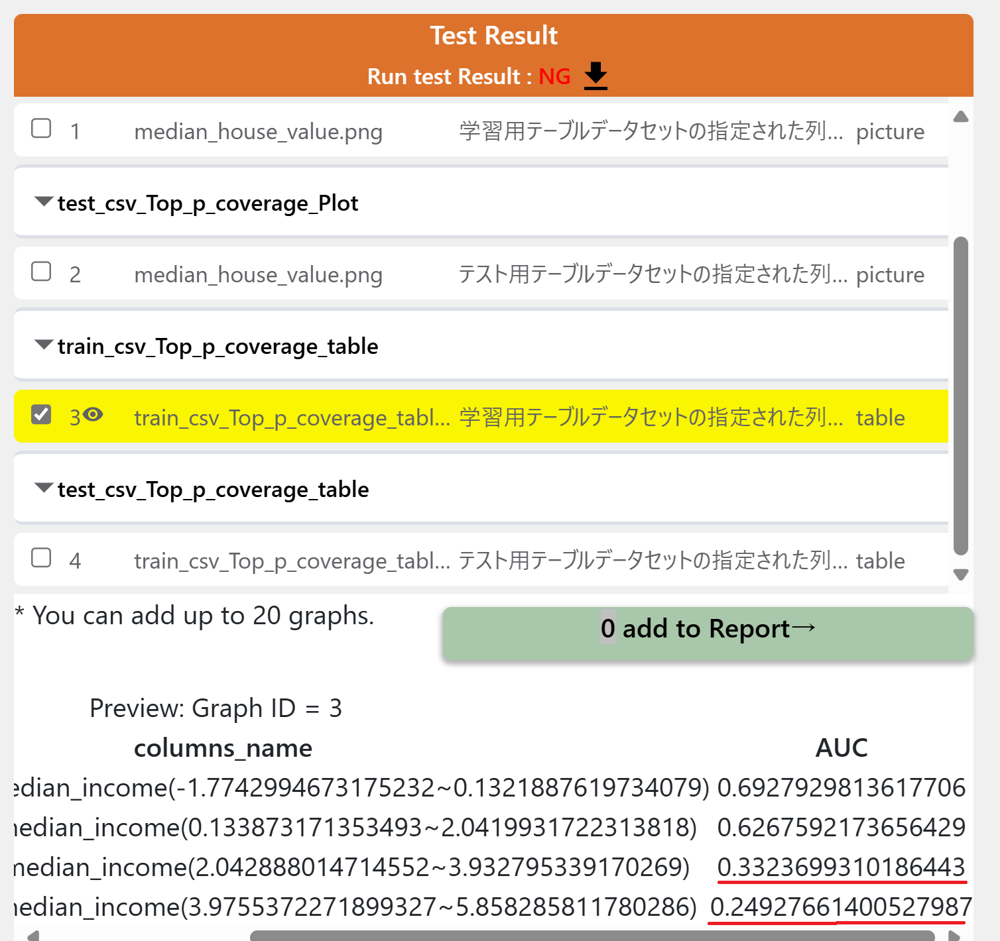

品質見解に記載をします。

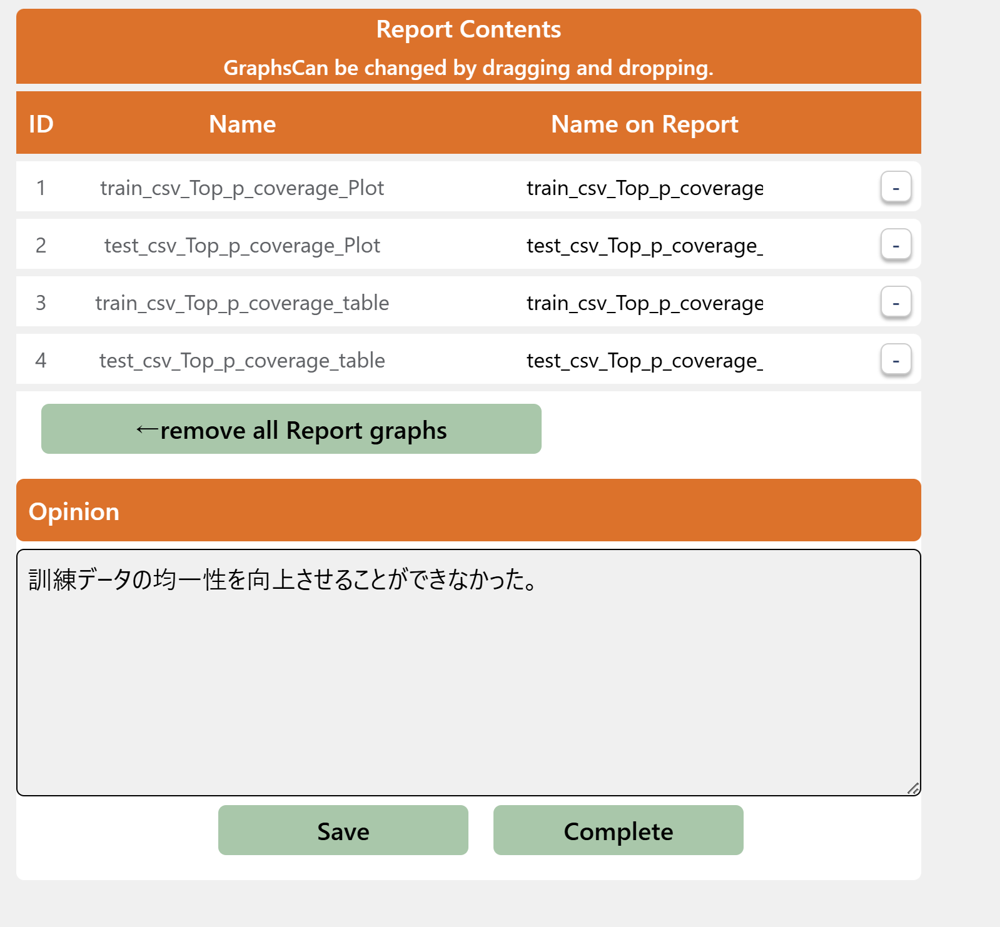

#### 4.1.3.GMMを使ったデータの評価

こちらも同様に3.5.3.節で使ったテストをコピーして今回のテスト仕様を登録します。
名前を以前のものと違いが分かるように設定します。また、今回は拡張した訓練データの評価をしたいので、train_csv_Topcoverage_AUCにのみチェックを入れます。

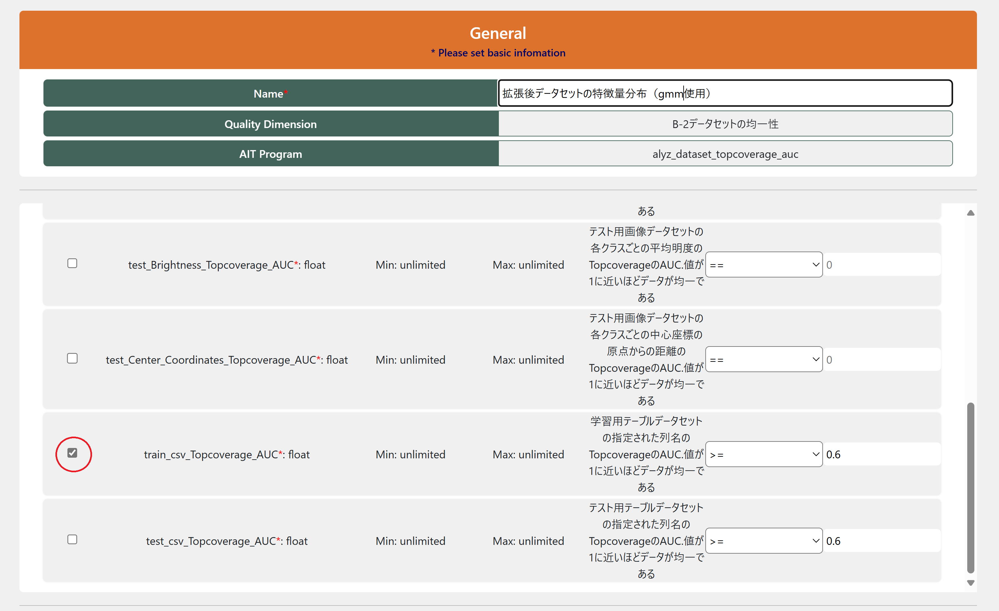

先ほど登録したデータを選択し、Createを押下します。

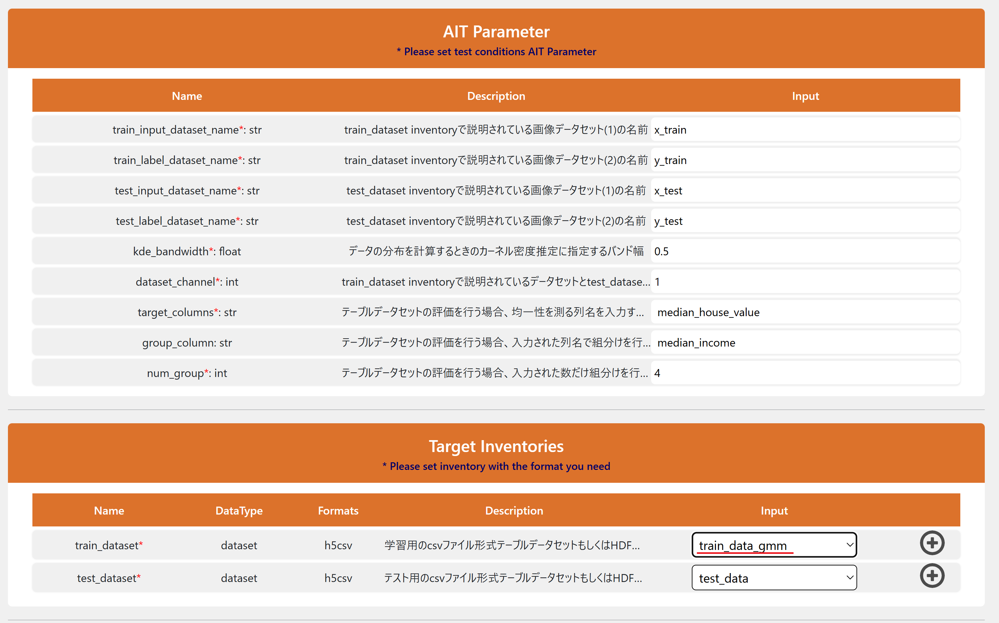

作成後、テストを実行します。実行を完了したら、詳細を確認しましょう。
データを拡張したことで、median_incomeの組分けが異なっていますが、すべての組の変化曲線はよい結果になっていることが確認できます。

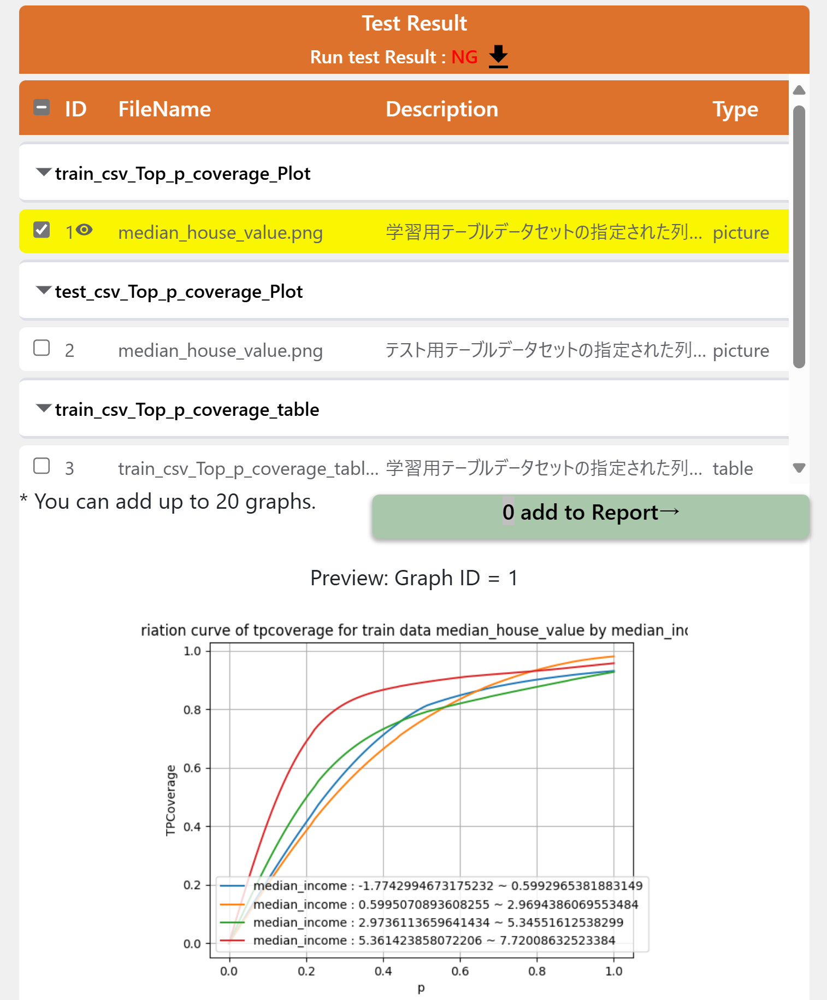

それぞれの曲線のAUCを確認してみましょう。 すべての組で受け入れ基準を満たしていることが確認できます。

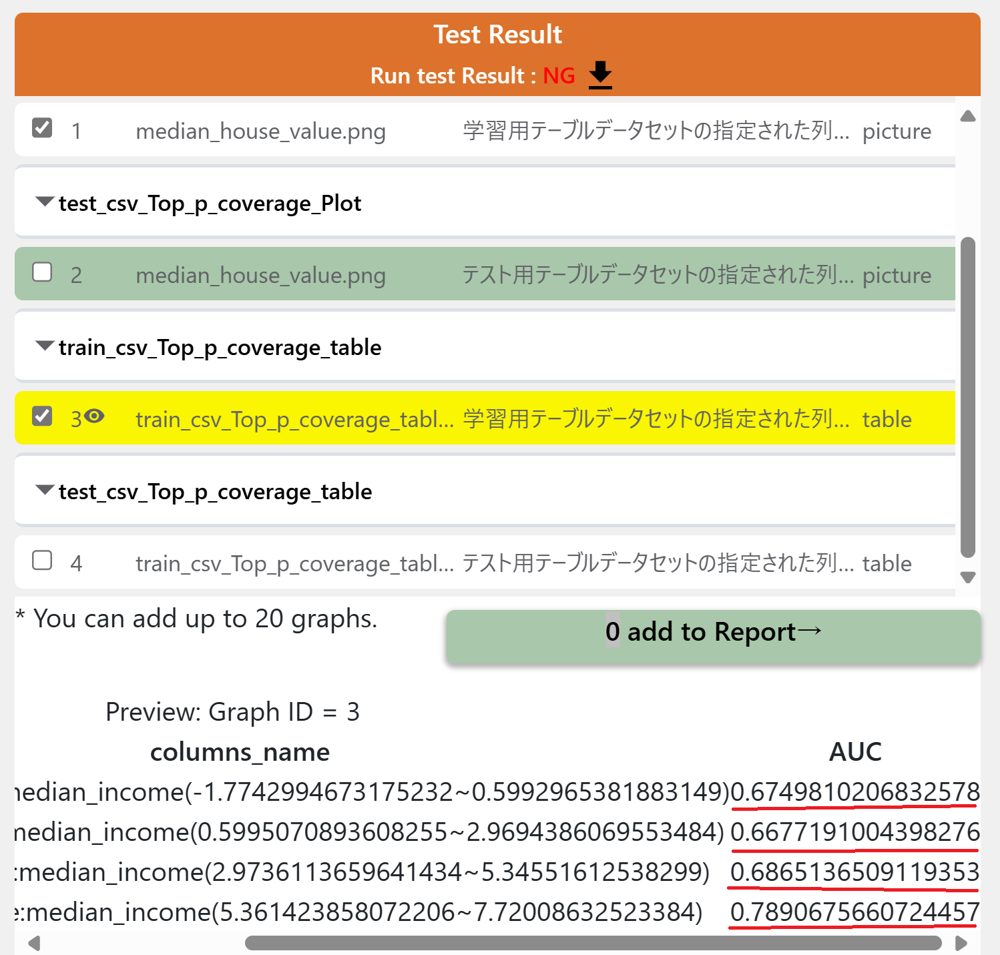


GMMを使用したデータ拡張が良い結果が得られたので、このデータを使った新しいモデルを構築します。品質見解に記載をします。

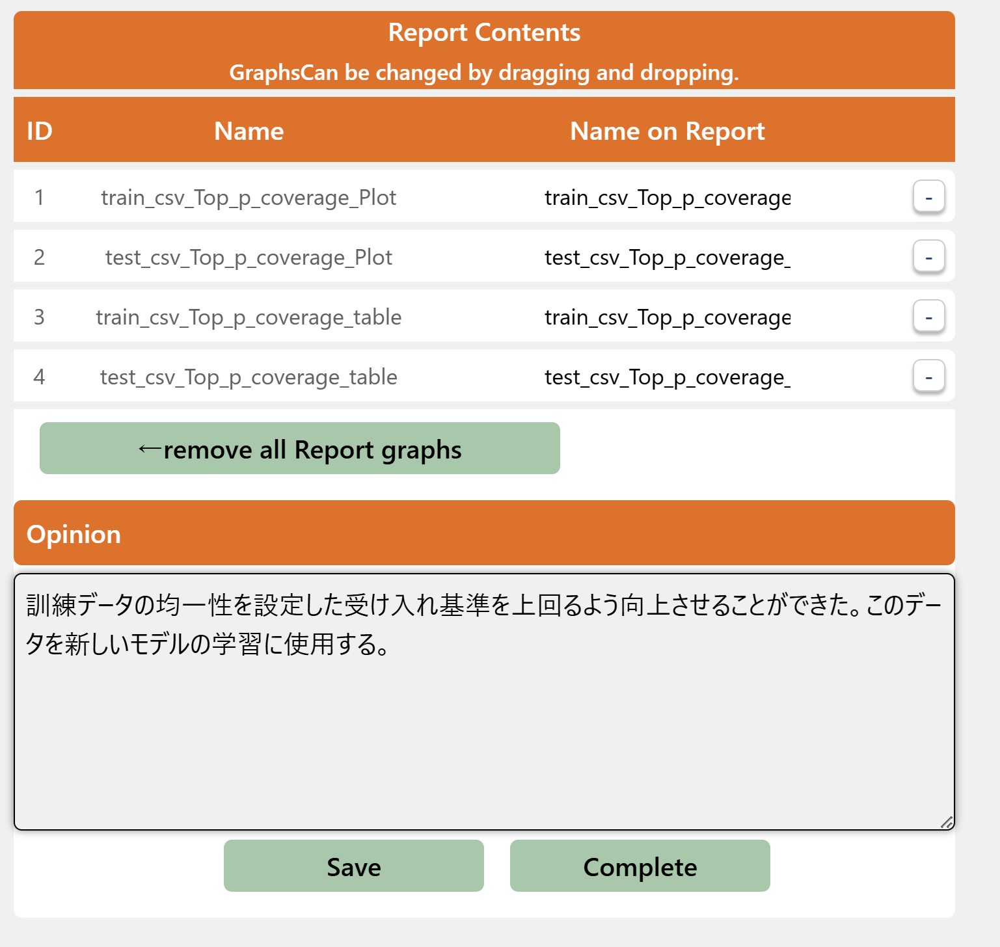

## 5.品質評価を踏まえたモデルの評価
4節でGMMを使用したデータ拡張が有効であることがわかったので、GMMで拡張したデータを使ったモデルを準備してもう一度モデルの精度とロバスト性の評価を行います。    
モデルに関しては8章で説明・配布します。

### 5.1.モデルの精度
#### 5.1.1.モデルの登録
最初に3.4.1.節と同様にテスト対象資産を登録を行います。

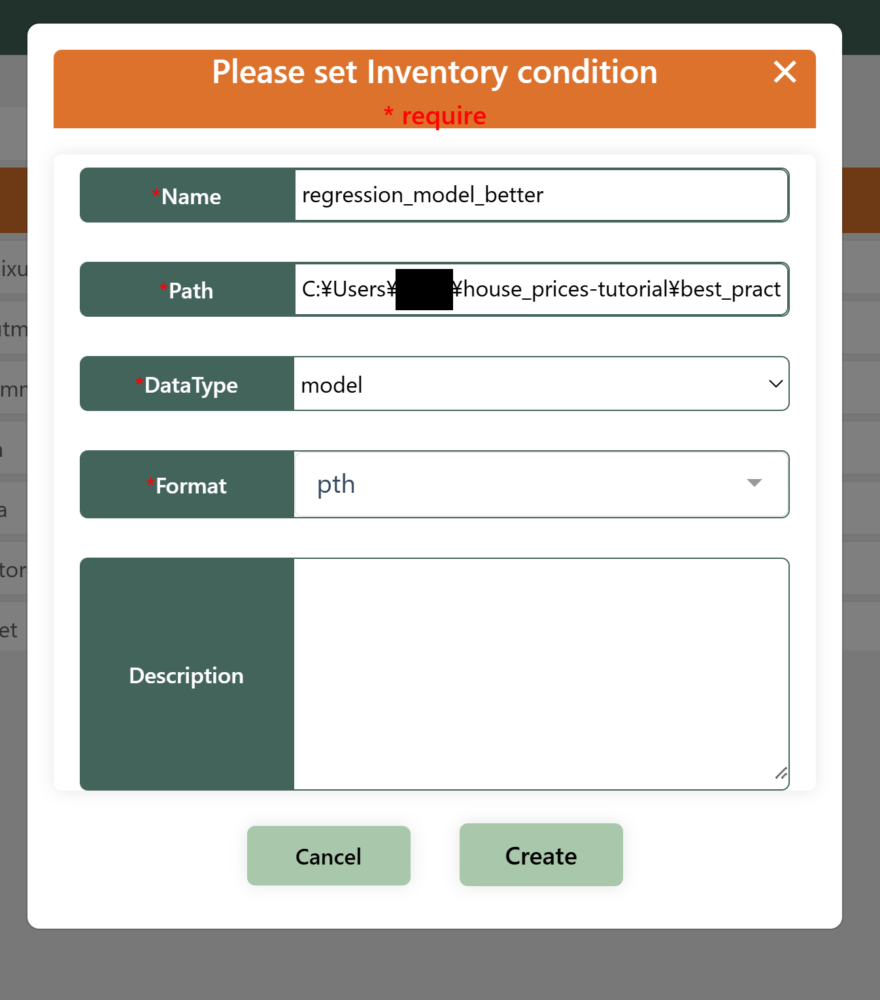


#### 5.1.2テスト仕様(Test Description)の登録

3.4.2節で登録したモデルの精度のテスト仕様と同様の設定が多いためこちらをコピーして今回のテスト仕様を登録します。    
Edit Optionの一番左のアイコンを押下します。

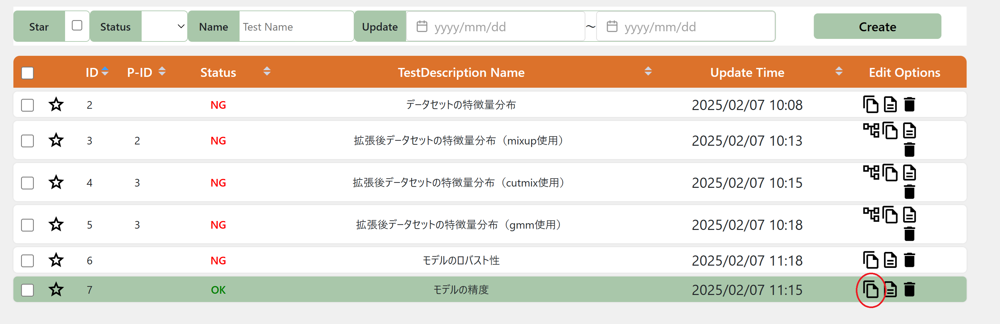

名前を以前のものと違いが分かるように今回は設定します。

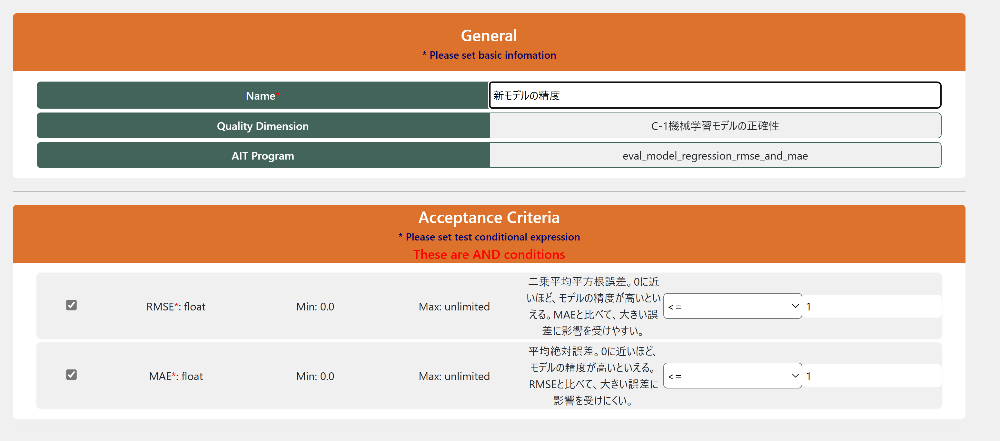

先ほど登録したモデルを選択し、Createを押下します。

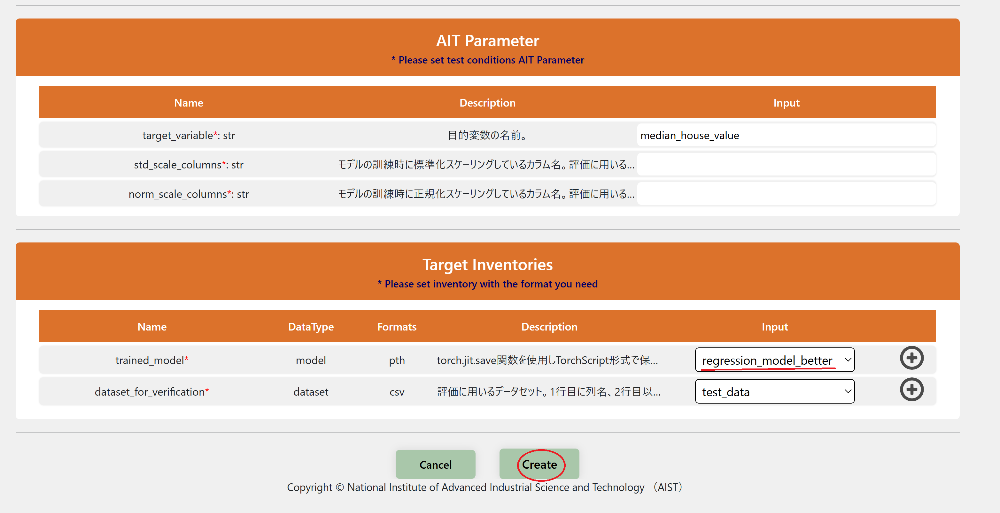

#### 5.1.3.実行と評価確認
MLコンポ―ネントのテスト仕様画面に遷移し、先ほど設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。

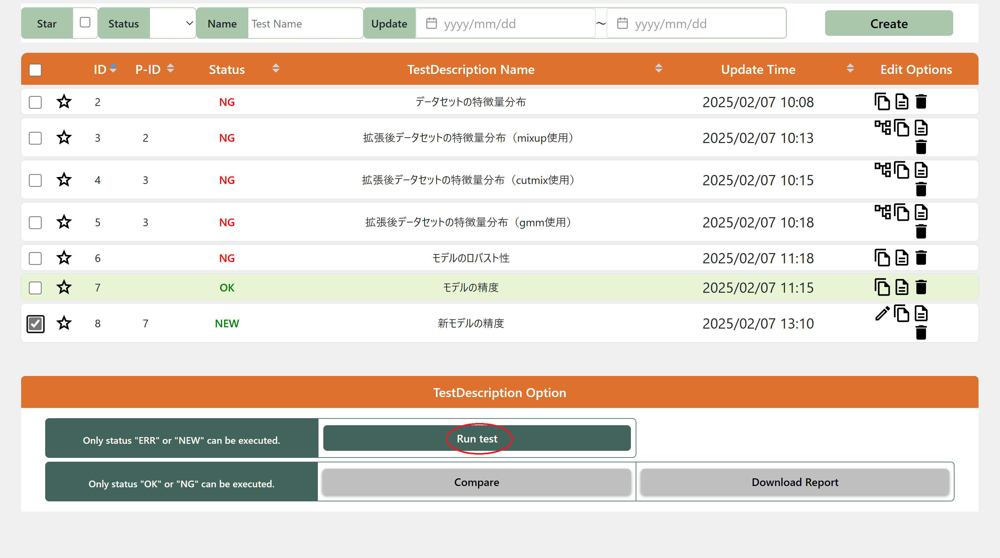

実行を完了したら、詳細を確認しましょう。    
前回のモデルに比べて、精度があまり変わっていません。しかし、均一性を向上させたデータで学習しているので、モデルの一般化能力は向上していると考えられる。

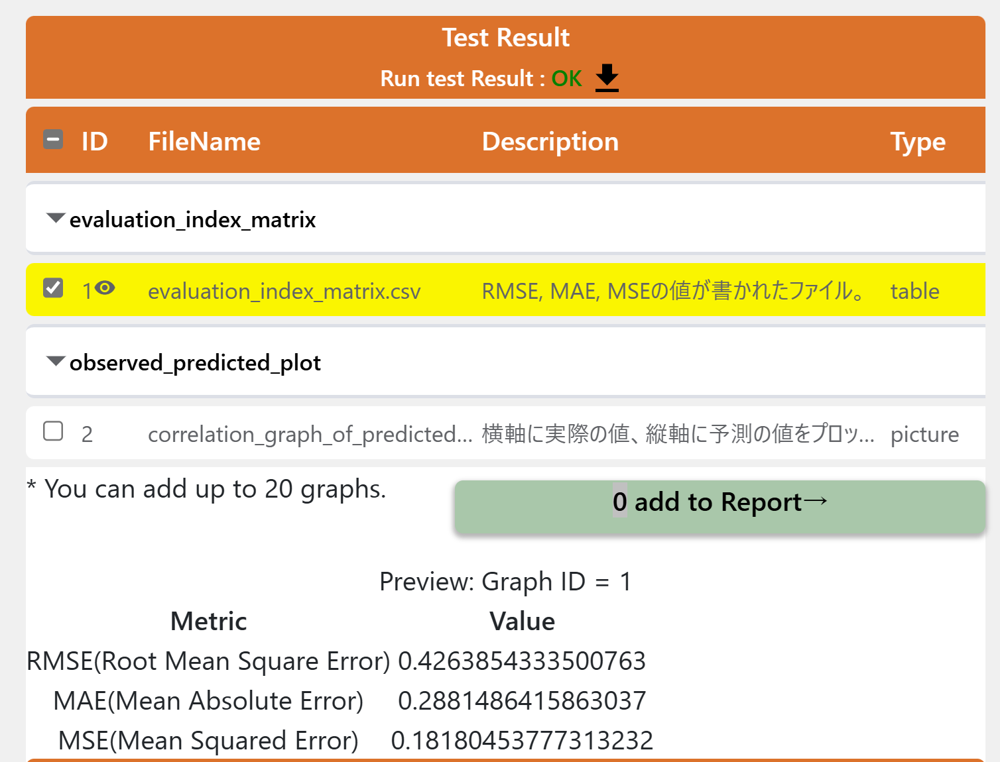

観測値と予測値の相関グラフも出力されますので参考に見ておきましょう。

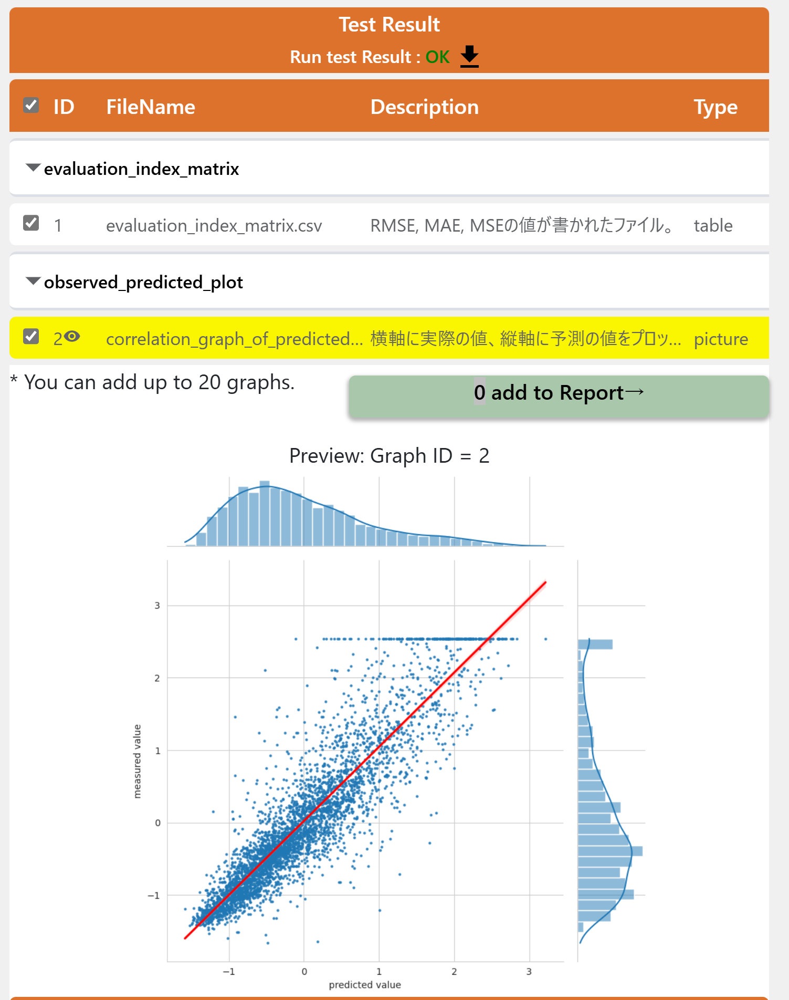

品質見解に記載をします。

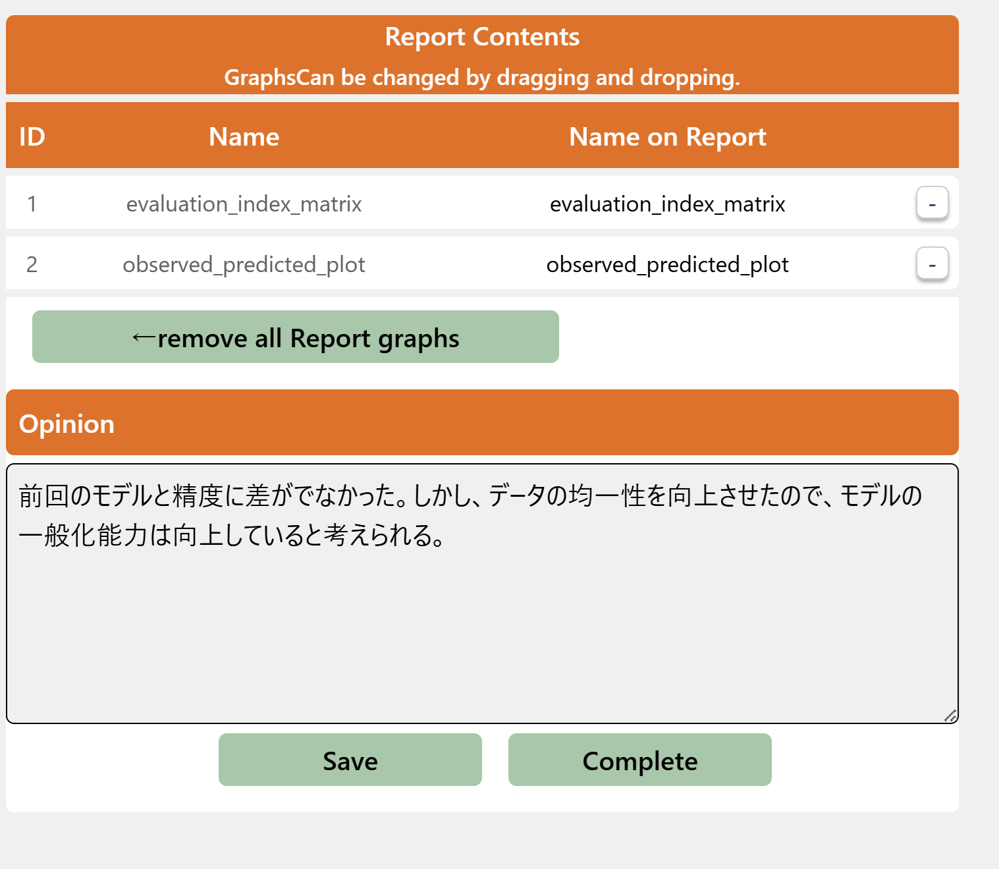

### 5.2.モデルのロバスト性

#### 5.2.1.テスト仕様(Test Description)の登録

3.4.3.節で登録したモデルのロバスト性のテスト仕様と同様の設定が多いためこちらをコピーして今回のテスト仕様を登録します。    
Edit Optionの一番左のアイコンを押下します。

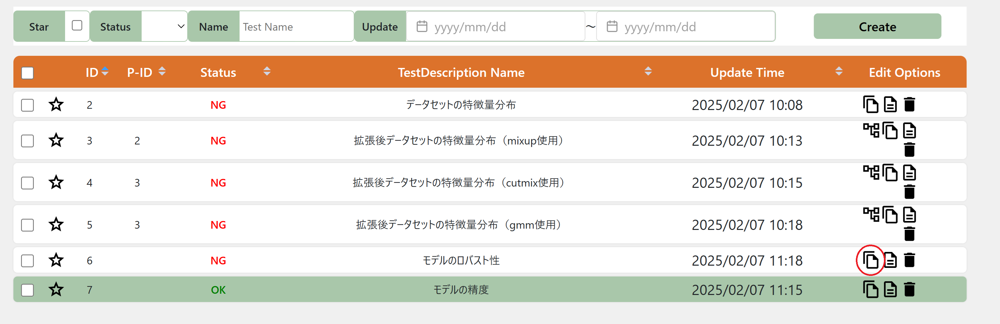

名前を以前のものと違いが分かるように今回は設定します。

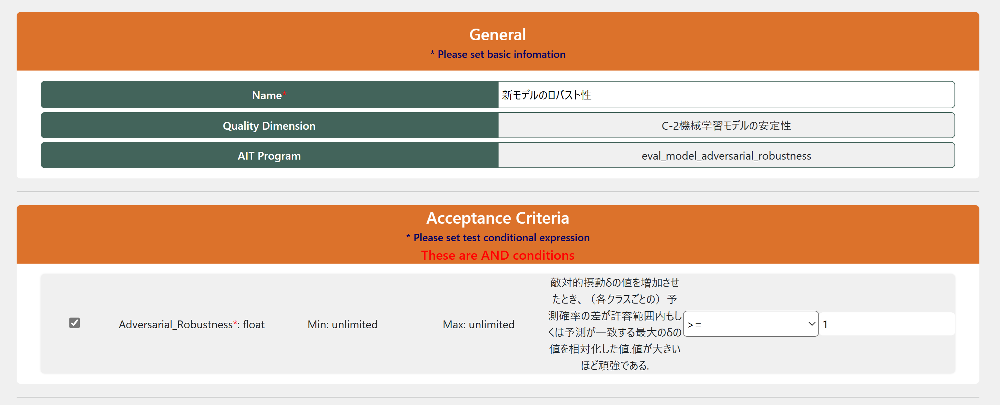

先ほど登録したモデルを選択し、Createを押下します。

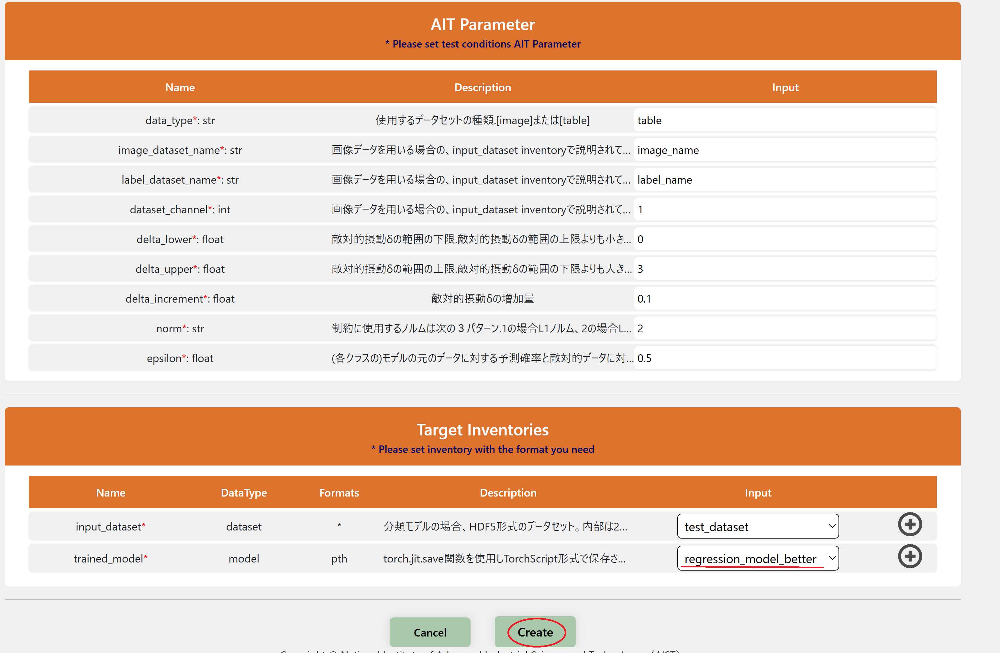

#### 5.2.2.実行と評価確認
MLコンポ―ネントのテスト仕様画面に遷移し、先ほど設定したテスト仕様にチェックを入れて、`Run Test`を押下してください。

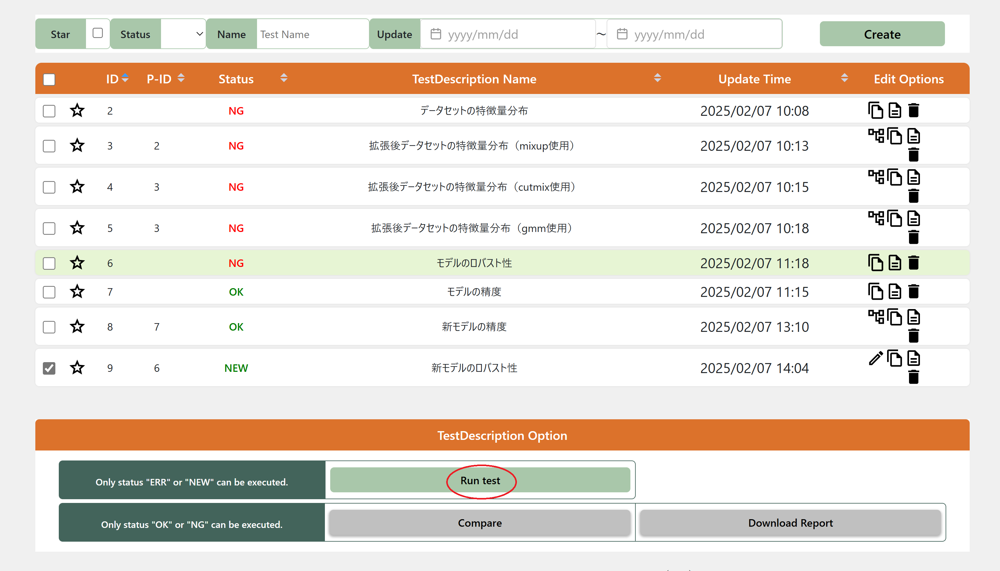

実行を完了したら、詳細を確認しましょう。    
前回のモデルに比べて、敵対的ロバスト性はあまり変わっていません。均一性を向上させたデータで学習しても、敵対的ロバスト性を向上させることができないとわかります。

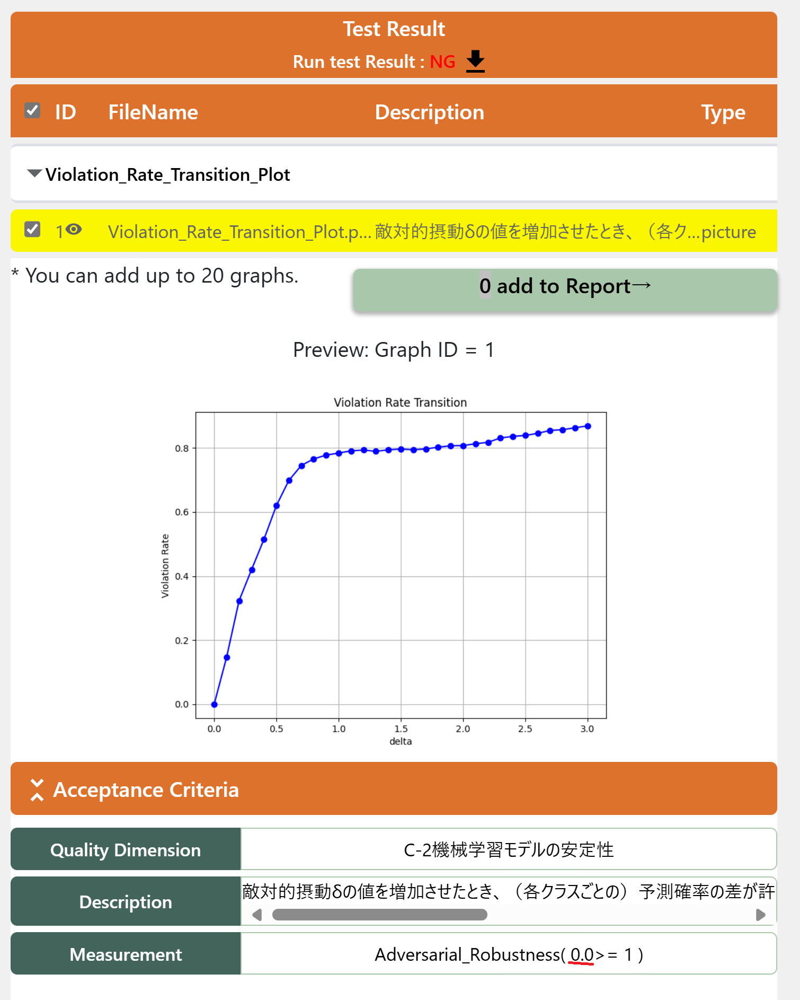

品質見解に記載をします。

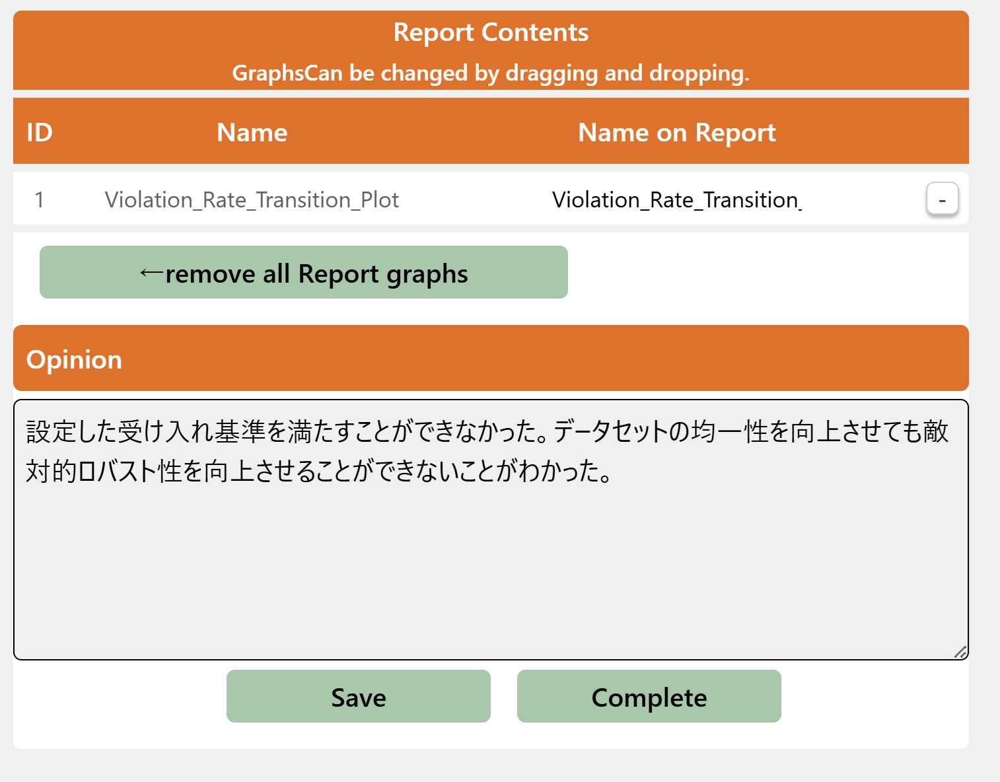

### 5.3.品質レポートの作成

テストが実行できましたので、実行したすべてのテストの結果をまとめた品質レポートを作成します。 前の画面に戻り、Download Reportボタンを押下してください。

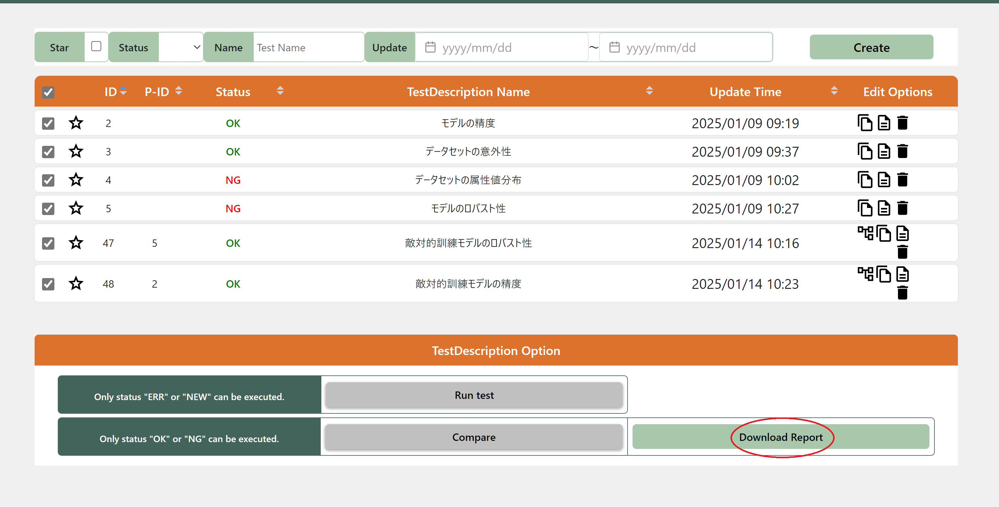

レポート生成時に、ガイドライン・標準にあわせて体系的に結果出力を行いますので、テンプレートを選んでください。 ここでは産総研AI品質マネジメントガイドライン（AIQMガイドライン）のテンプレートを選びます。

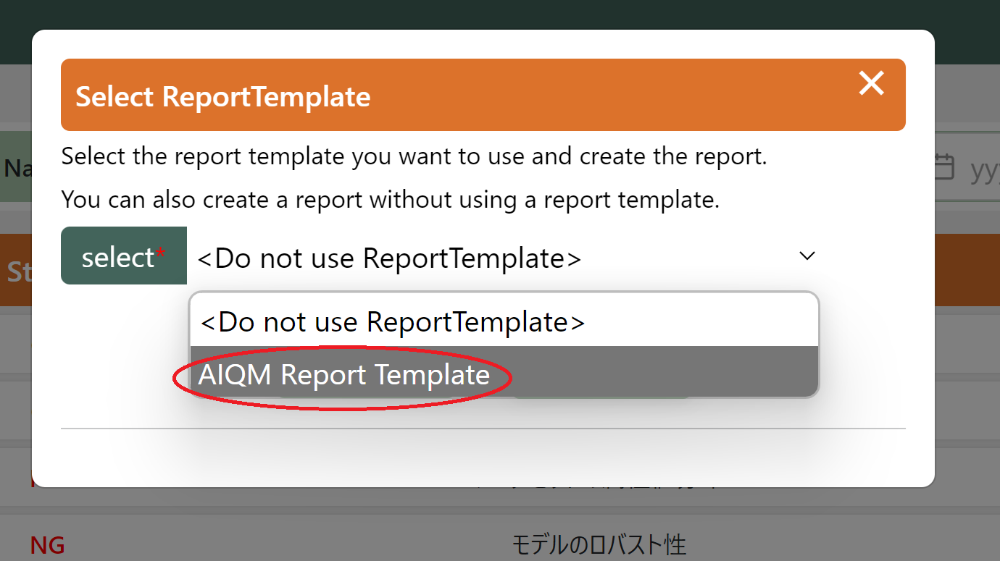

プレビューから生成予定のレポートを閲覧できます。 ページを送っていくと、2.9節、2.11節、2.12節にてそれぞれB-2、 C-1、C-2の評価結果が出力されています。 受け入れ基準を通過したことを表す pass もしくは受け入れ基準を通過したことを表す failure が表示され、入力した見解も表示されています。 これにより、後からどの品質特性に対してどのような評価が行われ、どのような判断があったかを追跡することができます。

| 節 | 判定結果 | 補助資料 |
|-------------------------|-------------------------|-------------------------|
| 2.9 | 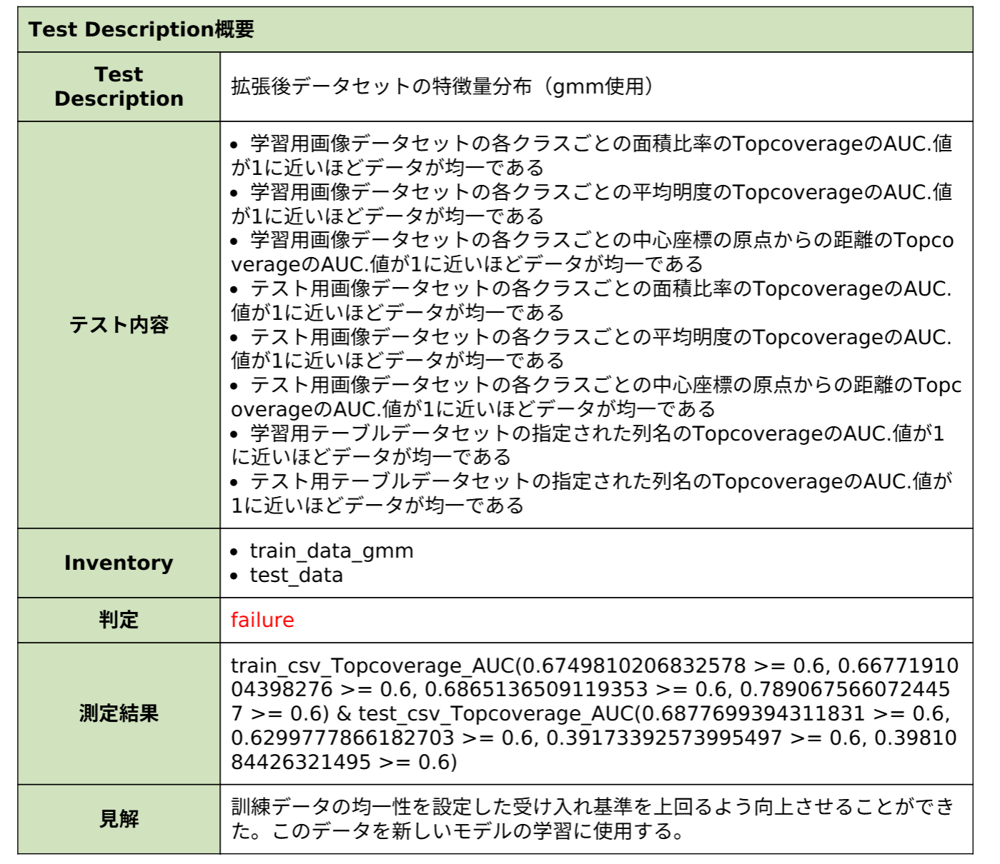 | 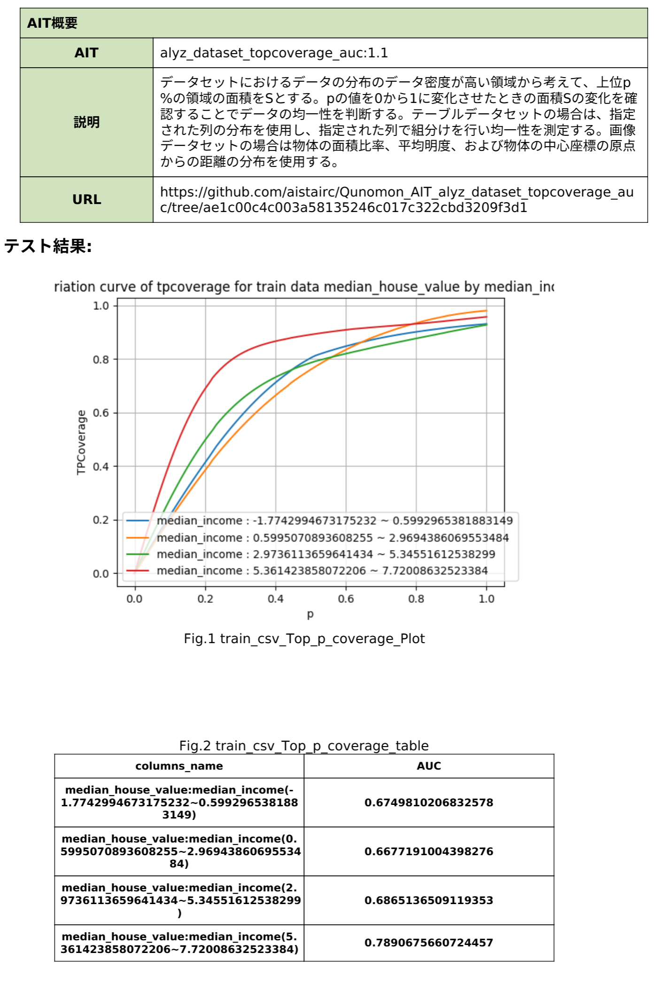 |
| 2.11 | 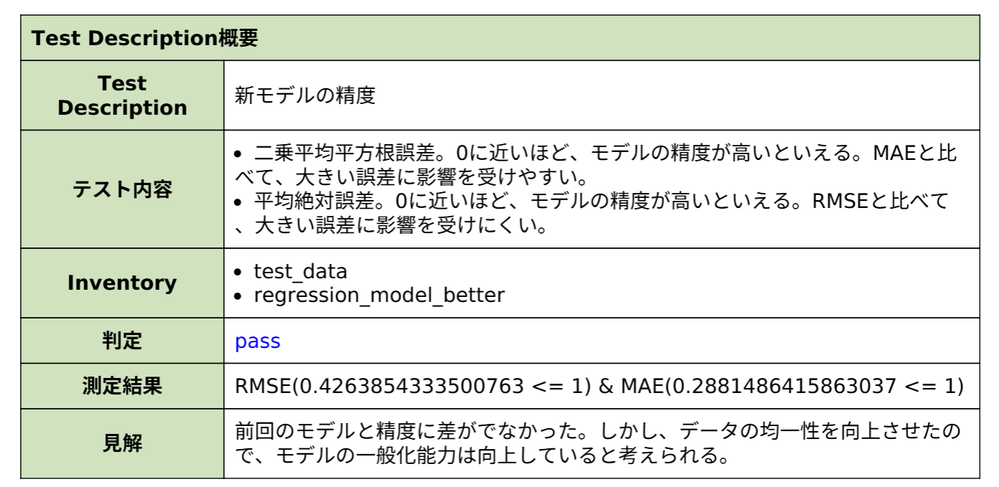 | 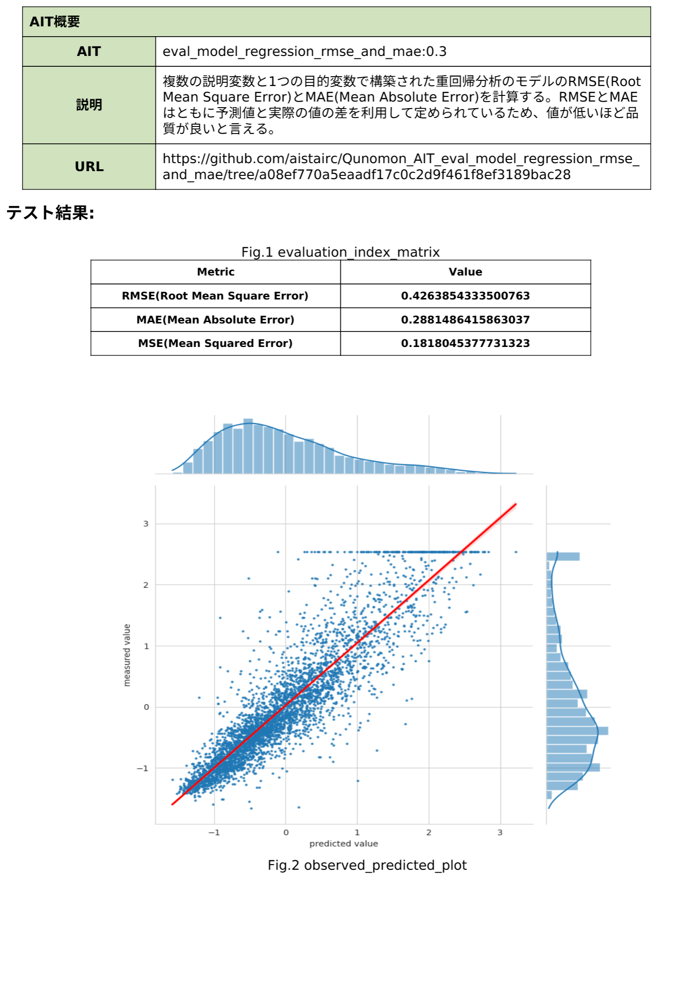 |
| 2.12 | 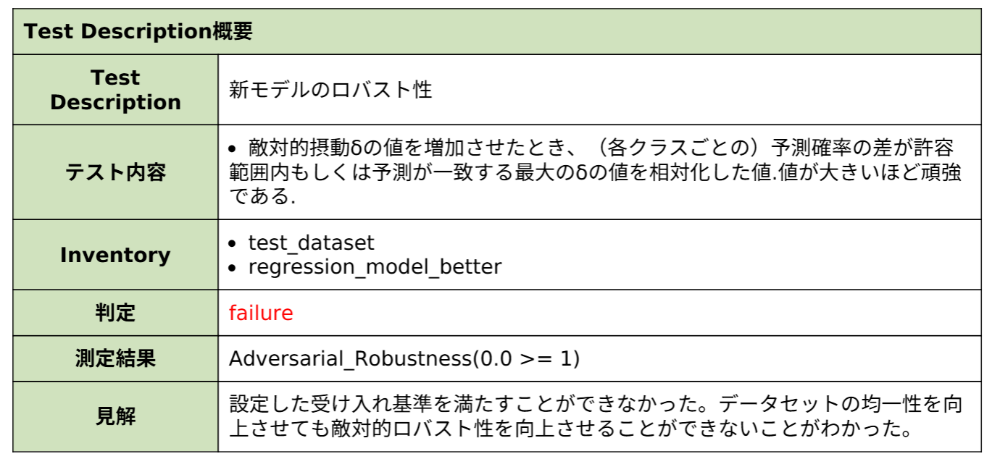 | 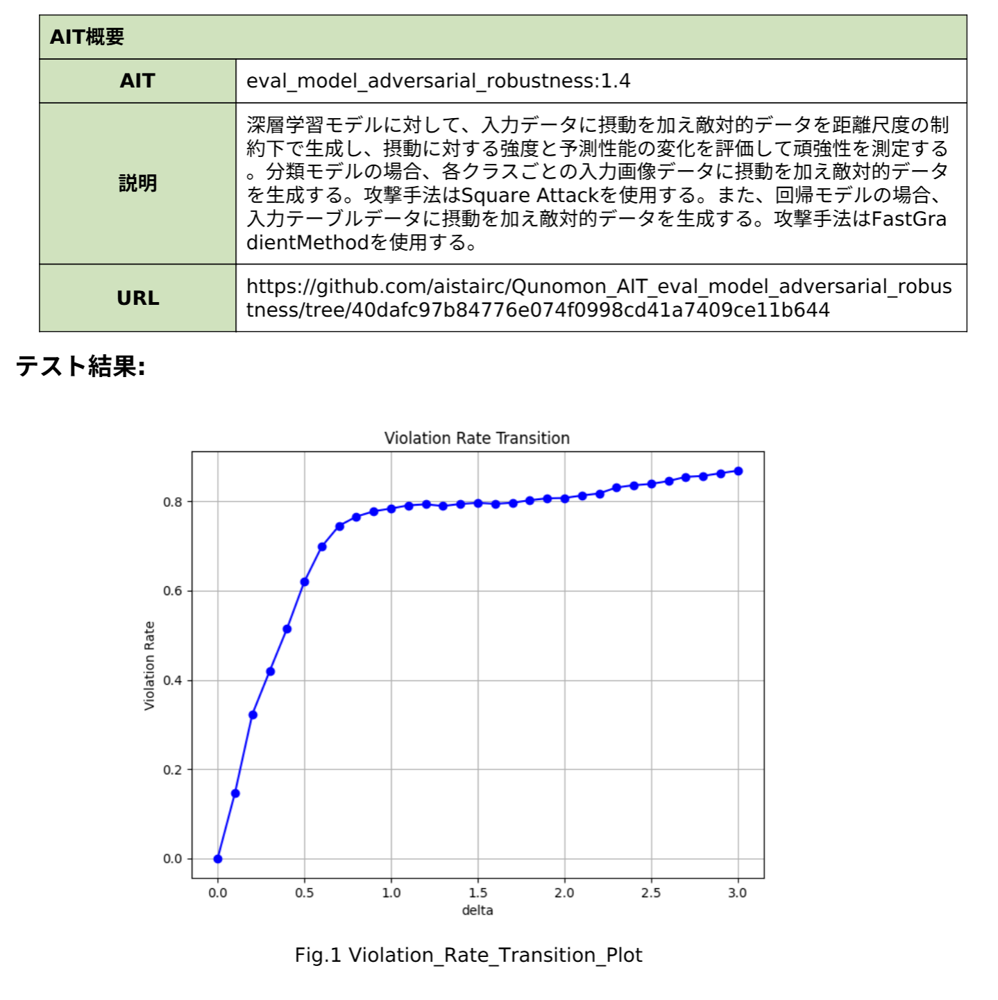 |

最後に画面左側よりレポートを生成しましょう。PDF形式でダウンロードされ、後から参照できるようになります。

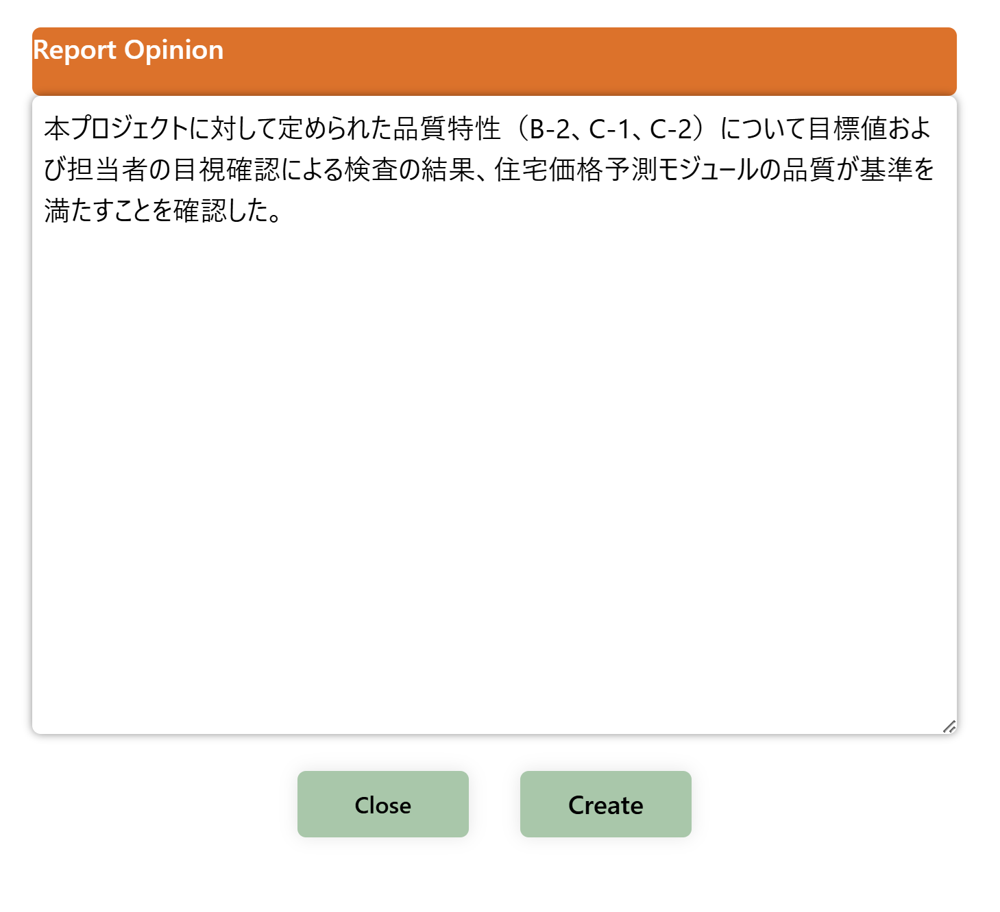

----------------------------------------------------------------------------------------
# 第二部 機械学習コンポーネントの準備方法

-----------------------------------------------------------------------------------------
## 6.データセット準備
 - シナリオは、kaggleのCalifornia Housing Pricesデータセットを対象としたものです。California Housing Pricesデータセットとは，1990年のアメリカ合衆国国勢調査に基づく、カリフォルニア州内の住宅価格に関連するデータを含むデータセットです。主に回帰タスクで使用され、カリフォルニア州の各地区の住宅価格（中央値）を予測するために利用されます。
     - 出典
         - kaggle,"California Housing Prices",https://www.kaggle.com/datasets/camnugent/california-housing-prices
     - 本データセットは、[CC0 1.0 UNIVERSAL(CC0 1.0) Public Domain Dedication](https://creativecommons.org/publicdomain/zero/1.0/) のもとで公開されています。
 - 以降、本節ではこちらのデータを今回の機械学習シナリオおよび評価に適した形式へと適宜整理します。

#### 6.1.データセットの配置
California Housing Pricesデータセットを加工し、下記のディレクトリ構造となるようにresources直下に配置しました。
- best_practice_3/
    - notebooks/
        - notebook.ipynb
    - resources/
        - house_prices/
            - housing.csv
            - standardization_housing.csv
            - train_data.csv
            - test_data.csv
            - mixup_train_housing.csv
            - cutmix_train_housing.csv
            - gmm_train_housing.csv


### 6.2 データセットのダウンロードと加工方法
#### 6.2.1 Qunomonでの評価とモデルの学習に使用する前処理済データセット（CSV形式）の生成

本チュートリアルで扱うCalifornia Housing Pricesデータセットは欠損値があるため、ランダムフォレストを使用し補完しました。
ランダムフォレストを使用するために、まずカテゴリカル変数である列「ocean_procimity」に対してone-hot-encodingを行いました。
その後モデルの学習を安定させるためと学習の収束を速めるために、標準化スケーリングしました。
そして、データセットをCSV形式で保存します。    
まずは、どの列にどのくらいの欠損があるか確認します。

In [1]:
import pandas as pd
#データの読み込み
data = pd.read_csv("./../resources/house_prices/housing.csv")
#欠損値の確認
missing_values = data.isnull().sum()
print(missing_values)


longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64


列「total_bedrooms」に207件の欠損があることが分かりました。    
カテゴリカル変数である列「ocean_procimity」に対してone-hot-encodingを行い、ランダムフォレストで欠損値を補完します。    
そして、ターゲット変数と特徴量（列「ocean_procimity」以外）を標準化スケーリングし、訓練用データとテスト用データに分けます。



In [2]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
#データの読み込み
data = pd.read_csv("./../resources/house_prices/housing.csv")
#カテゴリカル変数に対して、one-hot-encodingを行う
data= pd.get_dummies(data,columns=['ocean_proximity'],dtype='int')
#特徴量とターゲットを分ける
normal_data = data[data['total_bedrooms'].notnull()] #欠損値がないデータ
missing_data = data[data['total_bedrooms'].isnull()] #欠損値があるデータ
#特徴量とターゲットを定義
x_normal = normal_data.drop(columns=['total_bedrooms'])
y_normal = normal_data['total_bedrooms']
x_missing = missing_data.drop(columns=['total_bedrooms'])
#ランダムフォレストモデルを訓練
rf = RandomForestRegressor(random_state=42)
rf.fit(x_normal,y_normal)
#欠損値を予測
missing_values_pre = rf.predict(x_missing)
#欠損値を補完
data.loc[data['total_bedrooms'].isnull(),'total_bedrooms'] = missing_values_pre

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
#標準化する列
numeric_columns=['longitude','latitude','housing_median_age','total_rooms','total_bedrooms','population','households','median_income','median_house_value']
#標準化
scaler = StandardScaler()
data[numeric_columns] = scaler.fit_transform(data[numeric_columns])
#目的変数を最後の列に移動する
target_column = "median_house_value"
target_data = data.pop(target_column)
data.insert(len(data.columns),target_column,target_data)
#訓練用データとテスト用データに分割
train_data,test_data = train_test_split(data,test_size=0.2,random_state=42)
#データの保存
data.to_csv('./../resources/house_prices/standardization_housing.csv',index=False)
train_data.to_csv('./../resources/house_prices/train_housing.csv',index=False)
test_data.to_csv('./../resources/house_prices/test_housing.csv',index=False)
print('データを保存しました。')


データを保存しました。


### 6.3. データセットの確認    
3.4.2.節の手順4でのAIT alyz_dataset_topcoverage_aucのパラメータ設定の決定に関して、データセットの相関行列を確認します。
以下のコードを実行して、確認するとmedian_incomeとmedian_house_valueの相関が0.69となっていることが分かります。

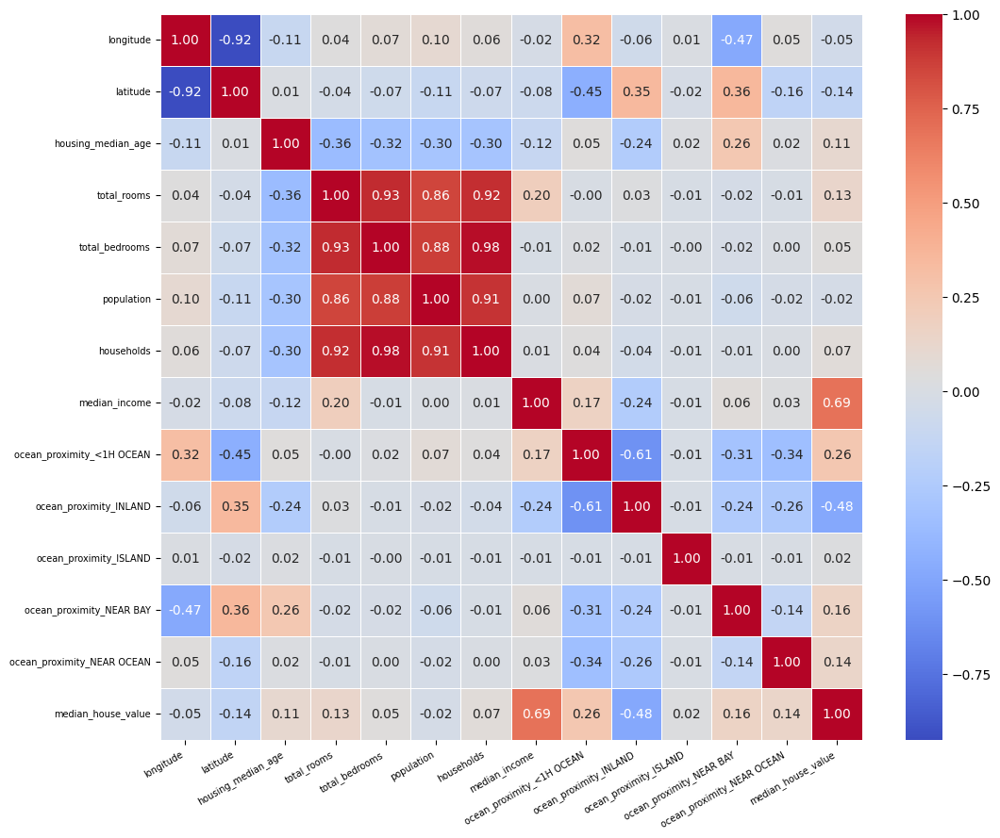

In [3]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

data = pd.read_csv('./../resources/house_prices/standardization_housing.csv')
correlation_matrix=data.corr()
plt.figure(figsize=(12,10))
ax=sns.heatmap(correlation_matrix,annot=True,cmap="coolwarm",fmt=".2f",linewidths=0.5)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30,ha="right",fontsize=7)
ax.set_yticklabels(ax.get_yticklabels(),fontsize=7)
plt.show()

### 6.4.データ拡張
#### 6.4.1.Mixupを使ったデータ拡張
Mixupは2つのデータサンプルを線形補完することで新しい学習データを生成する方法です。    
以下のコードを実行してデータ拡張を行います。

In [4]:
import numpy as np
import pandas as pd

def mixup(feature_num_all,feature_cat_all,target_all,feature_high,target_high,alpha,num_samples,num_col_list,threshold):
    """
    2つのデータを線形補完して新しいデータを生成する関数
    """
    mixed_feature_num,mixed_feature_cat,mixed_y = [],[],[]
    for _ in range(num_samples):
        #2つのサンプルをランダムに選択
        idx1 = np.random.choice(len(feature_high))
        idx2 = np.random.choice(len(feature_num_all))

        #lambdaをベータ分布からサンプリング
        lam = np.random.beta(alpha,alpha)
        #数値特徴量の線形補完
        feature_new_num = lam * feature_high[idx1] + (1-lam) * feature_num_all[idx2]
        #目的変数の線形補完
        target_new = lam * target_high[idx1] + (1-lam) * target_all[idx2]
        #カテゴリ変数はランダムに1だけエンコードを選択
        feature_new_cat = np.zeros_like(feature_cat_all[idx1])
        random_idx = np.random.randint(0,len(feature_cat_all[idx1]))
        feature_new_cat[random_idx]=1

        if feature_new_num[num_col_list.index("median_income")] >threshold:
            mixed_feature_num.append(feature_new_num)
            mixed_feature_cat.append(feature_new_cat)
            mixed_y.append(target_new)

    return np.array(mixed_feature_num), np.array(mixed_feature_cat), np.array(mixed_y)



data_path="./../resources/house_prices/train_housing.csv"
data = pd.read_csv(data_path)
target = "median_house_value"
feature_data = data.drop(columns=[target])
#特徴量の分割（数値型とカテゴリ変数）
numeric_columns = feature_data.select_dtypes(include=['float64']).columns
categorical_columns = feature_data.select_dtypes(include=['int64']).columns
num_col_list=list(numeric_columns)
cat_col_list=list(categorical_columns)

numeric_feature_all = feature_data[numeric_columns].values#数値特徴量
categorical_feature_all = feature_data[categorical_columns].values#カテゴリ変数（one-hot）
target_all = data[target].values#目的変数

#median_incomeが2以上のデータの取得
threshold1=2.0
data_high_income = data[data["median_income"]>threshold1]
feature_high = data_high_income[numeric_columns].values
target_high = data_high_income[target].values

#Mixupのパラメータ設定
alpha = 0.2
num_samples = 6000 #生成する新規データ数

#median_incomeが2以上のデータから１1つと全データから1つ選択して新しいデータの生成
feature_num_mix, feature_cat_mix, target_mix = mixup(numeric_feature_all,categorical_feature_all,target_all,feature_high,target_high,alpha,num_samples,num_col_list,threshold1)
#生成した新しいデータをデータフレームにする
df1_mixup_num = pd.DataFrame(feature_num_mix,columns=num_col_list)
df1_mixup_cat = pd.DataFrame(feature_cat_mix,columns=cat_col_list)
df1_mixup = pd.concat([df1_mixup_num,df1_mixup_cat],axis=1)
df1_mixup[target] =target_mix

#median_incomeが4以上のデータの取得
threshold2=4.0
data_high_income = data[data["median_income"]>threshold2]
feature_high = data_high_income[numeric_columns].values
target_high = data_high_income[target].values
#Mixupのパラメータ設定
alpha = 0.2
num_samples = 1000 #生成する新規データ数
#median_incomeが4以上のデータから1つと全データから1つ選択して新しいデータの生成
feature_num_mix, feature_cat_mix, target_mix = mixup(numeric_feature_all,categorical_feature_all,target_all,feature_high,target_high,alpha,num_samples,num_col_list,threshold2)
#生成した新しいデータをデータフレームにする
df2_mixup_num = pd.DataFrame(feature_num_mix,columns=num_col_list)
df2_mixup_cat = pd.DataFrame(feature_cat_mix,columns=cat_col_list)
df2_mixup = pd.concat([df2_mixup_num,df2_mixup_cat],axis=1)
df2_mixup[target] =target_mix
#生成した2つのデータフレームを結合する
df_mixup = pd.concat([df1_mixup,df2_mixup])

print(f"生成したデータの合計：{len(df_mixup)}")
#元のデータと生成したデータの結合
df_aug_mixup = pd.concat([data,df_mixup])
df_aug_mixup.to_csv("./../resources/house_prices/mixup_train_housing.csv",index=False)
print("データを保存しました。")



生成したデータの合計：3000
データを保存しました。


#### 6.4.2.Cutmixを使ったデータ拡張
Cutmixは本来画像データのために開発されたデータ拡張の手法ですがテーブルデータにも応用可能です。一部の特徴量を別のサンプルと入れ替えることで新しいデータを生成しました。手順としては、２つのデータサンプルをランダムに選択し、特徴量の一部をランダムな割合で置換、目的変数は２つのサンプルのいずれかを選択、カテゴリ変数はランダムに１つだけ１にしました。    
以下のコードを実行してデータ拡張を行います。

In [5]:
import numpy as np
import pandas as pd

def cutmix(feature_num_all,feature_cat_all,target_all,feature_high,target_high,cut_ratio,num_samples,num_col_list,threshold):
    """
    2つのデータをランダムに選択してcutmixを行い新しいデータを生成する関数
    """
    mixed_feature_num,mixed_feature_cat,mixed_y = [],[],[]
    for _ in range(num_samples):
        #2つのサンプルをランダムに選択
        idx1 = np.random.choice(len(feature_high))
        idx2 = np.random.choice(len(feature_num_all))

        #ランダムなマスクを作成
        mask = np.random.rand(len(feature_num_all[0])) < cut_ratio
        #数値特徴量を部分的にコピー
        feature_new_num = feature_high[idx1].copy()
        feature_new_num[mask]=feature_num_all[idx2][mask]
        #目的変数はランダムにどちらかを選択
        target_new = target_high[idx1] if np.random.rand() > 0.5 else target_all[idx2]
        #カテゴリ変数はランダムに1だけエンコードを選択
        feature_new_cat = np.zeros_like(feature_cat_all[idx1])
        random_idx = np.random.randint(0,len(feature_cat_all[idx1]))
        feature_new_cat[random_idx]=1

        if feature_new_num[num_col_list.index("median_income")] >threshold:
            mixed_feature_num.append(feature_new_num)
            mixed_feature_cat.append(feature_new_cat)
            mixed_y.append(target_new)

    return np.array(mixed_feature_num), np.array(mixed_feature_cat), np.array(mixed_y)
    
data_path="./../resources/house_prices/train_housing.csv"
data = pd.read_csv(data_path)
target = "median_house_value"
feature_data = data.drop(columns=[target])
#特徴量の分割（数値型とカテゴリ変数）
numeric_columns = feature_data.select_dtypes(include=['float64']).columns
categorical_columns = feature_data.select_dtypes(include=['int64']).columns
num_col_list=list(numeric_columns)
cat_col_list=list(categorical_columns)

numeric_feature_all = feature_data[numeric_columns].values#数値特徴量
categorical_feature_all = feature_data[categorical_columns].values#カテゴリ変数（one-hot）
target_all = data[target].values#目的変数

#median_incomeが2以上のデータの取得
threshold1=2.0
data_high_income = data[data["median_income"]>threshold1]
feature_high = data_high_income[numeric_columns].values
target_high = data_high_income[target].values

#Cutmixのパラメータ設定
cut_ratio = 0.5
num_samples = 6000 #生成する新規データ数
#median_incomeが2以上のデータから1つと全データから1つ選択して新しいデータの生成
feature_num_cutmix, feature_cat_cutmix, target_cutmix = cutmix(numeric_feature_all,categorical_feature_all,target_all,feature_high,target_high,cut_ratio,num_samples,num_col_list,threshold1)
#生成した新しいデータをデータフレームにする
df1_cutmifeature_num = pd.DataFrame(feature_num_cutmix,columns=num_col_list)
df1_cutmifeature_cat = pd.DataFrame(feature_cat_cutmix,columns=cat_col_list)
df1_cutmix = pd.concat([df1_cutmifeature_num,df1_cutmifeature_cat],axis=1)
df1_cutmix[target] =target_cutmix

#median_incomeが4以上のデータの取得
threshold2=4.0
data_high_income = data[data["median_income"]>threshold2]
feature_high = data_high_income[numeric_columns].values
target_high = data_high_income[target].values

#Cutmixのパラメータ設定
cut_ratio = 0.5
num_samples = 1000 #生成する新規データ数
#median_incomeが4以上のデータから1つと全データから1つ選択して新しいデータの生成
feature_num_cutmix, feature_cat_cutmix, target_cutmix = cutmix(numeric_feature_all,categorical_feature_all,target_all,feature_high,target_high,cut_ratio,num_samples,num_col_list,threshold2)
#生成した新しいデータをデータフレームにする
df2_cutmifeature_num = pd.DataFrame(feature_num_cutmix,columns=num_col_list)
df2_cutmifeature_cat = pd.DataFrame(feature_cat_cutmix,columns=cat_col_list)
df2_cutmix = pd.concat([df2_cutmifeature_num,df2_cutmifeature_cat],axis=1)
df2_cutmix[target] =target_cutmix
#生成した2つのデータフレームを結合する
df_cutmix = pd.concat([df1_cutmix,df2_cutmix])

print(f"生成したデータの合計：{len(df_cutmix)}")
#元のデータと生成したデータの結合
df_aug_cutmix = pd.concat([data,df_cutmix])
df_aug_cutmix.to_csv("./../resources/house_prices/cutmix_train_housing.csv",index=False)
print("データを保存しました。")


生成したデータの合計：3601
データを保存しました。


#### 6.4.3.混合ガウスモデル（GMM）を使ったデータ拡張
GMMは、複数のガウス分布を組み合わせて、データの確率分布をモデル化する手法です。今回は、GMMを用いてデータ分布を学習し新しいデータを確率的に生成しました。    
以下のコードを実行してデータ拡張を行います。

In [6]:
import numpy as np
import pandas as pd
from sklearn.mixture import GaussianMixture

def train_gmm(numeric_feature,target_data,n_components_num=3,n_components_target=2):
    """
    GMMを学習し、特徴量と目的変数の分布をモデル化する関数
    """
    gmm_num = GaussianMixture(n_components=n_components_num,random_state=42)
    gmm_num.fit(numeric_feature)

    gmm_target = GaussianMixture(n_components=n_components_target,random_state=42)
    gmm_target.fit(target_data.reshape(-1,1))

    return gmm_num, gmm_target

def generate_data_gmm(gmm_num,gmm_target,num_col_list,cat_col_list,income_threshold,num_samples):
    """
    GMMを用いて新しいデータを生成し、median_income > income_thresholdの条件を満たすデータを保存する関数
    また、カテゴリ変数はランダムに1つだけ1にする。
    """
    generate_feature_num=[]
    generate_target=[]
    while len(generate_feature_num)<num_samples:
        feature_num_gmm = gmm_num.sample(num_samples*2)[0]
        target_gmm = gmm_target.sample(num_samples*2)[0].flatten()
        mask= feature_num_gmm[:,num_col_list.index("median_income")]>income_threshold
        feature_num_gmm_filtered = feature_num_gmm[mask]
        target_gmm_filtered=target_gmm[mask]
        for x,y in zip(feature_num_gmm_filtered,target_gmm_filtered):
            if len(generate_feature_num)<num_samples:
                generate_feature_num.append(x)
                generate_target.append(y)
            else:
                break
    #カテゴリ変数はランダムに1だけエンコードを選択
    feature_cat_gmm = np.zeros((num_samples,len(cat_col_list)))
    random_idx = np.random.randint(0,len(cat_col_list),num_samples)
    feature_cat_gmm[np.arange(num_samples),random_idx]=1

    return generate_feature_num, generate_target, feature_cat_gmm



data_path="./../resources/house_prices/train_housing.csv"
data = pd.read_csv(data_path)
target = "median_house_value"
features = data.drop(columns=[target])
#数値型特徴量とカテゴリ変数のリスト作成
numeric_columns = features.select_dtypes(include=['float64']).columns
categorical_columns = features.select_dtypes(include=['int64']).columns
num_col_list=list(numeric_columns)
cat_col_list=list(categorical_columns)
#GMMの学習に使用するデータの取得
gmm_threshold=0
data_high_income = data[data["median_income"]>gmm_threshold]
feature_high = data_high_income[numeric_columns].values #数値特徴量
target_high = data_high_income[target].values #目的変数

income_threshold1=2.0#生成するデータの条件
num_samples = 2500 #生成する新規データ数
#GMMの学習
gmm_num_1,gmm_target_1 = train_gmm(feature_high,target_high)
#データの生成
generate_feature_num_1, generate_target_1, feature_cat_gmm_1=generate_data_gmm(gmm_num_1,gmm_target_1,num_col_list,cat_col_list,income_threshold1,num_samples)
#生成したデータをデータフレームに変換
df1_gmm_num = pd.DataFrame(generate_feature_num_1,columns=num_col_list)
df1_gmm_cat = pd.DataFrame(feature_cat_gmm_1,columns=cat_col_list)
df1_gmm = pd.concat([df1_gmm_num,df1_gmm_cat],axis=1)
df1_gmm[target] =generate_target_1



#GMMの学習に使用するデータの取得
gmm_threshold=3
data_high_income = data[data["median_income"]>gmm_threshold]
feature_high = data_high_income[numeric_columns].values
target_high = data_high_income[target].values

income_threshold2=4.0 #生成するデータの条件
num_samples = 500 #生成する新規データ数
#GMMの学習
gmm_num_2,gmm_target_2 = train_gmm(feature_high,target_high)
#データの生成
generate_feature_num_2, generate_target_2, feature_cat_gmm_2=generate_data_gmm(gmm_num_2,gmm_target_2,num_col_list,cat_col_list,income_threshold2,num_samples)
#生成したデータをデータフレームに変換
df2_gmm_num = pd.DataFrame(generate_feature_num_2,columns=num_col_list)
df2_gmm_cat = pd.DataFrame(feature_cat_gmm_2,columns=cat_col_list)
df2_gmm = pd.concat([df2_gmm_num,df2_gmm_cat],axis=1)
df2_gmm[target] =generate_target_2
#生成した2つのデータフレームを結合する
df_gmm = pd.concat([df1_gmm,df2_gmm])
#元のデータと生成したデータの結合
df_aug_gmm = pd.concat([data,df_gmm])
df_aug_gmm.to_csv("./../resources/house_prices/gmm_train_housing.csv",index=False)
print("データを保存しました。")





データを保存しました。


## 7. 推論モデルの準備
本チュートリアルで配布しているモデルの構築・訓練の手順を記載します。
### 7.1 モデルの構築
簡単かつ高速に回帰モデルの構築をするため、ここではシンプルな深層学習の回帰モデルの構造で入力層、隠れ層、出力層の3層で構築しました。活性化関数を正規化線形関数、ドロップアウト層を設定して、モデルを構築します。

In [7]:
import torch.nn as nn
import torch.nn.functional as F
#モデルの定義
class RegressionModel(nn.Module):
    def __init__(self,input_dim):
        super(RegressionModel,self).__init__()
        #入力層
        self.fc1 = nn.Linear(input_dim,32)
        #隠れ層
        self.fc2 = nn.Linear(32,128)
        self.dropout = nn.Dropout(p=0.2) #過学習防止のためのドロップアウト
        #出力層
        self.output = nn.Linear(128,1)
        #活性化関数
        self.relu = nn.ReLU()


    def forward(self,x):
        x = self.relu(self.fc1(x)) #入力層
        x = self.relu(self.fc2(x)) #隠れ層
        x = self.dropout(x) #ドロップアウト層
        x = self.output(x) #出力層
        return x

### 7.2 データセットの読み込み

まずはデータセット準備で作成したhouse_prices/train_housing.csvを読み込みます。
訓練データの一部を検証用のデータとして使うため、訓練データを分割します。
その後、データローダを作成します。

In [8]:
import pandas as pd
from sklearn.model_selection import train_test_split

#学習時に使用する訓練データのパスの設定
train_path="../resources/house_prices/train_housing.csv"
data = pd.read_csv(train_path)

target_column="median_house_value"
x_train = data.drop(columns=[target_column])
y_train = data[target_column]
#訓練データの一部を検証用データにする
x_train,x_val,y_train,y_val = train_test_split(x_train,y_train,test_size=0.2,random_state=42)

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

#データをPyTorchテンソルに変換
x_train_tensor=torch.tensor(x_train.values,dtype=torch.float32)
y_train_tensor=torch.tensor(y_train.values,dtype=torch.float32).view(-1,1)
x_val_tensor=torch.tensor(x_val.values,dtype=torch.float32)
y_val_tensor=torch.tensor(y_val.values,dtype=torch.float32).view(-1,1)

#データローダの作成
batch_size=64
train_dataset = TensorDataset(x_train_tensor,y_train_tensor)
val_dataset = TensorDataset(x_val_tensor,y_val_tensor)
train_loader = DataLoader(train_dataset,batch_size=batch_size,shuffle=True)
val_loader = DataLoader(val_dataset,batch_size=batch_size)




### 7.3モデルの訓練

ここからはモデルの訓練をしていきます。学習時に検証用データで損失を計算し、バリデーションロスが一番小さいモデルを保存します。    
訓練設定は一般的な値を使ってます。    
本シナリオでの説明に最低限必要な調整のみになっているため、必ずしも最適とは限らないことにご留意ください。

In [9]:
#モデルのインスタンス化
input_dim = x_train.shape[1]
model = RegressionModel(input_dim)

#損失関数と最適化手法の設定
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(),lr=0.001)

import os
model_path = "../resources/models/best_model.pth"
best_val_loss = float('inf')
os.makedirs(os.path.dirname(model_path),exist_ok=True)
#学習のループ
num_epochs = 500
for epoch in range(num_epochs):
    model.train()
    running_loss=0.0
    for x_batch, y_batch in train_loader:
        #勾配の初期化
        optimizer.zero_grad()
        #順伝播
        outputs = model(x_batch)
        #損失の計算
        loss = criterion(outputs,y_batch)
        running_loss += loss.item()
        #逆伝播とパラメータの更新
        loss.backward()
        optimizer.step()
    #検証データでの評価
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for x_batch, y_batch in val_loader:
            #順伝播
            output = model(x_batch)
            #損失の計算
            loss = criterion(output,y_batch)
            val_loss += loss.item()
    print(f"Epoch [{epoch+1}/{num_epochs}], training loss: {running_loss/len(train_loader):.4f},\n validation loss:{val_loss/len(val_loader):.4f}")
    #検証時の損失が一番小さいモデルを保存
    if val_loss<best_val_loss:
        best_val_loss = val_loss
        script_model = torch.jit.script(model)
        script_model.save(model_path)
        print(f"TorchScriptモデルを'{model_path}'として保存しました。")

Epoch [1/500], training loss: 0.4308,
 validation loss:0.3270
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [2/500], training loss: 0.3052,
 validation loss:0.3172
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [3/500], training loss: 0.2810,
 validation loss:0.2839
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [4/500], training loss: 0.2693,
 validation loss:0.2778
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [5/500], training loss: 0.2599,
 validation loss:0.2724
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [6/500], training loss: 0.2538,
 validation loss:0.2649
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [7/500], training loss: 0.2500,
 validation loss:0.2659
Epoch [8/500], training loss: 0.2473,
 validation loss:0.2622
TorchScriptモデルを'../resources/models/best_model.pth'として保存しました。
Epoch [9/500], training loss: 0.2435,
 validation loss:0.2591
TorchScr

### 7.4 モデルの検証
モデル訓練完了後、全エポックを通じて最良（検証データセットでの損失が最小）のモデルが ../resources/model/best_model.pth に保存されます。

以下のコードでモデルを読み込み、データセット準備で作成したhouse_prices/test_housing.csvでモデルの精度を検証してみましょう。

In [10]:
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset
#テスト用データの読み込み
test_data = pd.read_csv("./../resources/house_prices/test_housing.csv")
target_column="median_house_value"
x_test = test_data.drop(columns=[target_column])
y_test = test_data[target_column]

#データをPyTorchテンソルに変換
x_test_tensor=torch.tensor(x_test.values,dtype=torch.float32)
y_test_tensor=torch.tensor(y_test.values,dtype=torch.float32).view(-1,1)
#損失の設定
criterion = nn.MSELoss()

model = torch.jit.load(model_path)
model.eval()
with torch.no_grad():

    predict = model(x_test_tensor)
    test_loss = criterion(predict,y_test_tensor)
    print(f"Test loss(MSE): {test_loss.item():.4f}")

Test loss(MSE): 0.1954


## 8.データ拡張をしたデータを使用した推論モデルの準備

GMMを使ってデータセットの均一性を向上させることができたので、そのデータをモデルの学習に使用します。使用するデータが7節と異なるだけでその他のコードは変更しないため、説明を省略し、コードのみ記載します。

In [11]:
import torch.nn as nn
import torch.nn.functional as F
#モデルの定義
class RegressionModel(nn.Module):
    def __init__(self,input_dim):
        super(RegressionModel,self).__init__()
        #入力層
        self.fc1 = nn.Linear(input_dim,32)
        #隠れ層
        self.fc2 = nn.Linear(32,128)
        self.dropout = nn.Dropout(p=0.2) #過学習防止のためのドロップアウト
        #出力層
        self.output = nn.Linear(128,1)
        #活性化関数
        self.relu = nn.ReLU()

    def forward(self,x):
        x = self.relu(self.fc1(x)) #入力層
        x = self.relu(self.fc2(x)) #隠れ層
        x = self.dropout(x) #ドロップアウト層
        x = self.output(x) #出力層
        return x

In [12]:
import pandas as pd
from sklearn.model_selection import train_test_split

#学習時に使用する訓練データのパスの設定
train_path="../resources/house_prices/gmm_train_housing.csv"
data = pd.read_csv(train_path)

target_column="median_house_value"
x_train = data.drop(columns=[target_column])
y_train = data[target_column]
#訓練データの一部を検証用データにする
x_train,x_val,y_train,y_val = train_test_split(x_train,y_train,test_size=0.2,random_state=42)

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

#データをPyTorchテンソルに変換
x_train_tensor=torch.tensor(x_train.values,dtype=torch.float32)
y_train_tensor=torch.tensor(y_train.values,dtype=torch.float32).view(-1,1)
x_val_tensor=torch.tensor(x_val.values,dtype=torch.float32)
y_val_tensor=torch.tensor(y_val.values,dtype=torch.float32).view(-1,1)

#データローダの作成
batch_size=64
train_dataset = TensorDataset(x_train_tensor,y_train_tensor)
val_dataset = TensorDataset(x_val_tensor,y_val_tensor)
train_loader = DataLoader(train_dataset,batch_size=batch_size,shuffle=True)
val_loader = DataLoader(val_dataset,batch_size=batch_size)




In [13]:
#モデルのインスタンス化
input_dim = x_train.shape[1]
model = RegressionModel(input_dim)

#損失関数と最適化手法の設定
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(),lr=0.001)

import os
model_path = "../resources/models/best_model2.pth"
best_val_loss = float('inf')
os.makedirs(os.path.dirname(model_path),exist_ok=True)
#学習のループ
num_epochs = 500
for epoch in range(num_epochs):
    model.train()
    running_loss=0.0
    for x_batch, y_batch in train_loader:
        #勾配の初期化
        optimizer.zero_grad()
        #順伝播
        outputs = model(x_batch)
        #損失の計算
        loss = criterion(outputs,y_batch)
        running_loss += loss.item()
        #逆伝播とパラメータの更新
        loss.backward()
        optimizer.step()
    #検証データでの評価
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for x_batch, y_batch in val_loader:
            #順伝播
            output = model(x_batch)
            #損失の計算
            loss = criterion(output,y_batch)
            val_loss += loss.item()
    print(f"Epoch [{epoch+1}/{num_epochs}], training loss: {running_loss/len(train_loader):.4f},\n validation loss:{val_loss/len(val_loader):.4f}")
    #検証時の損失が一番小さいモデルを保存
    if val_loss<best_val_loss:
        best_val_loss = val_loss
        script_model = torch.jit.script(model)
        script_model.save(model_path)
        print(f"TorchScriptモデルを'{model_path}'として保存しました。")

Epoch [1/500], training loss: 0.5572,
 validation loss:0.4514
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [2/500], training loss: 0.4533,
 validation loss:0.4147
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [3/500], training loss: 0.4287,
 validation loss:0.4033
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [4/500], training loss: 0.4084,
 validation loss:0.3820
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [5/500], training loss: 0.3968,
 validation loss:0.3761
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [6/500], training loss: 0.3864,
 validation loss:0.3663
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [7/500], training loss: 0.3800,
 validation loss:0.3600
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。
Epoch [8/500], training loss: 0.3732,
 validation loss:0.3579
TorchScriptモデルを'../resources/models/best_model2.pth'として保存しました。


In [14]:
import pandas as pd
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset
#テスト用データの読み込み
test_data = pd.read_csv("../resources/house_prices//test_housing.csv")
target_column="median_house_value"
x_test = test_data.drop(columns=[target_column])
y_test = test_data[target_column]

#データをPyTorchテンソルに変換
x_test_tensor=torch.tensor(x_test.values,dtype=torch.float32)
y_test_tensor=torch.tensor(y_test.values,dtype=torch.float32).view(-1,1)
#損失の設定
criterion = nn.MSELoss()

model = torch.jit.load(model_path)
model.eval()
with torch.no_grad():

    predict = model(x_test_tensor)
    test_loss = criterion(predict,y_test_tensor)
    print(f"Test loss(MSE): {test_loss.item():.4f}")

Test loss(MSE): 0.2184
